# Data Analysis Notebook

This code is a pipline with which 13 years of data from the H.E.S.S. observatory is systematically analized.
The data is filtered for observations on all target pulsars listed in the ATNF which have a spin-down power > 1e34 erg/s.
Then standard cuts are applied to clean the data and a 2D Gaussian model is fitted to the remaining data.
From there the results are evaluated and saved as a csv file.
Due to the propriety of the data only the skeleton of the code can be shown. 

In [1]:
import sys
import numpy as np
from scipy.stats import norm, chi2
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
from regions import EllipseSkyRegion
from pathlib import Path
from astropy import units as u
from astropy.coordinates import SkyCoord
from regions import CircleSkyRegion, RectangleSkyRegion
from gammapy.maps import WcsGeom, MapAxis, Map, WcsNDMap
from gammapy.makers import MapDatasetMaker, SafeMaskMaker, FoVBackgroundMaker
from gammapy.data import DataStore
from gammapy.datasets import Datasets, FluxPointsDataset, MapDataset
from gammapy.modeling import Fit
from gammapy.modeling.models import SkyModel, LogParabolaSpectralModel, PointSpatialModel, PowerLawSpectralModel, FoVBackgroundModel, Models, GaussianSpatialModel
from gammapy.estimators import FluxPoints,FluxPointsEstimator, ExcessMapEstimator
import matplotlib.patheffects as PathEffects
from astropy.table import Table

In [3]:
import sys  
sys.path.insert(1, '/home/wecapstor1/caph/mppi103h/code/On-OFF-matching-woody')
import runmatching_utilities as util
import common_utils
from common_utils import get_excluded_regions

In [4]:
plotDir = '/home/wecapstor1/caph/mppi103h/pulsar_tree/plots'
def save(fig, filename):#, left=0.15, bottom=0.15, top=0.95, right=0.95):
    savedir = '{}'.format(plotDir)
    for form in ['png', 'pdf']:
        fig.savefig('{}/{}.{}'.format(plotDir, filename, form),dpi=150, bbox_inches = "tight")

In [5]:
pulsar_tree = pd.read_csv('data_pulsartree_TeVPWNe_Branch_obstime_gal.csv', sep='\t')

In [6]:
targets = []
for i in range(0,len(pulsar_tree['OBS_TIME_tot [h]'])):
    if pulsar_tree['OBS_TIME_tot [h]'].iloc[i] > 0:
        targets.append(i)

In [124]:
def get_exclusion_mask(obs, ra_obj, dec_obj, geom, radius, offset_max):
    """
    Define the exclusion mask that will be used for the fit of the background model to the data.

    Parameters
    -------------------------
    - obs : `gammapy.data.Observation`
        Observation object from which to extract pointing information.
    - ra_obj : float
        Right ascension of the target object in galactic coordinates [deg].
    - dec_obj : float
        Declination of the target object in galactic coordinates [deg].
    - geom : `gammapy.maps.WcsGeom`
        Geometry used to define the spatial map grid.
    - radius : float
        Radius for exclusion around sources [deg].
    - offset_max : float
        Maximum angular offset from pointing position used to define cutout size [deg].

    Returns
    -------------------------
    - maker_fov : `FoVBackgroundMaker`
        Background maker instance with the exclusion mask applied.
    - ex : `gammapy.maps.WcsNDMap`
        Exclusion mask cut out around the observation pointing position.
    """
    
    target_icrs = SkyCoord(ra_obj, dec_obj, frame='galactic', unit='deg').icrs
    hap_exclusion_regions = get_excluded_regions(target_icrs.ra.value, target_icrs.dec.value, radius)
    excl_regions = []
    for source in hap_exclusion_regions:
        center = SkyCoord(source.ra, source.dec, unit='deg', frame='icrs').galactic
        region = CircleSkyRegion(center=center, radius=source.radius*u.deg)
        excl_regions.append(region)
    
    excl_regions.append(CircleSkyRegion(center=SkyCoord(ra_obj*u.deg, dec_obj*u.deg, frame='galactic'), radius=0.4*u.deg))
    data = geom.region_mask(regions=excl_regions, inside=False)
    maker_fov = FoVBackgroundMaker(method="fit", exclusion_mask=data)
    ex = maker_fov.exclusion_mask.cutout(obs.pointing.fixed_icrs, width=2 * offset_max)
    return maker_fov, ex

In [8]:
def compute_empty_dataset(geom, energy_axis_true):
     """
    Create an empty MapDataset with specified geometry and true energy axis.

    Parameters
    -------------------------
    - geom : `gammapy.maps.WcsGeom`
        Geometry of the reconstructed map.
    - energy_axis_true : `gammapy.maps.MapAxis`
        Axis representing the true energy range.

    Returns
    -------------------------
    - stacked : `gammapy.datasets.MapDataset`
        Empty dataset ready for stacking observations.
    """
        
    stacked = MapDataset.create(
    geom = geom,   
    energy_axis_true = energy_axis_true
    )
    
    return stacked

In [9]:
def remove_prob_runs(runlist,ds):
     """
    Remove problematic observation runs that raise exceptions because no fits files have been produced due to internal quality cuts.

    Parameters
    -------------------------
    - runlist : list
        List of run IDs to check.
    - ds : `~gammapy.data.DataStore`
        Data store containing observation data.

    Returns
    -------------------------
    - list
        Filtered run IDs excluding problematic ones.
    """
    
    bad_runs = []
    for run in runlist:
        try:
            obs_list = ds.get_observations([run]) 
        except:
            bad_runs.append(run)

    return [i for i in runlist if i not in bad_runs]

In [10]:
def mask_energy_bkg_peak_lowE(dataset, irfs, observation=None):
    """
    Mask low-energy bins below the peak of the background template model.

    Parameters
    -------------------------
    - dataset : `gammapy.datasets.MapDataset`
        The input dataset.
    - irfs : str
        Type of IRFs used ('DL3' or 'DL4').
    - observation : `gammapy.data.Observation`, optional
        Observation object, required for DL3 IRFs.

    Returns
    -------------------------
    - `~gammapy.maps.Map`
        Mask with low-energy bins excluded.
    """
    
    geom = dataset._geom
    if irfs == "DL3":
        bkg = observation.bkg.to_2d()
        background_spectrum = np.ravel(
            bkg.integral(axis_name="offset", offset=bkg.axes["offset"].bounds[1])
        )
        energy_axis = bkg.axes["energy"]
    else:
        background_spectrum = dataset.npred_background().get_spectrum()
        energy_axis = geom.axes["energy"]

    idx = np.argmax(background_spectrum.data[0:16], axis=0)
    return geom.energy_mask(energy_min=energy_axis.edges[idx])

In [123]:
def standard_dataset(obs_list, ra_obj, dec_obj, offset_max):
    """
    Generate a stacked dataset from a list of observations. This is only valid when a background model template is used

    Parameters
    -------------------------
    - obs_list : list
        List of `gammapy.data.Observation` objects.
    - ra_obj : float
        Right ascension of the target [deg].
    - dec_obj : float
        Declination of the target [deg].
    - offset_max : float
        Maximum allowed offset from the pointing [deg].

    Returns
    -------------------------
    - stacked_dataset : `gammapy.datasets.MapDataset`
        Stacked dataset with applied safe mask and background model.
    """
    
    #define the geometry
    target = SkyCoord(ra_obj, dec_obj, frame='galactic', unit='deg')
    
    e_reco = np.logspace(-1, 2, 25) * u.TeV 
    e_true = np.logspace(-1, 2, 49) * u.TeV 
    
    energy_axis = MapAxis.from_edges(e_reco, unit='TeV', name='energy', interp='log')
    energy_axis_true = MapAxis.from_edges(e_true, unit='TeV', name="energy_true", interp='log')
    
    geom = WcsGeom.create(
    skydir=(ra_obj, dec_obj),
    binsz=0.02,
    width=(7, 7),
    frame="galactic",
    proj="CAR",
    axes=[energy_axis],)


    #create the dataset
    stacked_dataset = compute_empty_dataset(geom, energy_axis_true)

    maker = MapDatasetMaker()
    maker_safe_mask = SafeMaskMaker(
        methods=["offset-max", 'edisp-bias'],
        offset_max= offset_max,
        bias_percent=10)
    
    for obs in obs_list:
        cutout = stacked_dataset.cutout(
            obs.pointing.fixed_icrs,
            width=2 * offset_max,
            name=f"obs-{obs.obs_id}"
        )
        
        maker_fov, ex = get_exclusion_mask(obs, ra_obj, dec_obj, geom, 5, offset_max)

        
        dataset = maker.run(cutout, obs)
        dataset = maker_safe_mask.run(dataset, obs)     
        bkg_thres = mask_energy_bkg_peak_lowE(dataset, irfs='DL4')
        dataset.mask_safe = dataset.mask_safe * bkg_thres
        #dataset.mask_safe.plot_interactive()
        
        # fit background model
        bkg_model = FoVBackgroundModel(dataset_name=dataset.name)
        dataset.models=bkg_model
        dataset.background_model.spectral_model.tilt.frozen = False
        dataset = maker_fov.run(dataset)
        
        stacked_dataset.stack(dataset)

    return stacked_dataset

In [12]:
def source_dist(dist, ra1, dec1, ra2, dec2, ra2_err, dec2_err):
    """
    Calculate projected distance and uncertainty between two sources provided both are located at the same distance.
    (e.g. a physical object and its gamma-ray emission)

    Parameters
    -------------------------
    - dist : float
        Distance to the source in kpc.
    - ra1 : float
        Right ascension of the first source [deg].
    - dec1 : float
        Declination of the first source [deg].
    - ra2 : float
        Right ascension of the second source [deg].
    - dec2 : float
        Declination of the second source [deg].
    - ra2_err : float
        Uncertainty on the RA of the second source [deg].
    - dec2_err : float
        Uncertainty on the Dec of the second source [deg].

    Returns
    -------------------------
    - distance : float
        Projected distance between sources [pc].
    - distance_error : float
        Uncertainty on the projected distance [pc].
    """
    
    ra1_rad, dec1_rad = np.deg2rad(ra1), np.deg2rad(dec1)
    ra2_rad, dec2_rad = np.deg2rad(ra2), np.deg2rad(dec2)
    sigma_ra2, sigma_dec2 = np.deg2rad(ra2_err), np.deg2rad(dec2_err)

    # Distance following the small angle approximation in https://en.wikipedia.org/wiki/Angular_distance
    distance_rad = np.sqrt(((ra1_rad - ra2_rad)*np.cos(dec1_rad))**2 + (dec1_rad - dec2_rad)**2)

   # Partial derivatives
    partial_ra2 = -((ra1_rad - ra2_rad) * np.cos(dec1_rad)**2) / distance_rad
    partial_dec2 = -((dec1_rad - dec2_rad)) / distance_rad
    
    # Propagate the errors
    distance_error_rad = np.sqrt((partial_ra2 * sigma_ra2)**2 + (partial_dec2 * sigma_dec2)**2)

    # Convert distance and error to kpc
    distance = distance_rad * dist
    distance_error = distance_error_rad * dist

    return distance * 10**3, distance_error * 10**3 #conversion from kpc to pc

In [13]:
def plot_model(model, geom, color='black'): 
    """
    Create a plottable object from a spatial model. 
    Pointsource Models, Disk Models and Gaussian Models with and without excentriccity can be transformed.

    Parameters
    -------------------------
    - model : `~gammapy.modeling.models.SpatialModel`
        Spatial model of the source.
    - geom : `~gammapy.maps.WcsGeom`
        Geometry of the map for pixel projection.
    - color : str
        Color of the ellipse edge.

    Returns
    -------------------------
    - pix_ellipse : `~regions.PixEllipsePixelRegion`
        Ellipse region in pixel coordinates.
    """
    
    ra = model.parameters['lon_0'].value
    dec = model.parameters['lat_0'].value
    try:
        if model.parameters.names[2] == 'r_0':
            r = model.parameters['r_0'].value
            e = model.parameters['e'].value
            phi = model.parameters['phi'].value
        if model.parameters.names[2] == 'sigma':
            r = model.parameters['sigma'].value
            e = model.parameters['e'].value
            phi = model.parameters['phi'].value
    except:
        r = 0.02
        e = 0
        phi = 0

    
    width= 2*r*np.sqrt(1-e**2)*u.deg
    height = 2*r*u.deg
    center=SkyCoord(ra * u.deg, dec * u.deg, frame='galactic')
    ellipse = EllipseSkyRegion(center, width, height, phi*u.deg)

    pix_ellipse = ellipse.to_pixel(geom.to_image().wcs)

    return pix_ellipse

In [193]:
def plot_results(dataset, dataset_model, i, name, phase):
    """
    Plot the significance map and source models for a given Telescope phase.

    Parameters
    -------------------------
    - dataset : `gammapy.datasets.MapDataset`
        Dataset to be analyzed.
    - dataset_model : `gammapy.modeling.models.Models`
        Collection of models to overlay.
    - i : int
        Index of the pulsar in the pulsar table.
    - name : str
        Output filename prefix.
    - phase : str
        Phase label for the plot.

    Returns
    -------------------------
    - None
        Displays and saves the plot.
    """
    
    fig = plt.figure(dpi=100)
    estimator_02 = ExcessMapEstimator(correlation_radius="0.3 deg")
    
    lima_maps_02= estimator_02.run(dataset)
    sigmap_010 = lima_maps_02["sqrt_ts"]
    significance_map_off_010 = np.squeeze(sigmap_010.sum_over_axes().data, axis=(0,))
    ax = fig.add_axes([0.1, 0.1, 0.8, 0.8], projection=sigmap_010.geom.wcs)
    plt.rcParams.update({'font.size': 10})
    plt.rcParams["font.weight"] = "normal"
    plt.rcParams["axes.labelweight"] = "normal"
    
    geom= sigmap_010.geom
    plot = ax.imshow(significance_map_off_010, cmap='coolwarm',origin='lower')
    
    cbar = fig.colorbar(plot, ax=ax)
    cbar.ax.set_ylabel(r'significance [$\sigma$]', rotation=90, fontsize=11)
    cbar.ax.tick_params(labelsize=10)
    
    levels = [3]
    CS = ax.contour(np.squeeze(lima_maps_02["sqrt_ts"].sum_over_axes().data, axis=(0,)), levels, colors='white', alpha=0.5, linewidths=1.3)

    
    for model in dataset_model.models:
        plot_model(model.spatial_model, lima_maps_02["sqrt_ts"].geom).plot( ax= ax, 
                    linewidth=2, linestyle='--', edgecolor='black', facecolor='None')
    
    reg = CircleSkyRegion(center=SkyCoord(pulsar_tree['lon'].iloc[i]*u.deg , 
                                         pulsar_tree['lat'].iloc[i]*u.deg, frame='galactic'), radius=0.03* u.deg).to_pixel(geom.to_image().wcs)
    reg.plot(linewidth=4, edgecolor='purple')
    txt = ax.text(185, 185, str(pulsar_tree['JNAME'].iloc[i]), color="purple", fontsize=9)
    txt.set_path_effects([PathEffects.withStroke(linewidth=2, foreground='w')])
    
    ax.set_ylabel('Gal. latitude')
    ax.set_xlabel('Gal. longitude')
    fig = plt.gcf()
    figname = name+'_HGPS_'+phase
    save(fig, figname)
    plt.show()

In [192]:
from gammapy.modeling.models import Models
model_list = Models.read('/home/wecapstor1/caph/mppi103h/pulsar_tree/pulsar_legacy_proposal/seedlist_fitted_step3.yaml')
models_asso = Table.read('/home/wecapstor1/caph/mppi103h/pulsar_tree/pulsar_legacy_proposal/2hgps_prelinimary_v0.fits', format='fits')

def find_HGPS(i):
    """
    Find HGPS models in the field of view for a given pulsar.

    Parameters
    -------------------------
    - i : int
        Index of the pulsar in the pulsar table.

    Returns
    -------------------------
    - models_FOV : list
        List of valid HGPS models near the pulsar.
    """
    
    models_FOV = []
    for j in range(len(model_list)):
        model_name = model_list[j].name
        
        # Determine the association for the model
        association = None
        for k in range(len(models_asso)):
            if models_asso[k]['Name'] == model_name:
                association = models_asso[k]['Asso_class']
        
        # Convert longitude if necessary
        if model_list[j].spatial_model.parameters['lon_0'].value < 0:
            lon = 360 + model_list[j].spatial_model.parameters['lon_0'].value
        else:
            lon = model_list[j].spatial_model.parameters['lon_0'].value
        
        lat = model_list[j].spatial_model.parameters['lat_0'].value

        # Check if model is within the field of view
        if (pulsar_tree['lon'].iloc[i] - 4 < lon < pulsar_tree['lon'].iloc[i] + 4 and
            pulsar_tree['lat'].iloc[i] - 4 < lat < pulsar_tree['lat'].iloc[i] + 4):
            
            # Check if model belongs to a valid association class
            if association in ['bin', 'snr', 'BIN', 'sfr', 'snr,mc', 'unid,snr,mc', 'unid,gc', 'isnr', 'hbl']:
                
                # Check for NaN parameters in the model
                if not any(np.isnan(param.value) for param in model_list[j].parameters):
                    models_FOV.append(model_list[j])
                else:
                    print(f"Model '{model_list[j].name}' skipped due to NaN in parameters.")
    
    return models_FOV

In [17]:
def fit_mask(dataset, ra, dec):
    """
    Create a fit mask excluding known sources around a position.

    Parameters
    -------------------------
    - dataset : `gammapy.datasets.MapDataset`
        Dataset used to define the mask.
    - ra : float
        Right ascension of the center [deg].
    - dec : float
        Declination of the center [deg].

    Returns
    -------------------------
    - mask : `~gammapy.maps.Map`, optional
        Boolean mask excluding nearby sources, if regions found.
    """

    model_coord = SkyCoord(dataset.counts.geom.center_coord[0].value*u.degree, 
                           dataset.counts.geom.center_coord[1].value*u.degree,
                           frame='galactic').icrs
    hap_exclusion_regions = get_excluded_regions(model_coord.ra.value, model_coord.dec.value, 3)
    excl_regions = []
    for source in hap_exclusion_regions:
        center = SkyCoord(source.ra, source.dec, unit='deg', frame='icrs').galactic
        region = CircleSkyRegion(center=center, radius=source.radius*u.deg)
        excl_regions.append(region)
    
    # excl_regions.append(CircleSkyRegion(center=SkyCoord(ra*u.deg, dec*u.deg), radius=0.4*u.deg))
    if excl_regions != []:
        mask = dataset.counts.geom.region_mask(regions=excl_regions, inside=False)
        return mask

In [18]:
def remove_nan_models_from_datasets(datasets, list=True):
    """
    Remove models with NaN parameters from a Datasets object.

    Parameters:
    -------------------------
    - datasets: gammapy.datasets.Datasets
        The Datasets object containing multiple datasets with the same models.
    - list: boolean
        If True, datasets must be a Datasets object, if False, datasets should be a Dataset object

    Returns:
    -------------------------
    - updated_datasets: gammapy.datasets.Datasets
        The Datasets object with models containing NaN parameters removed.
    """
    
    # Extract models (assume all datasets share the same models)
    models = datasets.models

    # Identify models to keep
    models_to_keep = []
    for model in models:
        if not any(np.isnan(param.value) for param in model.parameters):
            models_to_keep.append(model)
        else:
            print(f"Model '{model.name}' removed due to NaN in parameters.")

    # Update the models for all datasets
    updated_datasets = Datasets()
    if list == True:
        for dataset in datasets:
            dataset.models = models_to_keep
            updated_datasets.append(dataset)
    else:
        datasets.models = models_to_keep
        updated_datasets.append(datasets)

    return updated_datasets

In [202]:
df = pd.DataFrame(columns=['JNAME', 'fit_sucess', 'sigma_g', 'model_pulsar_distance [pc]',
                           'significance', 'index', 'flux [1/TeV s cm2]',
                           'integrated_flux [1/s cm2]', 'ul', 'luminosity [erg/s]',
                           'surface_bringhtness [erg/s/pc2]',
                           'sigma_g_err', 'model_pulsar_distance_err', 'index_err', 'flux_err',
                           'luminosity_err', 'surface_brightness_err'
                          ])

Missing 'HDUCLAS2' keyword assuming 'BKG'
FoVBackgroundMaker failed. Non-finite normalisation value for obs-48562. Setting mask to False.
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
FoVBackgroundMaker failed. Non-finite normalisation value for obs-48598. Setting mask to False.
Missing 'HDUCLAS2' keyword assuming 'BKG'
FoVBackgroundMaker failed. Non-finite normalisation value for obs-48610. Setting mask to False.
Missing 'HDUCLAS2' keyword assuming 'BKG'
FoVBackgroundMaker failed. Non-finite normalisation value for obs-48611. Setting mask to False.
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword a

W VariableMetricBuilder Reached machine accuracy limit; Edm 0.00640749 is smaller than machine limit 0.029978 while 0.0002 was requested
W VariableMetricBuilder No convergence; Edm 0.00640749 is above tolerance 0.002
W VariableMetricBuilder No improvement in line search
W VariableMetricBuilder Machine accuracy limits further improvement
W VariableMetricBuilder Reached machine accuracy limit; Edm 0.00143345 is smaller than machine limit 0.029978 while 0.0002 was requested


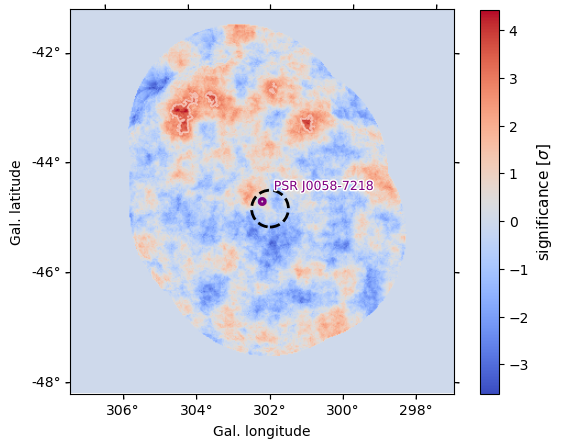

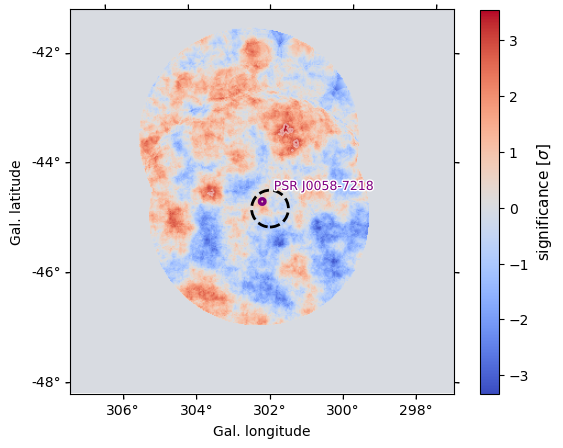

/tmp/ipykernel_573169/103278539.py:223: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat([df, new_df], ignore_index=True)
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 18599
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 18875
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 18890
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 19554
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 23062
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 23080
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 23612
Skipping run with mis

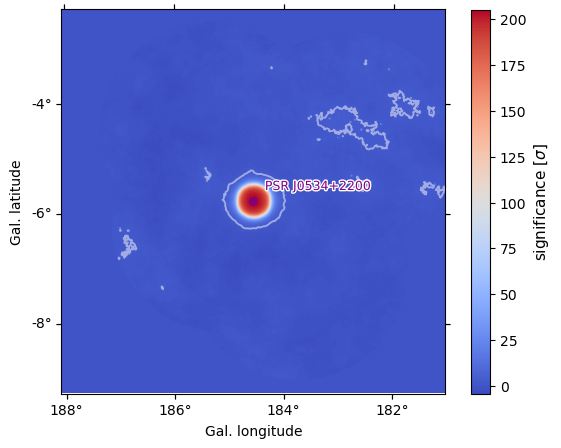

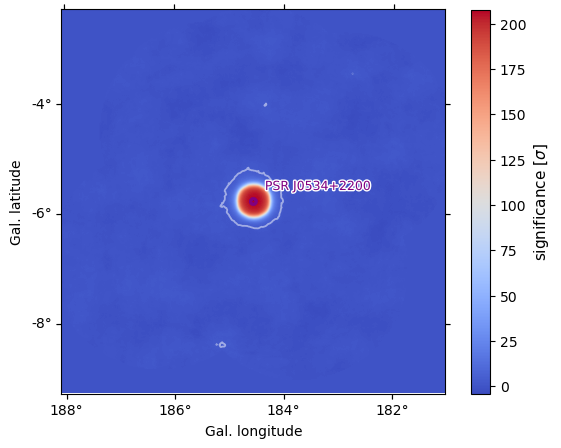

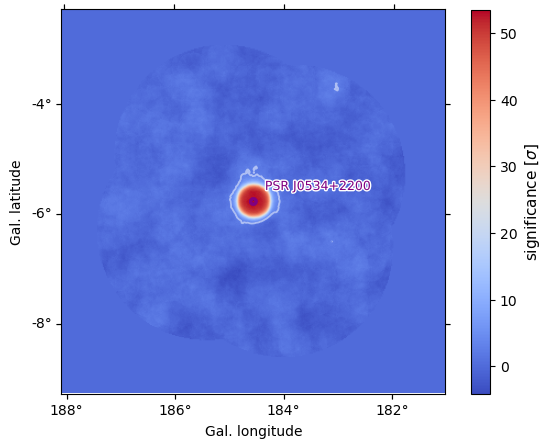

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

W VariableMetricBuilder No improvement in line search
W VariableMetricBuilder Machine accuracy limits further improvement
W VariableMetricBuilder Reached machine accuracy limit; Edm 0.000368163 is smaller than machine limit 0.0838206 while 0.0002 was requested


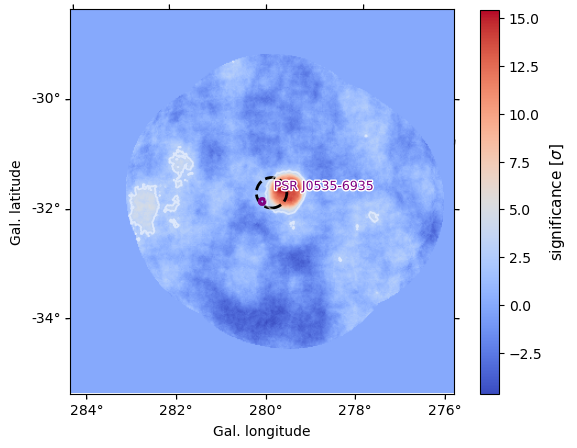

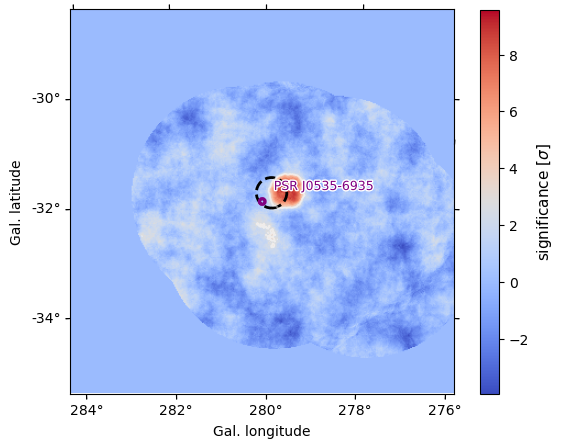

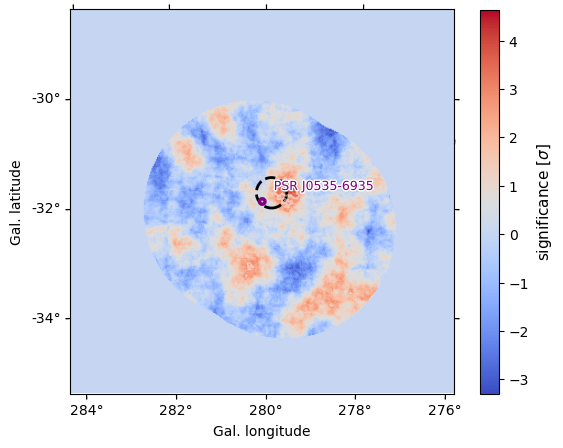

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

W VariableMetricBuilder Reached machine accuracy limit; Edm 0.000300398 is smaller than machine limit 0.0879915 while 0.0002 was requested


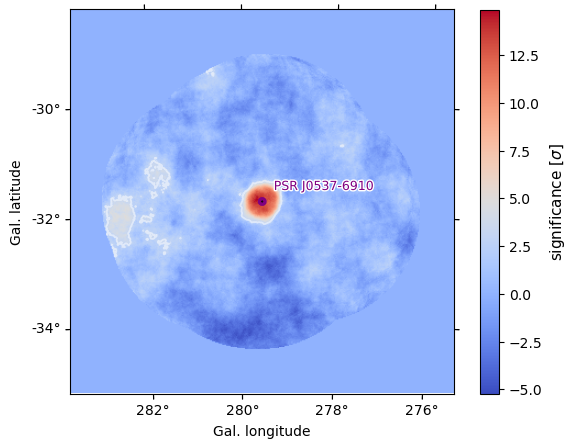

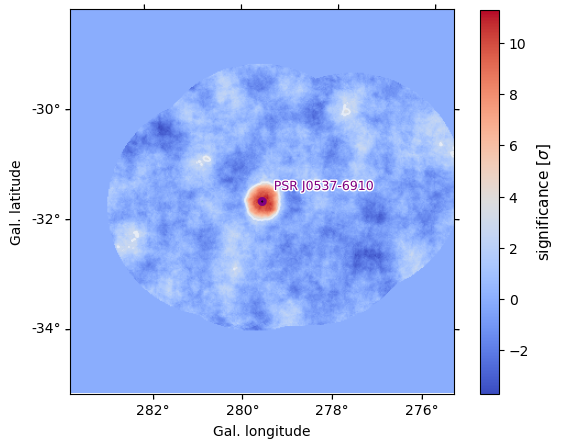

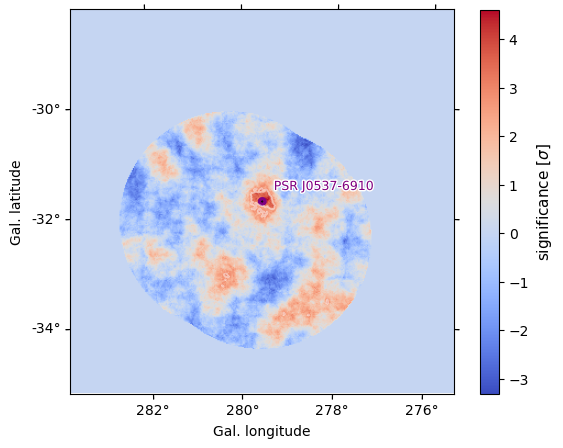

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'


W VariableMetricBuilder Reached machine accuracy limit; Edm 0.000220284 is smaller than machine limit 0.00556463 while 0.0002 was requested


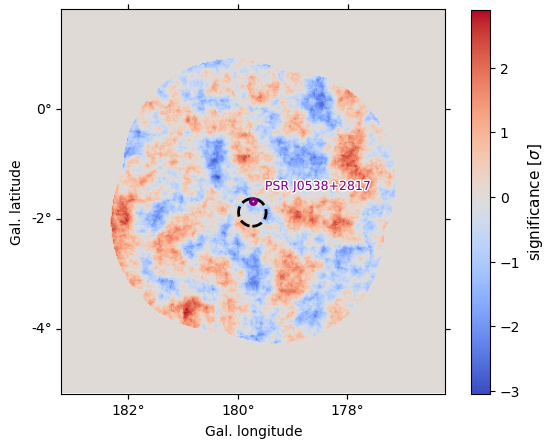

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

W VariableMetricBuilder Reached machine accuracy limit; Edm 0.000763667 is smaller than machine limit 0.0831351 while 0.0002 was requested


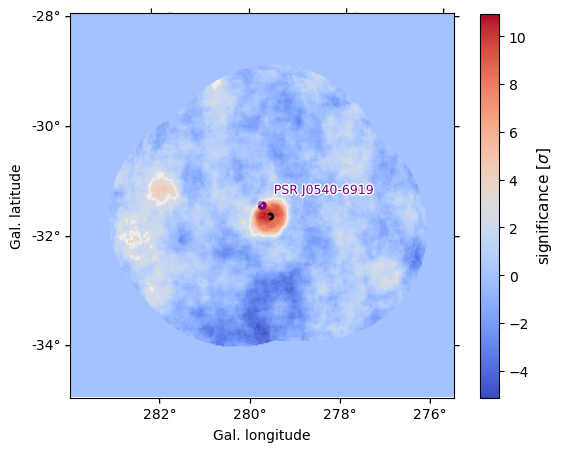

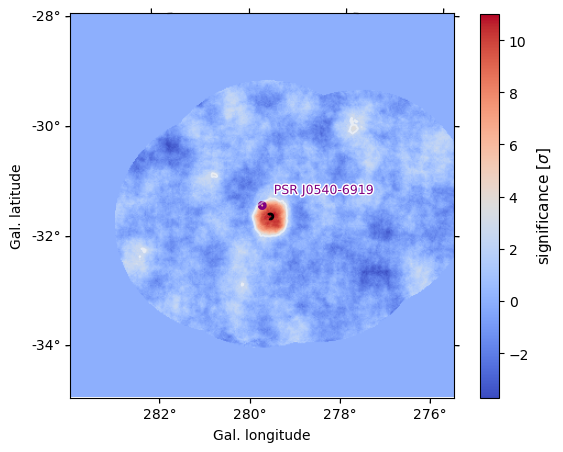

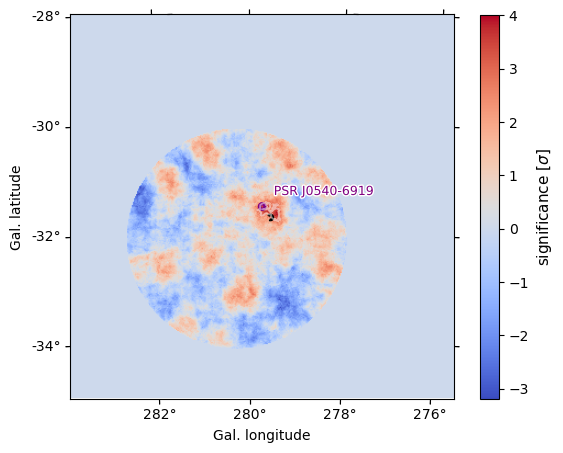

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

W DavidonErrorUpdator delgam < 0 : first derivatives increasing along search line
W VariableMetricBuilder Reached machine accuracy limit; Edm 0.000770842 is smaller than machine limit 0.0463062 while 0.0002 was requested


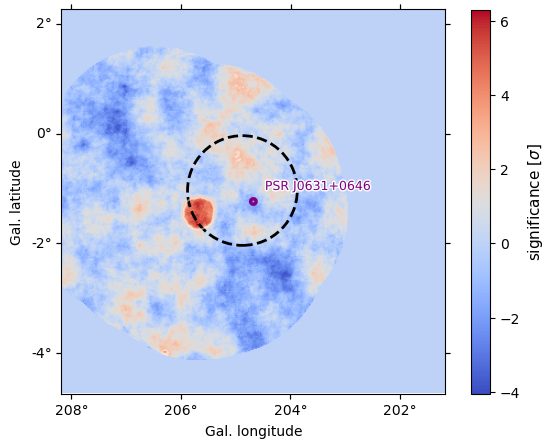

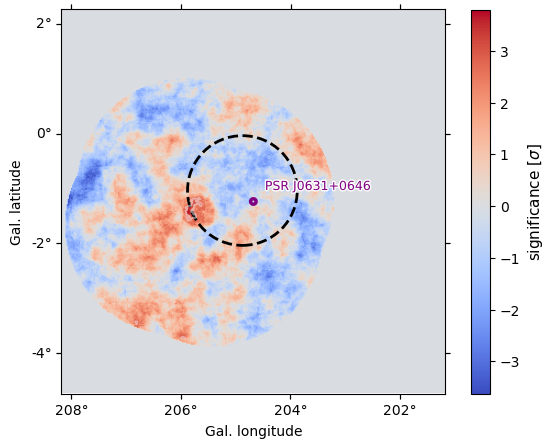

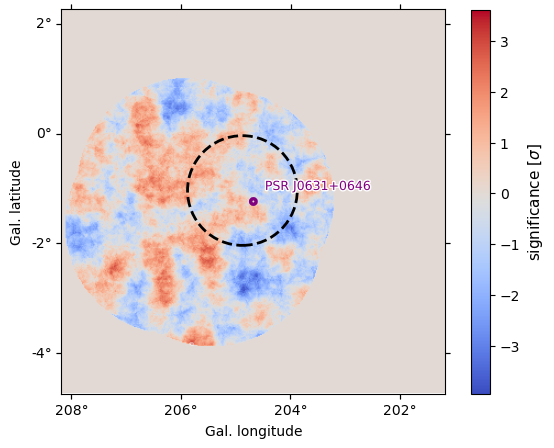

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'


W MnPosDef non-positive diagonal element in covariance matrix[ 0 ] = -2.1304e-08
W MnPosDef non-positive diagonal element in covariance matrix[ 4 ] = -5.2352e-07
W MnPosDef Added to diagonal of Error matrix a value 0.500002


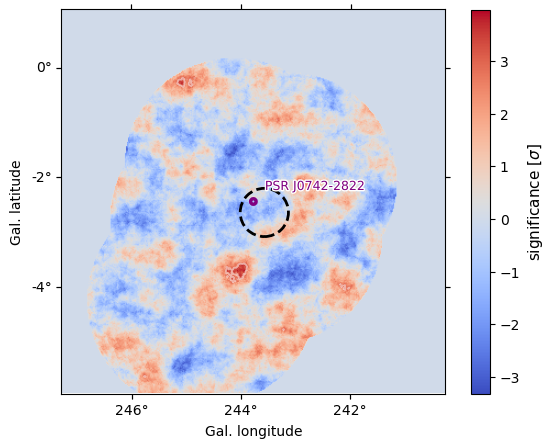

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'


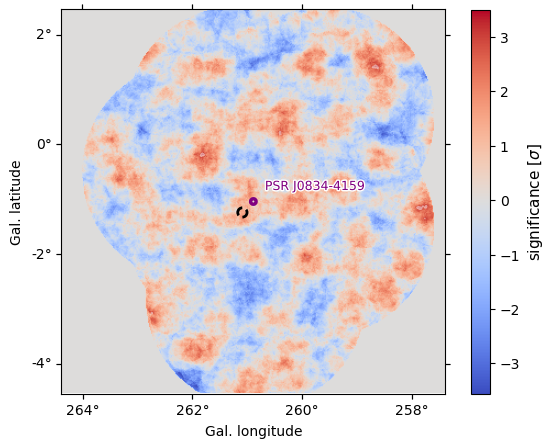

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

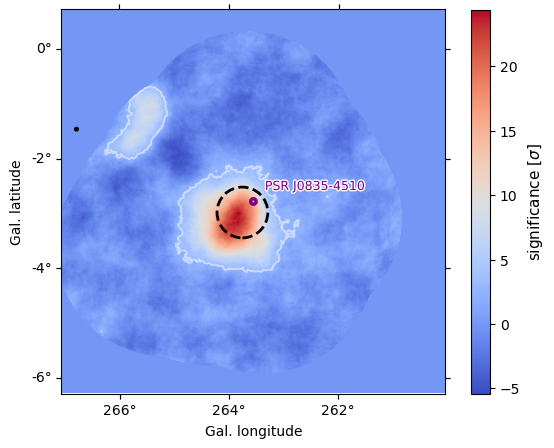

Position <SkyCoord (Galactic): (l, b) in deg
    (266.77690377, -1.46547152)> is outside valid IRF map range, using nearest IRF defined within
Position <SkyCoord (Galactic): (l, b) in deg
    (266.77690377, -1.46547152)> is outside valid IRF map range, using nearest IRF defined within
Model {m.name} is outside the target geom but contributes inside through the psf.This contribution cannot be estimated precisely.Consider extending the dataset geom and/or the masked margin in the mask_fit.


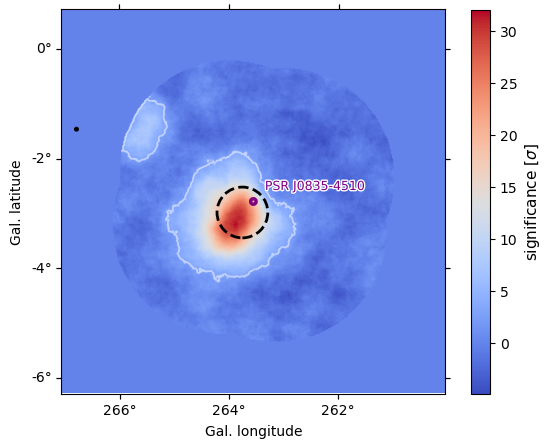

Position <SkyCoord (Galactic): (l, b) in deg
    (266.77690377, -1.46547152)> is outside valid IRF map range, using nearest IRF defined within
Position <SkyCoord (Galactic): (l, b) in deg
    (266.77690377, -1.46547152)> is outside valid IRF map range, using nearest IRF defined within
Model {m.name} is outside the target geom but contributes inside through the psf.This contribution cannot be estimated precisely.Consider extending the dataset geom and/or the masked margin in the mask_fit.


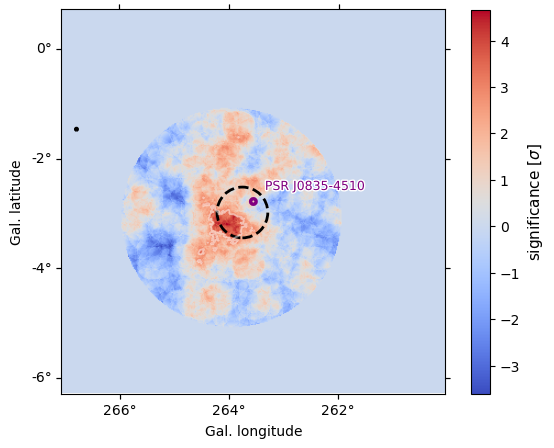

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

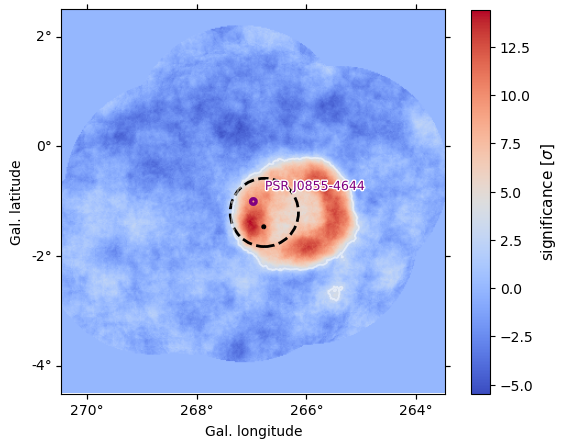

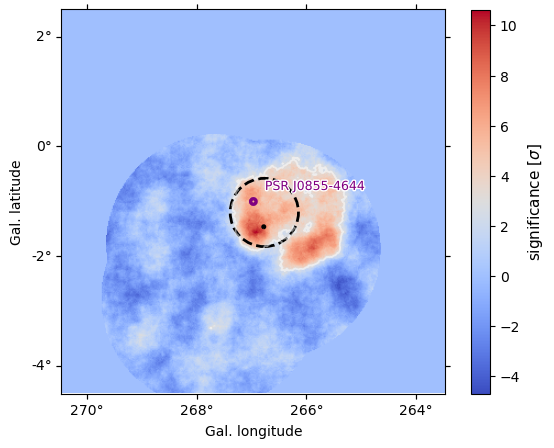

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

W VariableMetricBuilder Reached machine accuracy limit; Edm 0.000735044 is smaller than machine limit 0.0235885 while 0.0002 was requested


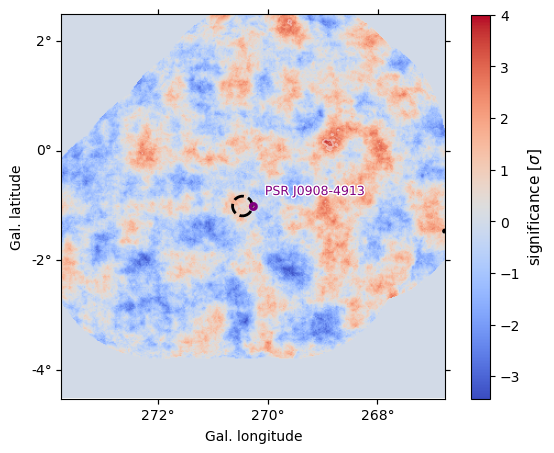

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

W VariableMetricBuilder Reached machine accuracy limit; Edm 0.000736787 is smaller than machine limit 0.0135503 while 0.0002 was requested


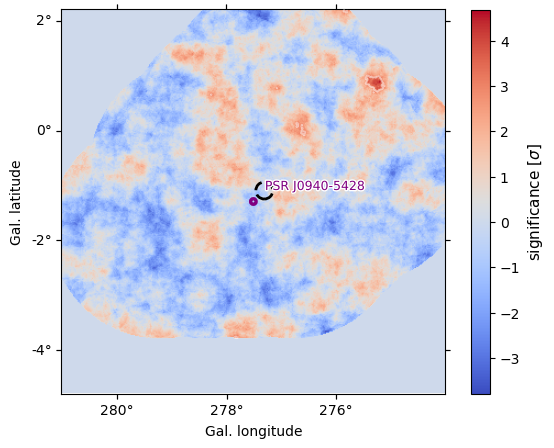

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

W VariableMetricBuilder Reached machine accuracy limit; Edm 0.000239168 is smaller than machine limit 0.0309931 while 0.0002 was requested


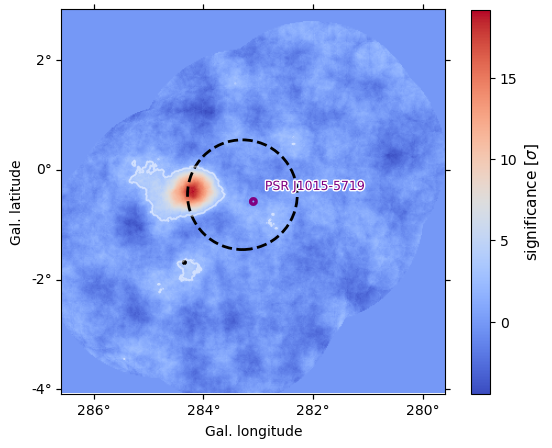

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

W DavidonErrorUpdator delgam < 0 : first derivatives increasing along search line
W VariableMetricBuilder Matrix not pos.def, gdel = 0.0289536 > 0
W MnPosDef non-positive diagonal element in covariance matrix[ 0 ] = -0.46218
W MnPosDef non-positive diagonal element in covariance matrix[ 1 ] = -0.765783
W MnPosDef non-positive diagonal element in covariance matrix[ 2 ] = -0.0737219
W MnPosDef Added to diagonal of Error matrix a value 1.26578
W MnPosDef Matrix forced pos-def by adding to diagonal 0.0913284
W VariableMetricBuilder gdel = -0.0228802
W VariableMetricBuilder No improvement in line search
W VariableMetricBuilder Iterations finish without convergence; Edm 0.0734975 Requested 0.0002


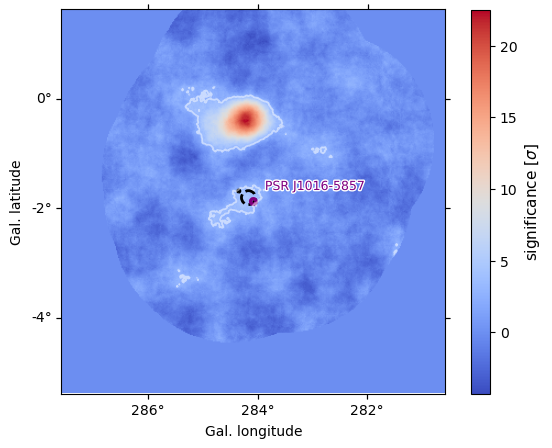

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

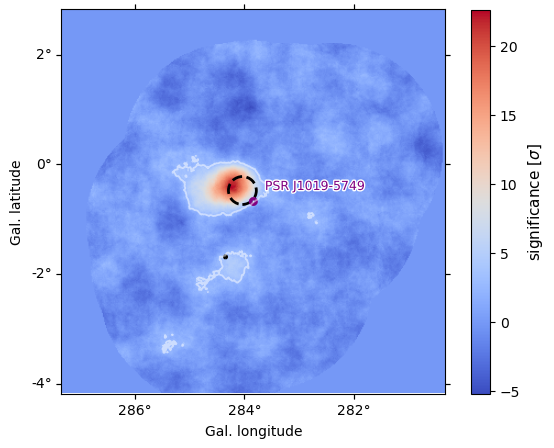

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

W VariableMetricBuilder No improvement in line search
W VariableMetricBuilder Machine accuracy limits further improvement
W VariableMetricBuilder Reached machine accuracy limit; Edm 0.0010521 is smaller than machine limit 0.0251415 while 0.0002 was requested


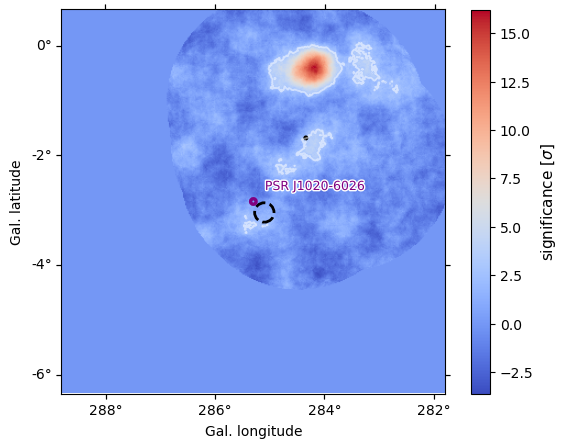

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

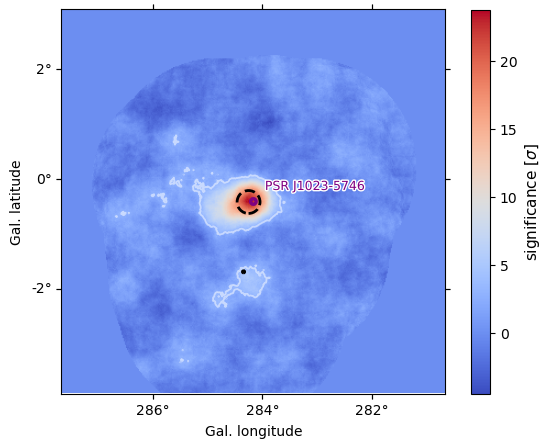

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

W VariableMetricBuilder Reached machine accuracy limit; Edm 0.000207686 is smaller than machine limit 0.0271547 while 0.0002 was requested


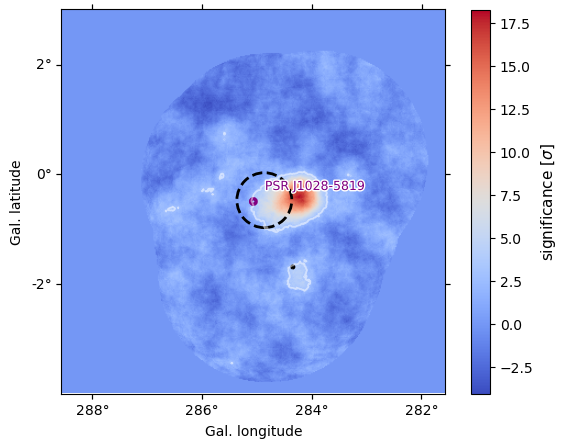

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

W MnPosDef non-positive diagonal element in covariance matrix[ 0 ] = -0.00028154
W MnPosDef non-positive diagonal element in covariance matrix[ 3 ] = -1.15987e-05
W MnPosDef non-positive diagonal element in covariance matrix[ 4 ] = -2.31797e-05
W MnPosDef Added to diagonal of Error matrix a value 0.500283
W MnPosDef Matrix forced pos-def by adding to diagonal 0.279921
W VariableMetricBuilder Reached machine accuracy limit; Edm 0.00336391 is smaller than machine limit 0.0329356 while 0.0002 was requested
W VariableMetricBuilder No convergence; Edm 0.00336391 is above tolerance 0.002
W DavidonErrorUpdator delgam < 0 : first derivatives increasing along search line
W DavidonErrorUpdator delgam < 0 : first derivatives increasing along search line


Position <SkyCoord (Galactic): (l, b) in deg
    (284.34470696, -1.68922887)> is outside valid IRF map range, using nearest IRF defined within
Position <SkyCoord (Galactic): (l, b) in deg
    (284.34470696, -1.68922887)> is outside valid IRF map range, using nearest IRF defined within


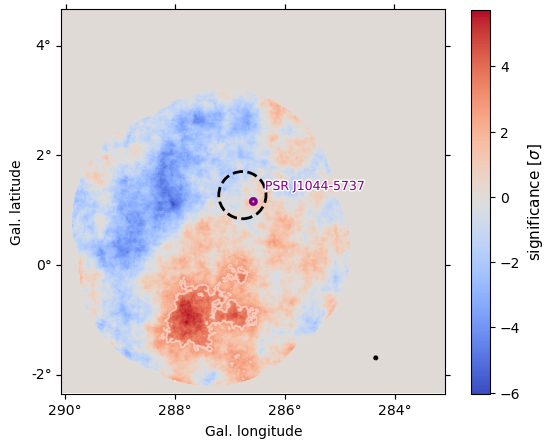

Position <SkyCoord (Galactic): (l, b) in deg
    (284.34470696, -1.68922887)> is outside valid IRF map range, using nearest IRF defined within
Position <SkyCoord (Galactic): (l, b) in deg
    (284.34470696, -1.68922887)> is outside valid IRF map range, using nearest IRF defined within


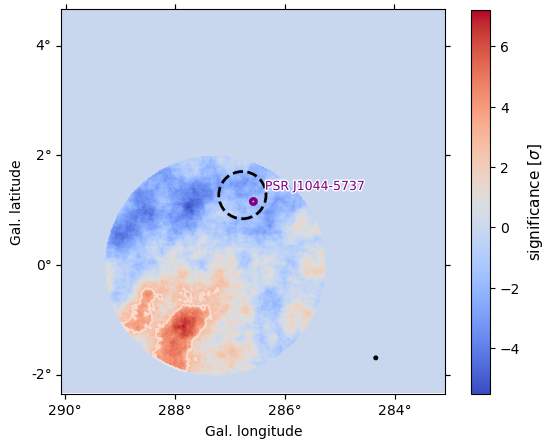

Position <SkyCoord (Galactic): (l, b) in deg
    (284.34470696, -1.68922887)> is outside valid IRF map range, using nearest IRF defined within
Position <SkyCoord (Galactic): (l, b) in deg
    (284.34470696, -1.68922887)> is outside valid IRF map range, using nearest IRF defined within
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'


W VariableMetricBuilder No improvement in line search
W VariableMetricBuilder Machine accuracy limits further improvement
W MnPosDef Matrix forced pos-def by adding to diagonal 0.0445874
W VariableMetricBuilder No improvement in line search
W VariableMetricBuilder Iterations finish without convergence; Edm 0.884711 Requested 0.0002
W VariableMetricBuilder FunctionMinimum is invalid after second try
W VariableMetricBuilder No improvement in line search
W VariableMetricBuilder Iterations finish without convergence; Edm 0.128695 Requested 0.0002
W VariableMetricBuilder No convergence; Edm 0.128695 is above tolerance 0.002
W VariableMetricBuilder No improvement in line search
W VariableMetricBuilder Iterations finish without convergence; Edm 0.128695 Requested 0.0002
W VariableMetricBuilder No convergence; Edm 0.128695 is above tolerance 0.002
W VariableMetricBuilder No improvement in line search
W VariableMetricBuilder Iterations finish without convergence; Edm 0.128695 Requested 0.0002
W

Position <SkyCoord (Galactic): (l, b) in deg
    (284.34470696, -1.68922887)> is outside valid IRF map range, using nearest IRF defined within
Position <SkyCoord (Galactic): (l, b) in deg
    (284.34470696, -1.68922887)> is outside valid IRF map range, using nearest IRF defined within


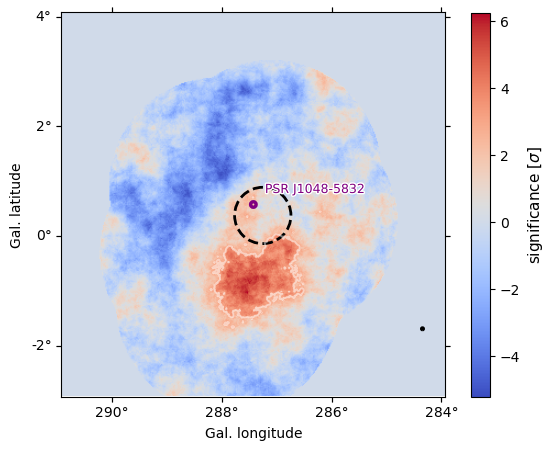

Position <SkyCoord (Galactic): (l, b) in deg
    (284.34470696, -1.68922887)> is outside valid IRF map range, using nearest IRF defined within
Position <SkyCoord (Galactic): (l, b) in deg
    (284.34470696, -1.68922887)> is outside valid IRF map range, using nearest IRF defined within


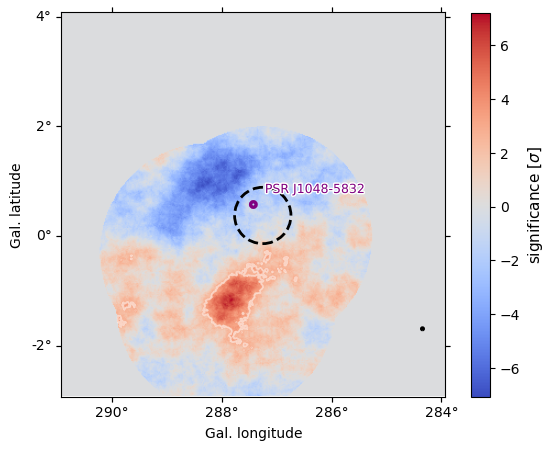

Position <SkyCoord (Galactic): (l, b) in deg
    (284.34470696, -1.68922887)> is outside valid IRF map range, using nearest IRF defined within
Position <SkyCoord (Galactic): (l, b) in deg
    (284.34470696, -1.68922887)> is outside valid IRF map range, using nearest IRF defined within


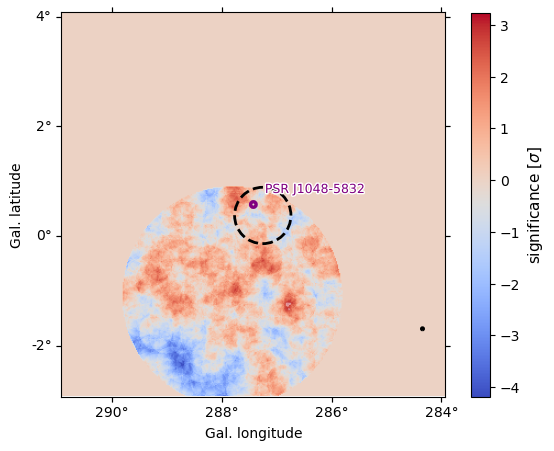

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

W VariableMetricBuilder Reached machine accuracy limit; Edm 0.00101629 is smaller than machine limit 0.0537966 while 0.0002 was requested


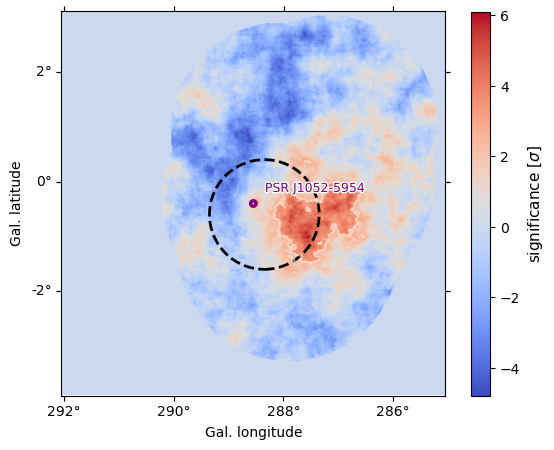

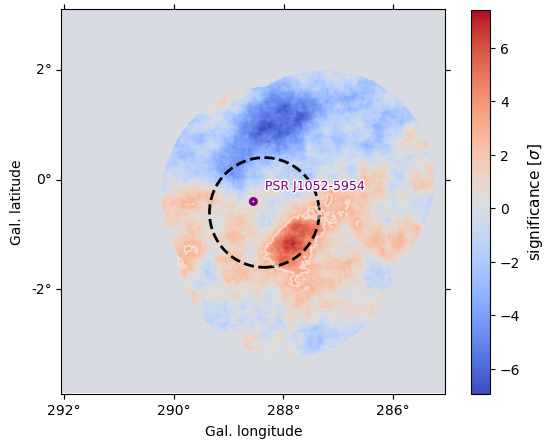

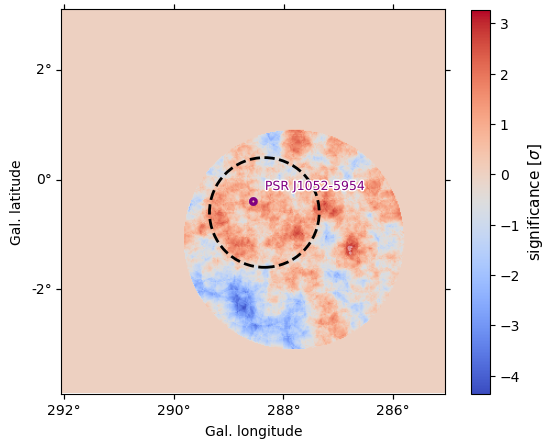

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

W VariableMetricBuilder No improvement in line search
W VariableMetricBuilder Machine accuracy limits further improvement
W MnPosDef Matrix forced pos-def by adding to diagonal 0.210944
W VariableMetricBuilder Reached machine accuracy limit; Edm 0.0084201 is smaller than machine limit 0.0311803 while 0.0002 was requested
W VariableMetricBuilder No convergence; Edm 0.0084201 is above tolerance 0.002
W MnPosDef Matrix forced pos-def by adding to diagonal 0.209716
W VariableMetricBuilder Reached machine accuracy limit; Edm 0.00333153 is smaller than machine limit 0.0311803 while 0.0002 was requested
W VariableMetricBuilder No convergence; Edm 0.00333153 is above tolerance 0.002
W VariableMetricBuilder No improvement in line search


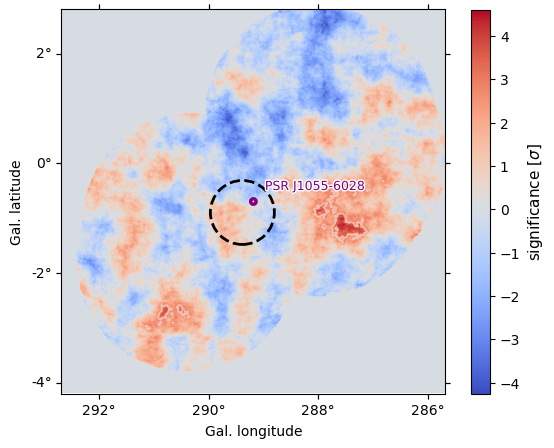

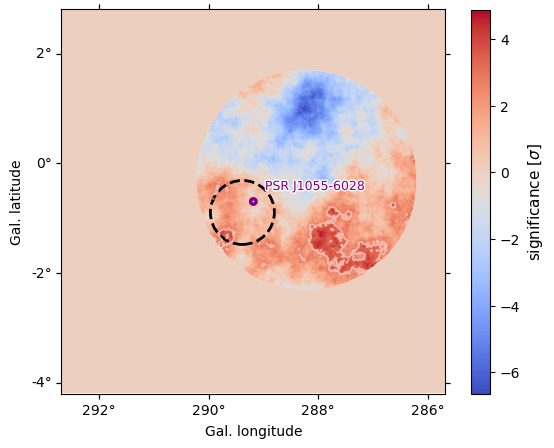

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

W DavidonErrorUpdator delgam < 0 : first derivatives increasing along search line
W VariableMetricBuilder Matrix not pos.def, gdel = 0.0015284 > 0
W MnPosDef non-positive diagonal element in covariance matrix[ 4 ] = -0.103956
W MnPosDef Added to diagonal of Error matrix a value 0.603957
W VariableMetricBuilder gdel = -0.0100711
W VariableMetricBuilder No improvement in line search
W VariableMetricBuilder Machine accuracy limits further improvement
W MnPosDef non-positive diagonal element in covariance matrix[ 3 ] = -0.307061
W MnPosDef Added to diagonal of Error matrix a value 0.807062
W VariableMetricBuilder Reached machine accuracy limit; Edm 0.0044466 is smaller than machine limit 0.0373124 while 0.0002 was requested
W VariableMetricBuilder No convergence; Edm 0.0044466 is above tolerance 0.002
W VariableMetricBuilder Reached machine accuracy limit; Edm 0.00593264 is smaller than machine limit 0.0373124 while 0.0002 was requested
W VariableMetricBuilder No convergence; Edm 0.0059326

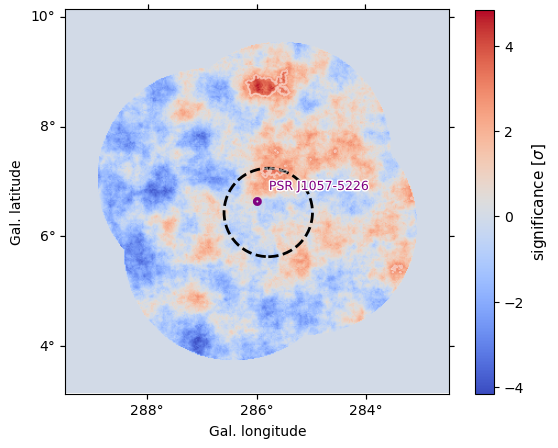

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Position <SkyCoord (Galactic): (l, b) in deg
    (293.89567135, 0.4568501)> is outside valid IRF map range, using nearest IRF defined within
Position <SkyCoord (Galactic): (l, b) in deg
    (293.89567135, 0.4568501)> is outside valid IRF map range, using nearest IRF defined within
Position <SkyCoord (Galactic): (l, b) in deg
    (293.91497865, 0.4568501)> is outside valid IRF map range, using nearest IRF defi

W VariableMetricBuilder No improvement in line search
W VariableMetricBuilder Iterations finish without convergence; Edm 2.95882 Requested 0.0002
W MnPosDef non-positive diagonal element in covariance matrix[ 2 ] = -0.132425
W MnPosDef Added to diagonal of Error matrix a value 0.632426
W VariableMetricBuilder No improvement in line search
W VariableMetricBuilder Machine accuracy limits further improvement
W MnPosDef Matrix forced pos-def by adding to diagonal 2.55366
W VariableMetricBuilder Reached machine accuracy limit; Edm 0.00466427 is smaller than machine limit 0.00800376 while 0.0002 was requested
W VariableMetricBuilder No convergence; Edm 0.00466427 is above tolerance 0.002
W DavidonErrorUpdator delgam < 0 : first derivatives increasing along search line
W DavidonErrorUpdator delgam < 0 : first derivatives increasing along search line
W VariableMetricBuilder Reached machine accuracy limit; Edm 0.00667937 is smaller than machine limit 0.00800376 while 0.0002 was requested
W Vari

Position <SkyCoord (Galactic): (l, b) in deg
    (293.6036081, 0.45685043)> is outside valid IRF map range, using nearest IRF defined within
Position <SkyCoord (Galactic): (l, b) in deg
    (293.6036081, 0.45685043)> is outside valid IRF map range, using nearest IRF defined within


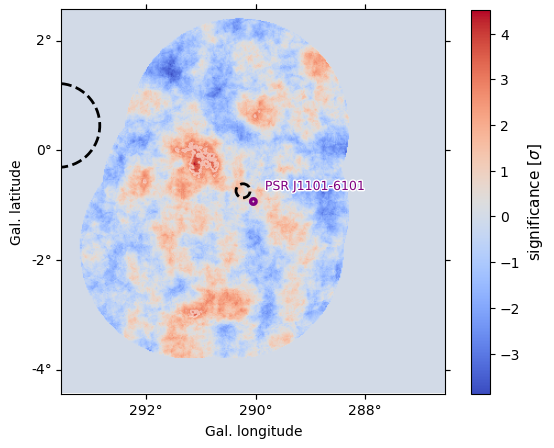

Position <SkyCoord (Galactic): (l, b) in deg
    (293.6036081, 0.45685043)> is outside valid IRF map range, using nearest IRF defined within
Position <SkyCoord (Galactic): (l, b) in deg
    (293.6036081, 0.45685043)> is outside valid IRF map range, using nearest IRF defined within
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Miss

W VariableMetricBuilder No improvement in line search
W VariableMetricBuilder Machine accuracy limits further improvement
W MnPosDef non-positive diagonal element in covariance matrix[ 3 ] = -0.0357809
W MnPosDef Added to diagonal of Error matrix a value 0.535782
W VariableMetricBuilder Reached machine accuracy limit; Edm 0.00204209 is smaller than machine limit 0.0108033 while 0.0002 was requested
W VariableMetricBuilder No convergence; Edm 0.00204209 is above tolerance 0.002
W VariableMetricBuilder Reached machine accuracy limit; Edm 0.00499599 is smaller than machine limit 0.0108033 while 0.0002 was requested
W VariableMetricBuilder No convergence; Edm 0.00499599 is above tolerance 0.002
W DavidonErrorUpdator delgam < 0 : first derivatives increasing along search line
W VariableMetricBuilder No improvement in line search
W VariableMetricBuilder Machine accuracy limits further improvement


Position <SkyCoord (Galactic): (l, b) in deg
    (293.60360795, 0.73206137)> is outside valid IRF map range, using nearest IRF defined within
Position <SkyCoord (Galactic): (l, b) in deg
    (293.60360795, 0.73206137)> is outside valid IRF map range, using nearest IRF defined within


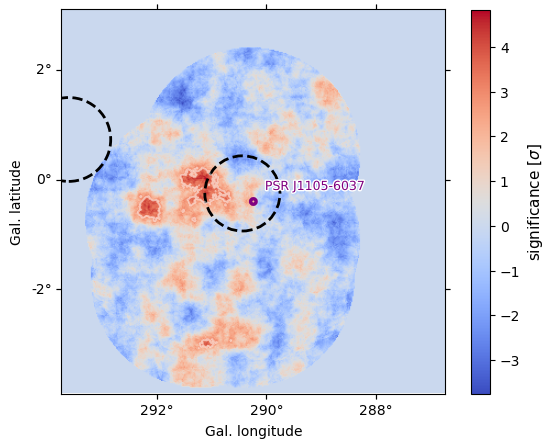

Position <SkyCoord (Galactic): (l, b) in deg
    (293.60360795, 0.73206137)> is outside valid IRF map range, using nearest IRF defined within
Position <SkyCoord (Galactic): (l, b) in deg
    (293.60360795, 0.73206137)> is outside valid IRF map range, using nearest IRF defined within
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Mi

W VariableMetricBuilder Reached machine accuracy limit; Edm 0.00175314 is smaller than machine limit 0.0107978 while 0.0002 was requested


Position <SkyCoord (Galactic): (l, b) in deg
    (293.60360787, 0.81334226)> is outside valid IRF map range, using nearest IRF defined within
Position <SkyCoord (Galactic): (l, b) in deg
    (293.60360787, 0.81334226)> is outside valid IRF map range, using nearest IRF defined within


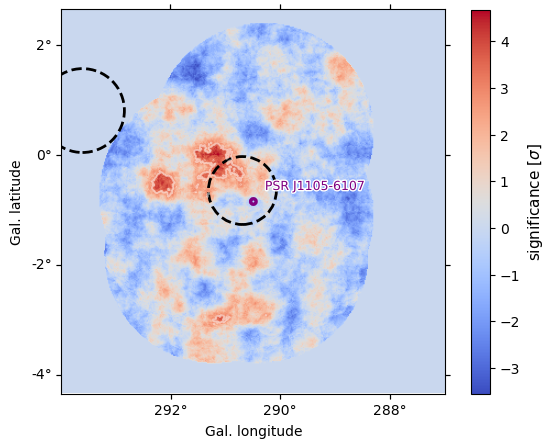

Position <SkyCoord (Galactic): (l, b) in deg
    (293.60360787, 0.81334226)> is outside valid IRF map range, using nearest IRF defined within
Position <SkyCoord (Galactic): (l, b) in deg
    (293.60360787, 0.81334226)> is outside valid IRF map range, using nearest IRF defined within
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Mi

W MnPosDef non-positive diagonal element in covariance matrix[ 2 ] = -0.00834784
W MnPosDef non-positive diagonal element in covariance matrix[ 4 ] = -0.14659
W MnPosDef non-positive diagonal element in covariance matrix[ 5 ] = -0.217407
W MnPosDef Added to diagonal of Error matrix a value 0.717408
W DavidonErrorUpdator delgam < 0 : first derivatives increasing along search line
W VariableMetricBuilder No improvement in line search
W VariableMetricBuilder Machine accuracy limits further improvement
W VariableMetricBuilder Reached machine accuracy limit; Edm 0.00887813 is smaller than machine limit 0.0151345 while 0.0002 was requested
W VariableMetricBuilder No convergence; Edm 0.00887813 is above tolerance 0.002
W DavidonErrorUpdator delgam < 0 : first derivatives increasing along search line
W VariableMetricBuilder No improvement in line search
W VariableMetricBuilder Machine accuracy limits further improvement
W VariableMetricBuilder Reached machine accuracy limit; Edm 0.0102053 is s

Position <SkyCoord (Galactic): (l, b) in deg
    (293.60361299, 0.81668275)> is outside valid IRF map range, using nearest IRF defined within
Position <SkyCoord (Galactic): (l, b) in deg
    (293.60361299, 0.81668275)> is outside valid IRF map range, using nearest IRF defined within


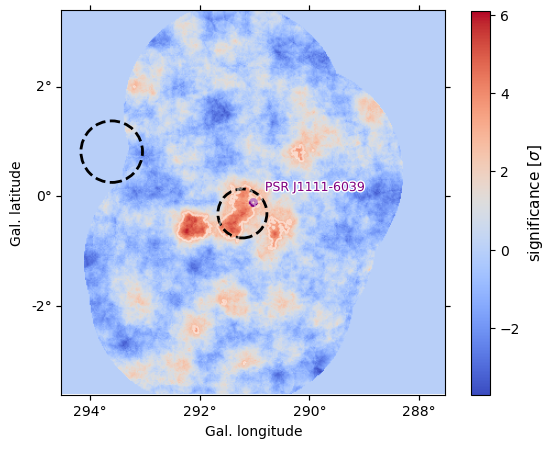

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

W VariableMetricBuilder Reached machine accuracy limit; Edm 0.00143735 is smaller than machine limit 0.0151165 while 0.0002 was requested


Position <SkyCoord (Galactic): (l, b) in deg
    (293.60360787, 0.81668447)> is outside valid IRF map range, using nearest IRF defined within
Position <SkyCoord (Galactic): (l, b) in deg
    (293.60360787, 0.81668447)> is outside valid IRF map range, using nearest IRF defined within


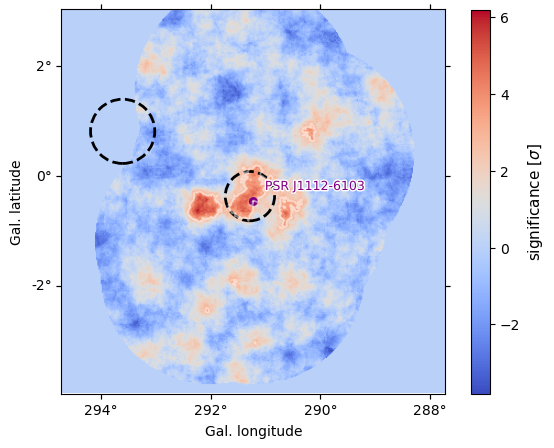

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

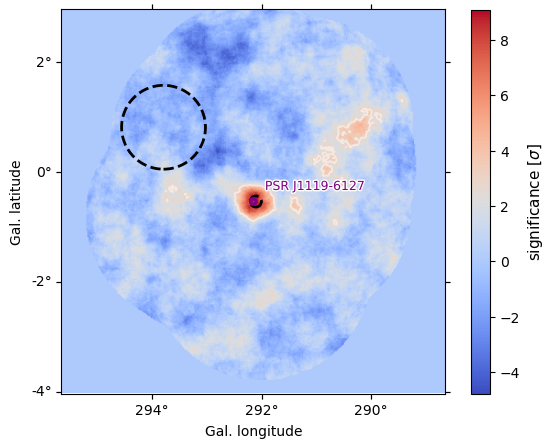

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

W VariableMetricBuilder Reached machine accuracy limit; Edm 0.0069341 is smaller than machine limit 0.0179899 while 0.0002 was requested
W VariableMetricBuilder No convergence; Edm 0.0069341 is above tolerance 0.002


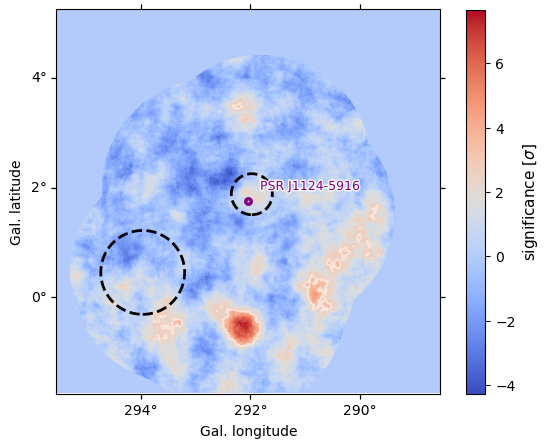

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'


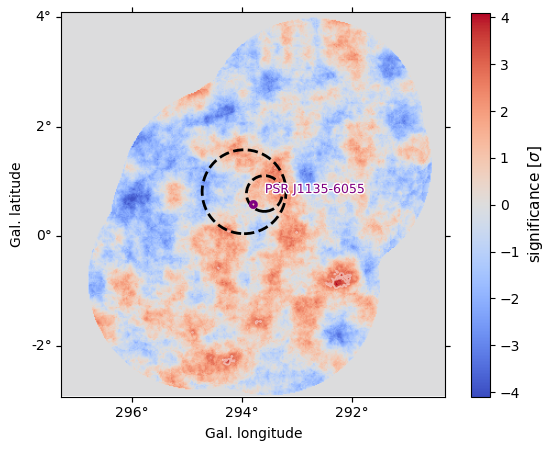

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

W DavidonErrorUpdator delgam < 0 : first derivatives increasing along search line
W VariableMetricBuilder Matrix not pos.def, gdel = 0.0245718 > 0
W MnPosDef non-positive diagonal element in covariance matrix[ 4 ] = -0.037358
W MnPosDef Added to diagonal of Error matrix a value 0.537359
W VariableMetricBuilder gdel = -8.93905
W VariableMetricBuilder No improvement in line search
W VariableMetricBuilder Machine accuracy limits further improvement
W MnPosDef Matrix forced pos-def by adding to diagonal 22.7102
W VariableMetricBuilder No improvement in line search
W VariableMetricBuilder Iterations finish without convergence; Edm 1.34413e+06 Requested 0.0002
W VariableMetricBuilder FunctionMinimum is invalid after second try
W VariableMetricBuilder No improvement in line search
W VariableMetricBuilder Machine accuracy limits further improvement
W VariableMetricBuilder No convergence; Edm 0.00312126 is above tolerance 0.002
W VariableMetricBuilder No improvement in line search
W VariableMet

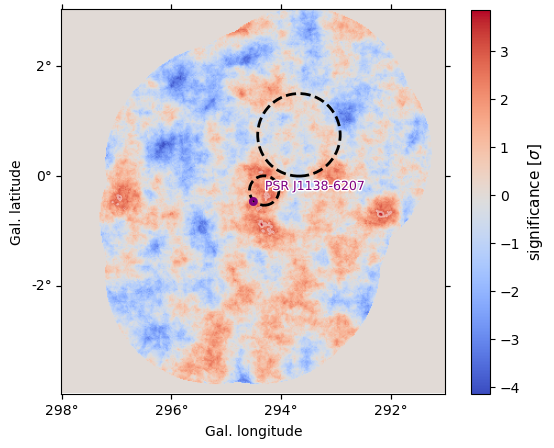

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'


W VariableMetricBuilder No improvement in line search
W VariableMetricBuilder Machine accuracy limits further improvement
W VariableMetricBuilder Reached machine accuracy limit; Edm 0.00190018 is smaller than machine limit 0.0142119 while 0.0002 was requested


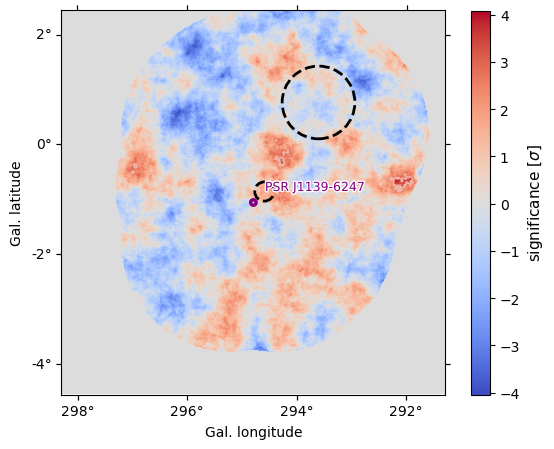

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'


W MnPosDef non-positive diagonal element in covariance matrix[ 2 ] = -0.600669
W MnPosDef non-positive diagonal element in covariance matrix[ 10 ] = -0.000142912
W MnPosDef Added to diagonal of Error matrix a value 1.10067
W VariableMetricBuilder Reached machine accuracy limit; Edm 0.00455539 is smaller than machine limit 0.00980257 while 0.0002 was requested
W VariableMetricBuilder No convergence; Edm 0.00455539 is above tolerance 0.002
W DavidonErrorUpdator delgam < 0 : first derivatives increasing along search line
W VariableMetricBuilder Matrix not pos.def, gdel = 3.52253 > 0
W MnPosDef non-positive diagonal element in covariance matrix[ 1 ] = -0.0121901
W MnPosDef non-positive diagonal element in covariance matrix[ 4 ] = -0.0877027
W MnPosDef non-positive diagonal element in covariance matrix[ 6 ] = -2.87158
W MnPosDef non-positive diagonal element in covariance matrix[ 7 ] = -0.00255995
W MnPosDef non-positive diagonal element in covariance matrix[ 9 ] = -0.0123085
W MnPosDef Add

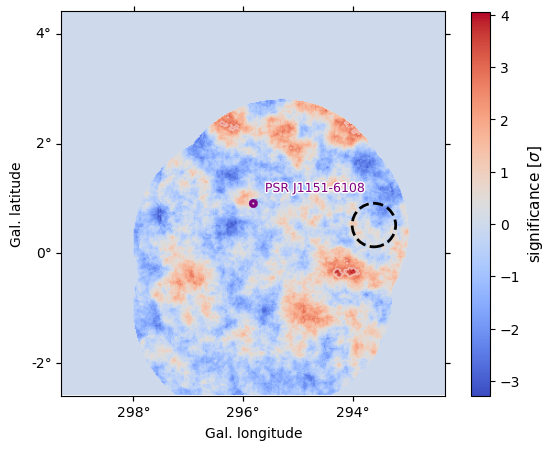

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Position <SkyCoord (Galactic): (l, b) in deg
    (293.61658523, 0.51467318)> is outside valid IRF map range, using nearest IRF defined within
Position <SkyCoord (Galactic): (l, b) in deg
    (293.61658523, 0.51467318)> is outside valid IRF map range, using nearest IRF defined within


W VariableMetricBuilder No improvement in line search
W VariableMetricBuilder Machine accuracy limits further improvement
W VariableMetricBuilder No convergence; Edm 0.00243361 is above tolerance 0.002
W VariableMetricBuilder No improvement in line search
W VariableMetricBuilder Iterations finish without convergence; Edm 0.0150687 Requested 0.0002
W MnHesse 2nd derivative zero for parameter par_000_amplitude ; MnHesse fails and will return diagonal matrix
W VariableMetricBuilder Invalid Hessian - exit the minimization
W VariableMetricBuilder No convergence; Edm 0.00376719 is above tolerance 0.002
W MnHesse 2nd derivative zero for parameter par_000_amplitude ; MnHesse fails and will return diagonal matrix
W VariableMetricBuilder Invalid Hessian - exit the minimization
W VariableMetricBuilder No improvement in line search
W VariableMetricBuilder Machine accuracy limits further improvement
W MnHesse 2nd derivative zero for parameter par_000_amplitude ; MnHesse fails and will return diagon

Position <SkyCoord (Galactic): (l, b) in deg
    (293.61658523, 0.51467318)> is outside valid IRF map range, using nearest IRF defined within


W MnHesse 2nd derivative zero for parameter par_000_amplitude ; MnHesse fails and will return diagonal matrix
W VariableMetricBuilder Invalid Hessian - exit the minimization


Position <SkyCoord (Galactic): (l, b) in deg
    (293.61658523, 0.51467318)> is outside valid IRF map range, using nearest IRF defined within


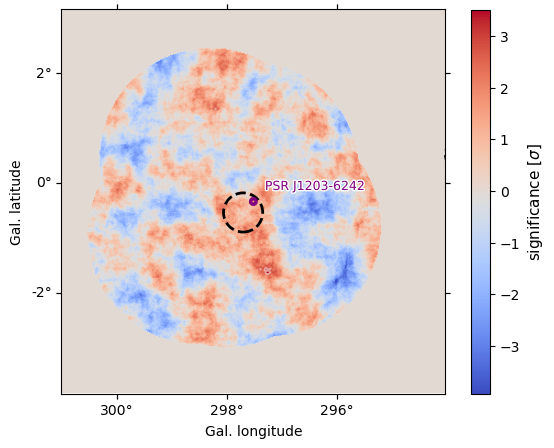

Position <SkyCoord (Galactic): (l, b) in deg
    (293.61658523, 0.51467318)> is outside valid IRF map range, using nearest IRF defined within
Position <SkyCoord (Galactic): (l, b) in deg
    (293.61658523, 0.51467318)> is outside valid IRF map range, using nearest IRF defined within
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'


W VariableMetricBuilder Reached machine accuracy limit; Edm 0.000236108 is smaller than machine limit 0.00981395 while 0.0002 was requested


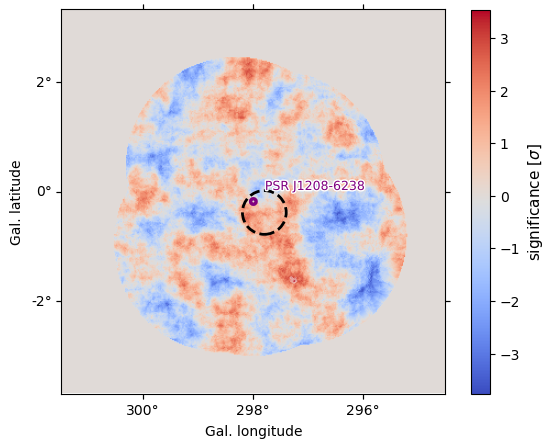

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'


W MnPosDef non-positive diagonal element in covariance matrix[ 0 ] = -0.0144892
W MnPosDef non-positive diagonal element in covariance matrix[ 3 ] = -9.89472e-06
W MnPosDef Added to diagonal of Error matrix a value 0.51449


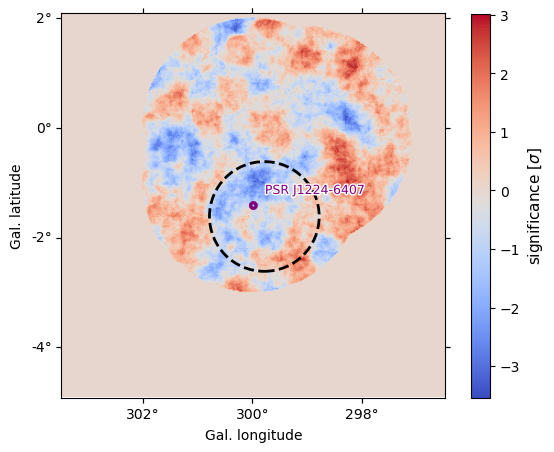

Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 40223
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 40223
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assum

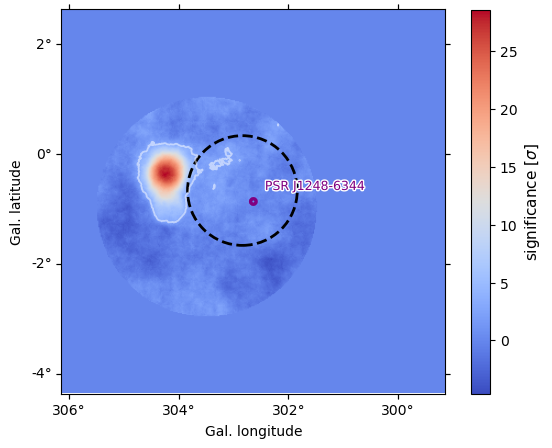

Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 40223
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 40439
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 40223
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 40439
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
FoVBackgroundMaker failed. Non-finite normalisation value for obs-19770. Setting mask to False.
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2'

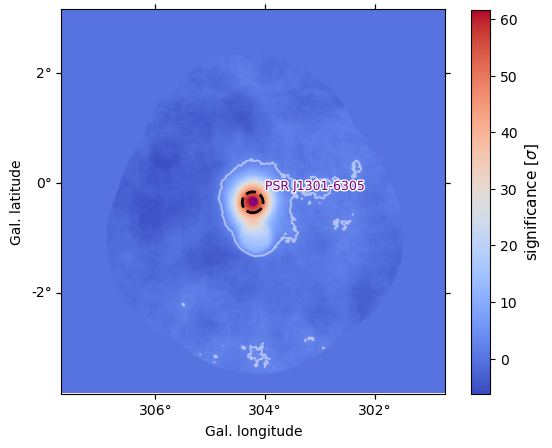

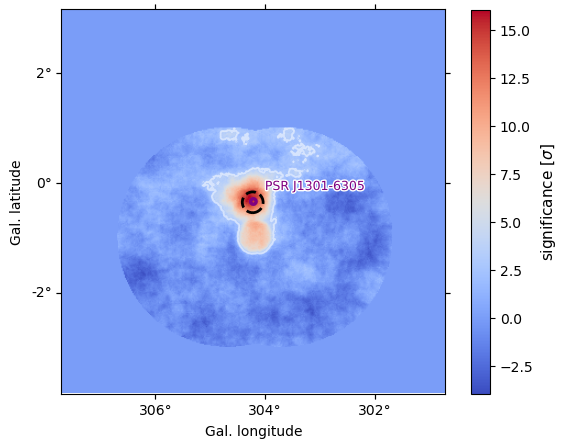

Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 40223
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 40439
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 40223
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 40439
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
FoVBackgroundMaker failed. Non-finite normalisation value for obs-19770. Setting mask to False.
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2'

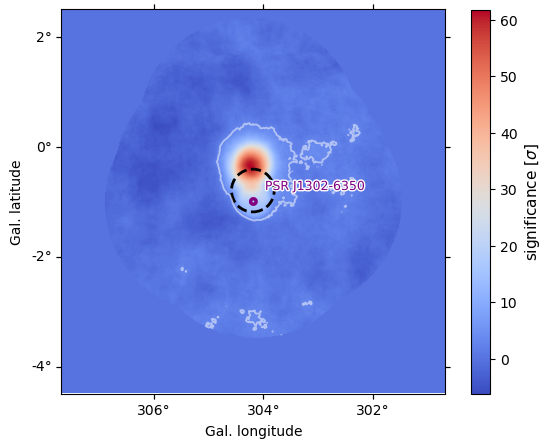

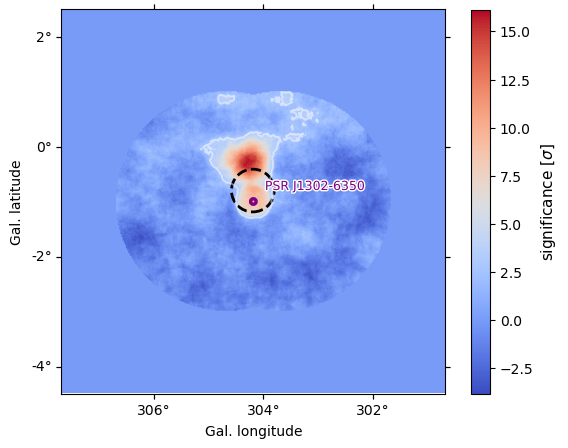

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

W VariableMetricBuilder No improvement in line search
W VariableMetricBuilder Machine accuracy limits further improvement
W VariableMetricBuilder Reached machine accuracy limit; Edm 0.00105055 is smaller than machine limit 0.0167458 while 0.0002 was requested


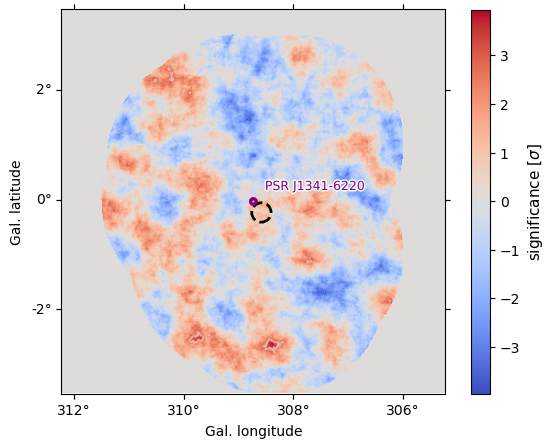

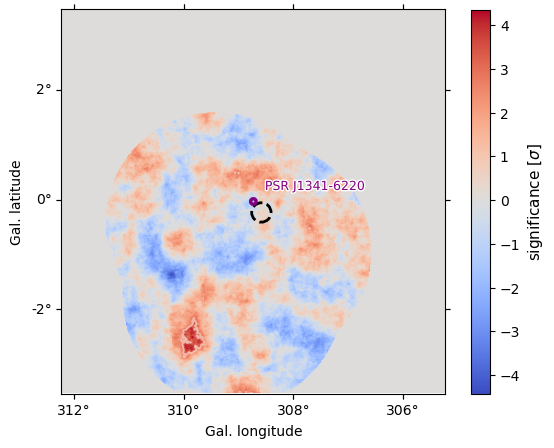

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

W MnPosDef Matrix forced pos-def by adding to diagonal 0.0475631
W VariableMetricBuilder Reached machine accuracy limit; Edm 0.0165526 is smaller than machine limit 0.0225672 while 0.0002 was requested
W VariableMetricBuilder No convergence; Edm 0.0165526 is above tolerance 0.002
W DavidonErrorUpdator delgam < 0 : first derivatives increasing along search line
W VariableMetricBuilder No improvement in line search
W VariableMetricBuilder Machine accuracy limits further improvement
W MnPosDef Matrix forced pos-def by adding to diagonal 0.0461788
W VariableMetricBuilder Reached machine accuracy limit; Edm 0.0165924 is smaller than machine limit 0.0225672 while 0.0002 was requested
W VariableMetricBuilder No convergence; Edm 0.0165924 is above tolerance 0.002
W DavidonErrorUpdator delgam < 0 : first derivatives increasing along search line
W VariableMetricBuilder No improvement in line search
W VariableMetricBuilder Machine accuracy limits further improvement
W MnPosDef Matrix forced pos-d

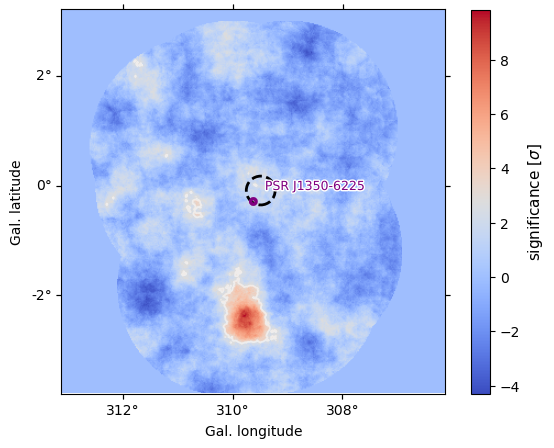

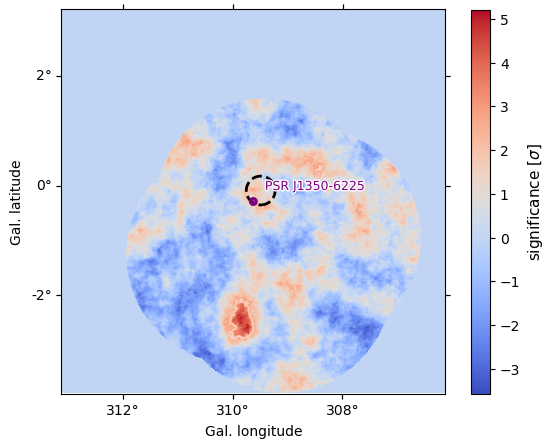

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
FoVBackgroundMaker failed. Non-finite normalisation value for obs-37800. Setting mask to False.
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' key

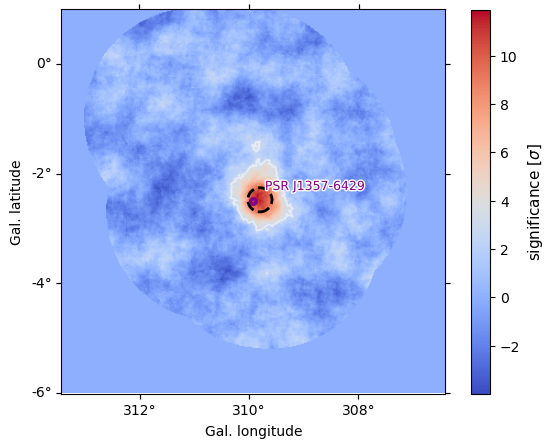

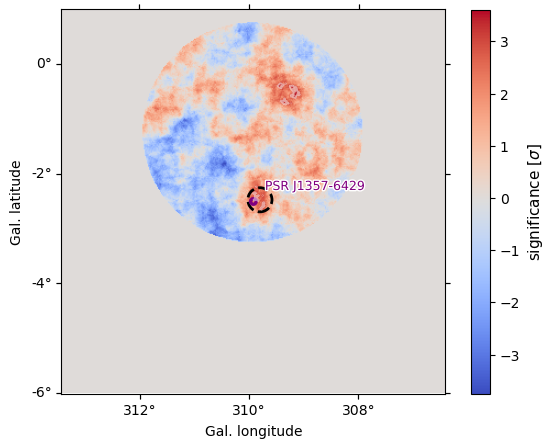

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'


W MnPosDef non-positive diagonal element in covariance matrix[ 3 ] = -1.5134e-08
W MnPosDef non-positive diagonal element in covariance matrix[ 4 ] = -5.03846e-07
W MnPosDef Added to diagonal of Error matrix a value 0.500002


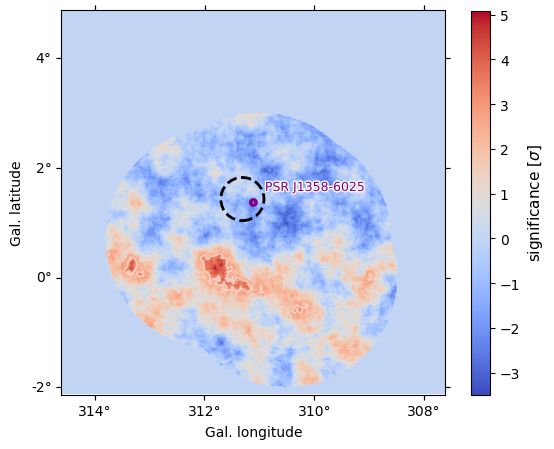

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'


W VariableMetricBuilder Reached machine accuracy limit; Edm 0.000572577 is smaller than machine limit 0.00768142 while 0.0002 was requested


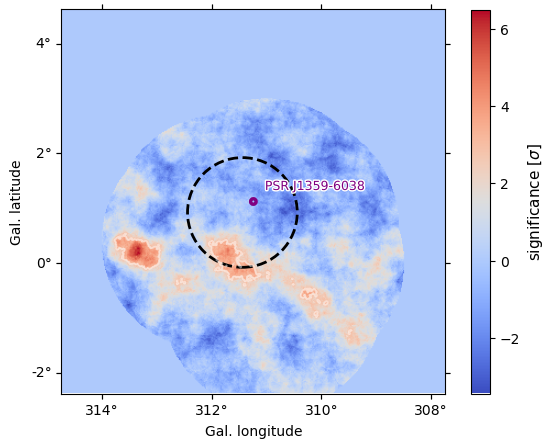

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
FoVBackgroundMaker failed. Non-finite normalisation value for obs-37800. Setting mask to False.
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' key

W VariableMetricBuilder Reached machine accuracy limit; Edm 0.000236929 is smaller than machine limit 0.0175284 while 0.0002 was requested


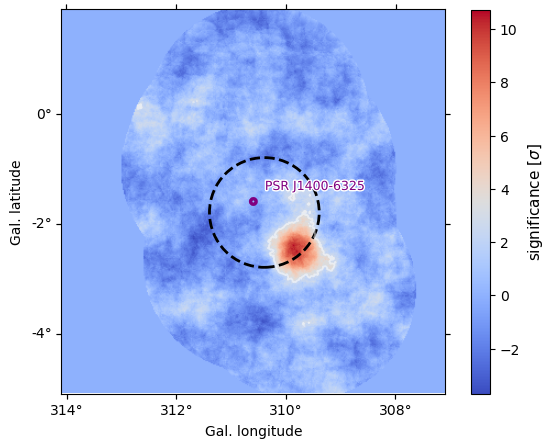

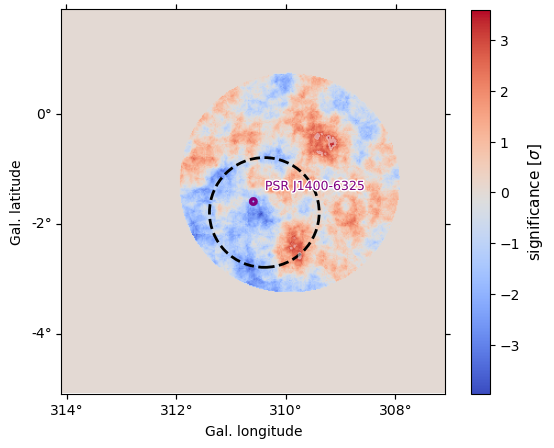

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'


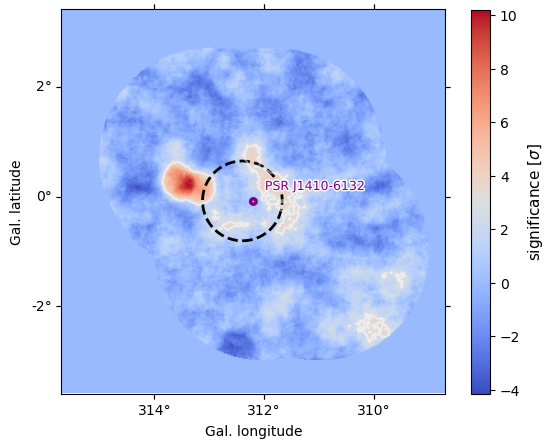

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

W DavidonErrorUpdator delgam < 0 : first derivatives increasing along search line
W VariableMetricBuilder Matrix not pos.def, gdel = 4.14517e-05 > 0
W MnPosDef non-positive diagonal element in covariance matrix[ 4 ] = -0.0101661
W MnPosDef Added to diagonal of Error matrix a value 0.510167
W VariableMetricBuilder gdel = -0.0182633
W VariableMetricBuilder No improvement in line search
W VariableMetricBuilder Machine accuracy limits further improvement
W VariableMetricBuilder Reached machine accuracy limit; Edm 0.000504386 is smaller than machine limit 0.0151657 while 0.0002 was requested


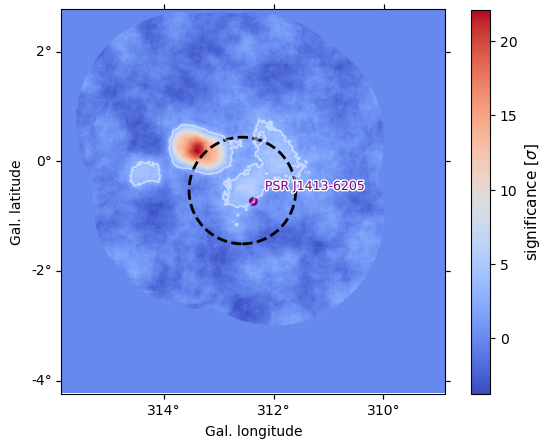

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

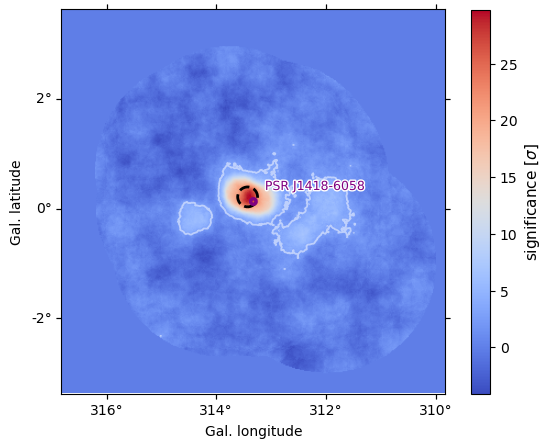

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

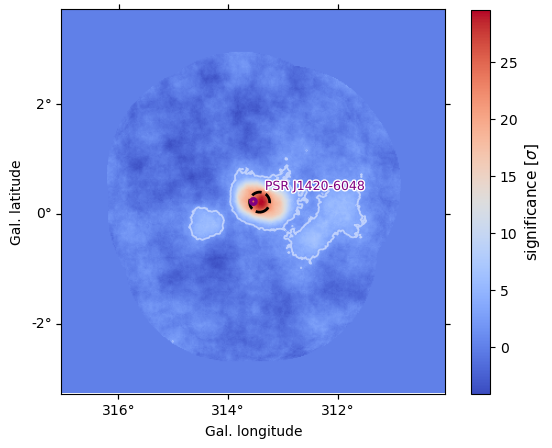

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'


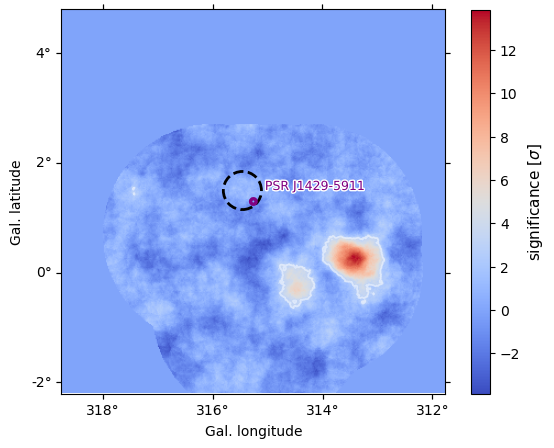

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

W VariableMetricBuilder Reached machine accuracy limit; Edm 0.00158914 is smaller than machine limit 0.0224423 while 0.0002 was requested


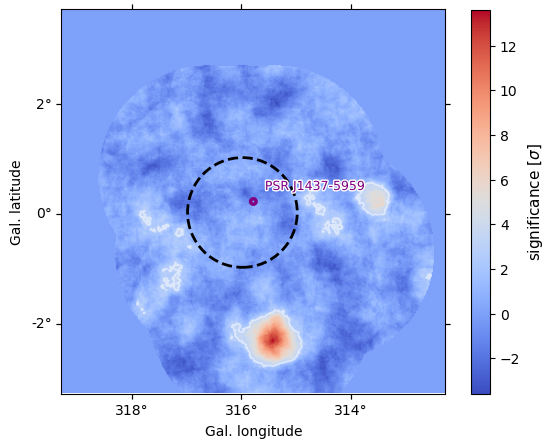

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'


W MnPosDef non-positive diagonal element in covariance matrix[ 0 ] = -9.82545e-08
W MnPosDef non-positive diagonal element in covariance matrix[ 4 ] = -8.91276e-07
W MnPosDef Added to diagonal of Error matrix a value 0.500002


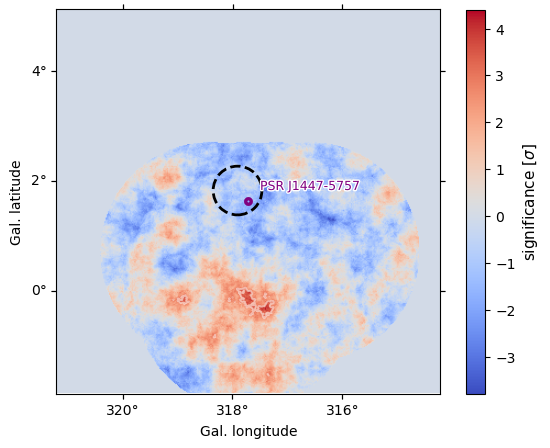

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

W VariableMetricBuilder No improvement in line search
W VariableMetricBuilder Machine accuracy limits further improvement
W VariableMetricBuilder Reached machine accuracy limit; Edm 0.00144879 is smaller than machine limit 0.0383179 while 0.0002 was requested


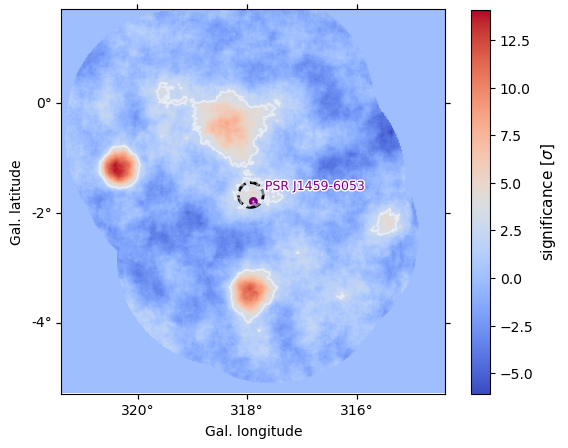

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

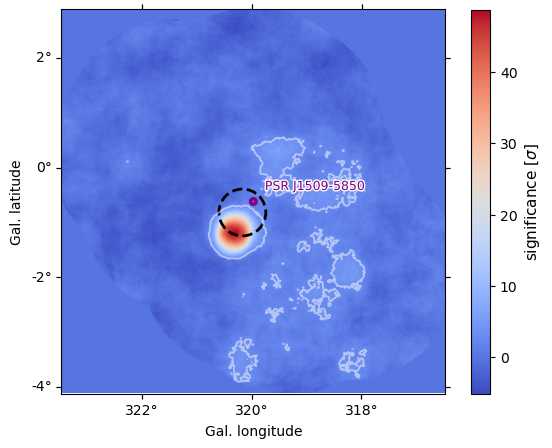

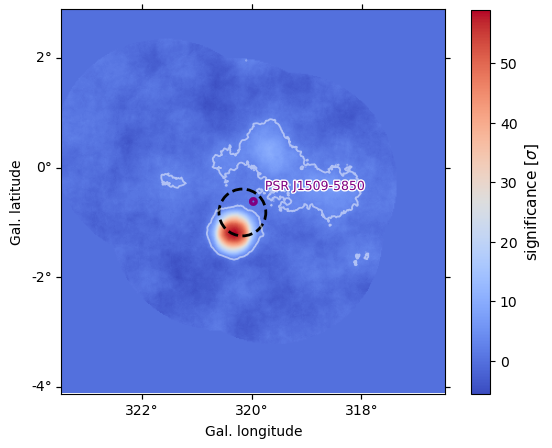

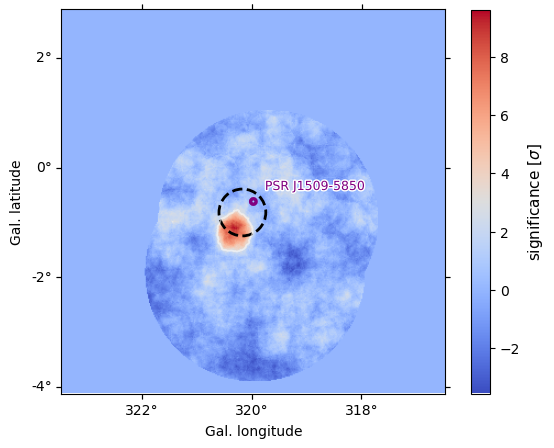

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

W DavidonErrorUpdator delgam < 0 : first derivatives increasing along search line
W VariableMetricBuilder Matrix not pos.def., try to make pos.def.
W MnPosDef non-positive diagonal element in covariance matrix[ 4 ] = -0.00142335
W MnPosDef Added to diagonal of Error matrix a value 0.501424
W DavidonErrorUpdator delgam < 0 : first derivatives increasing along search line
W VariableMetricBuilder Matrix not pos.def, gdel = 0.0502781 > 0
W MnPosDef non-positive diagonal element in covariance matrix[ 4 ] = -0.0167801
W MnPosDef Added to diagonal of Error matrix a value 0.516781
W VariableMetricBuilder gdel = -4.45149
W DavidonErrorUpdator delgam < 0 : first derivatives increasing along search line
W VariableMetricBuilder Matrix not pos.def., try to make pos.def.
W MnPosDef non-positive diagonal element in covariance matrix[ 4 ] = -8.00214e-05
W MnPosDef Added to diagonal of Error matrix a value 0.500081
W VariableMetricBuilder No improvement in line search
W VariableMetricBuilder Iterations

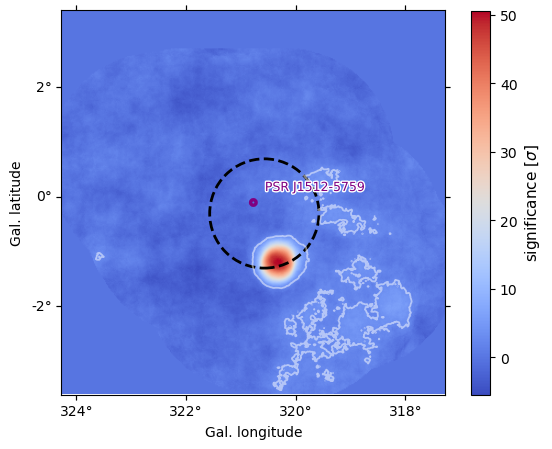

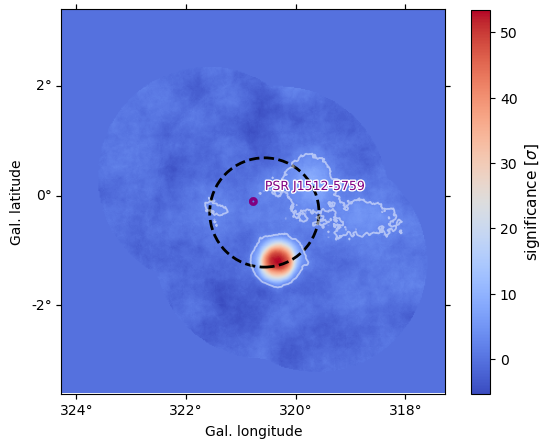

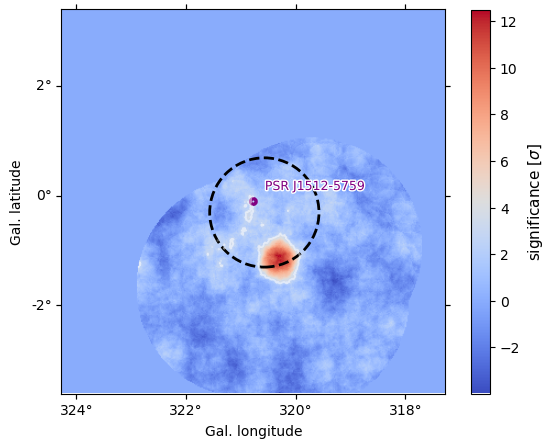

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

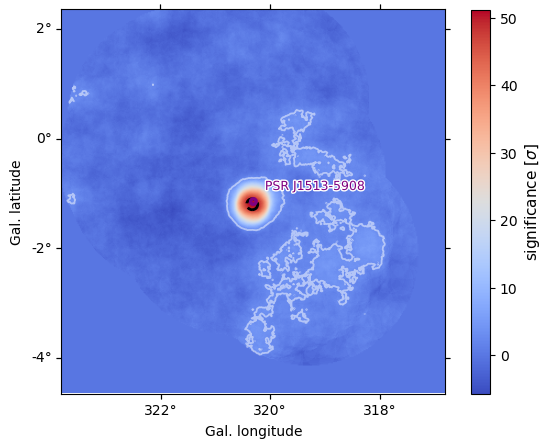

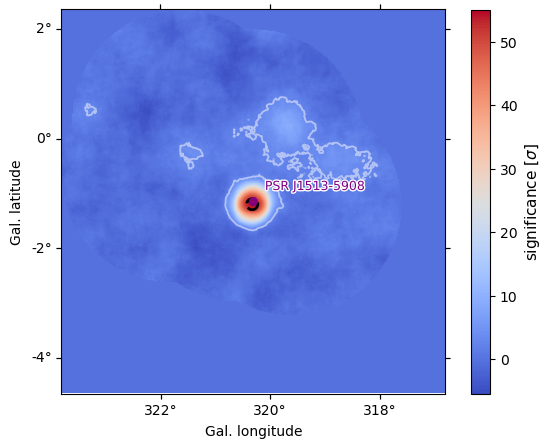

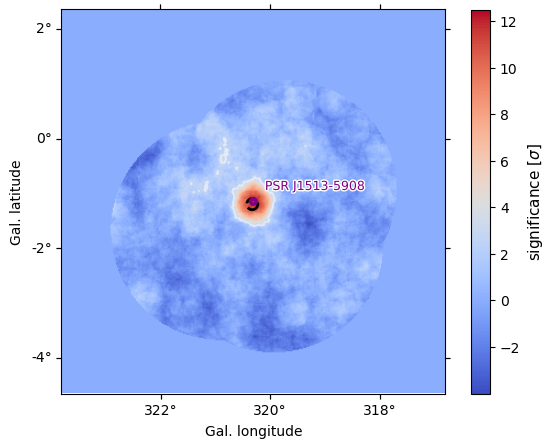

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

W VariableMetricBuilder Reached machine accuracy limit; Edm 0.000343554 is smaller than machine limit 0.0715679 while 0.0002 was requested


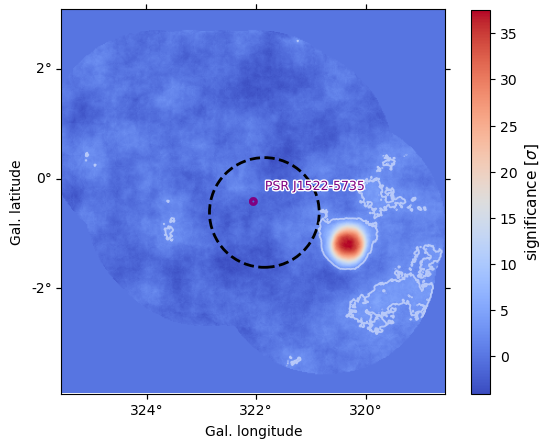

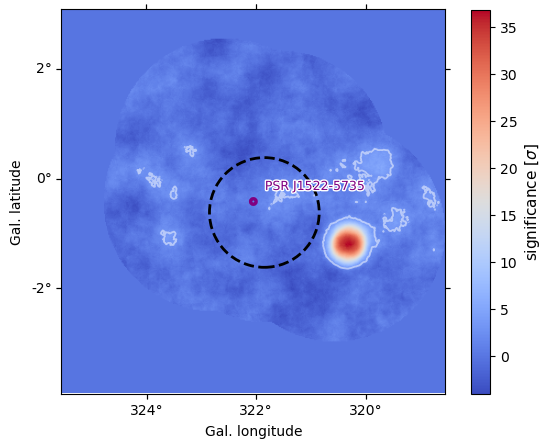

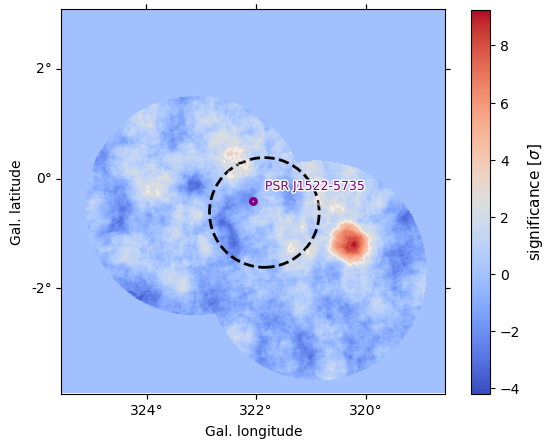

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

W VariableMetricBuilder Reached machine accuracy limit; Edm 0.00419716 is smaller than machine limit 0.0422099 while 0.0002 was requested
W VariableMetricBuilder No convergence; Edm 0.00419716 is above tolerance 0.002
W VariableMetricBuilder No improvement in line search


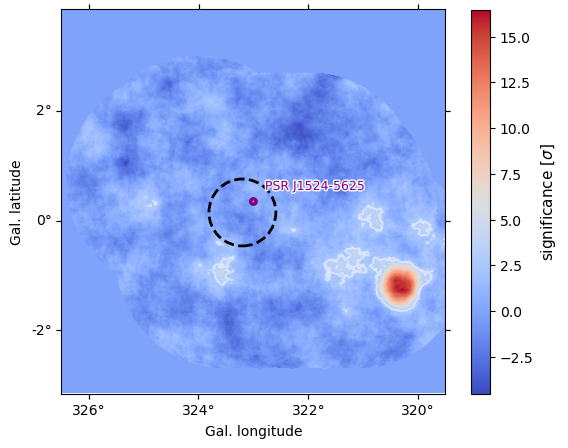

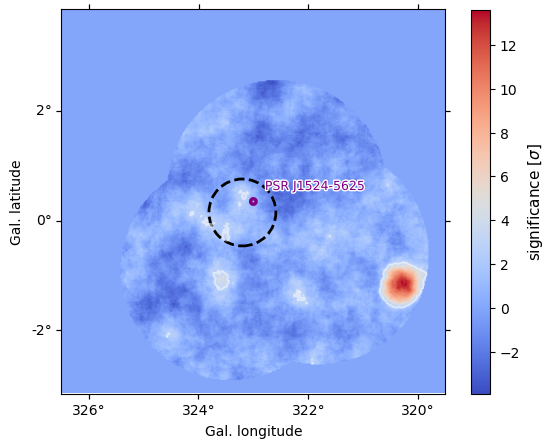

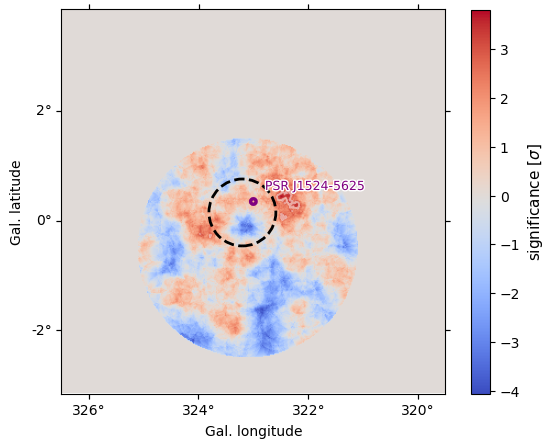

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

W VariableMetricBuilder Reached machine accuracy limit; Edm 0.0355794 is smaller than machine limit 0.0406673 while 0.0002 was requested
W VariableMetricBuilder No convergence; Edm 0.0355794 is above tolerance 0.002
W VariableMetricBuilder No improvement in line search
W VariableMetricBuilder Machine accuracy limits further improvement
W VariableMetricBuilder Reached machine accuracy limit; Edm 0.00163717 is smaller than machine limit 0.0406673 while 0.0002 was requested


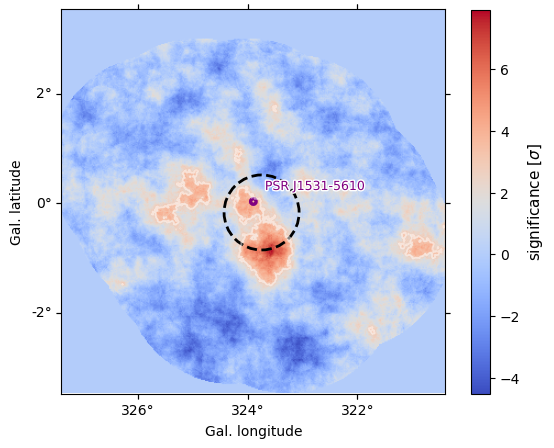

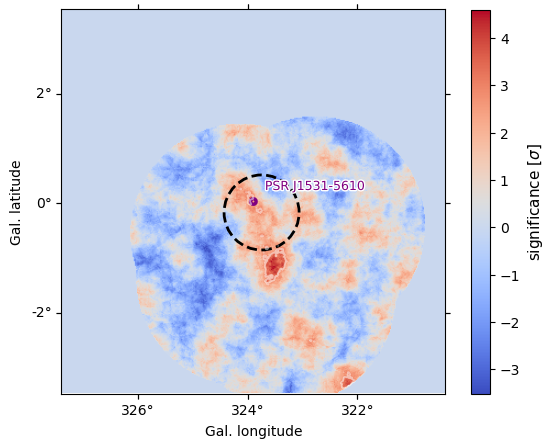

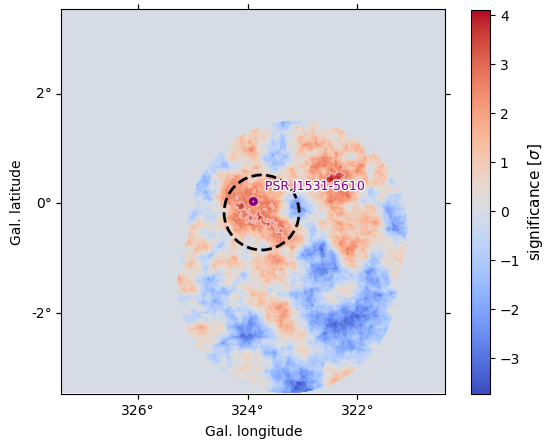

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

W VariableMetricBuilder Reached machine accuracy limit; Edm 0.00103794 is smaller than machine limit 0.0311776 while 0.0002 was requested


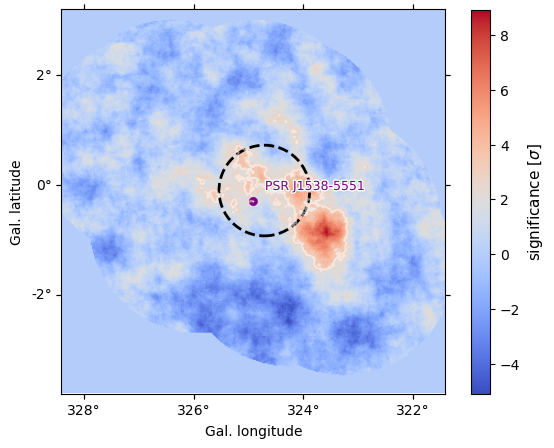

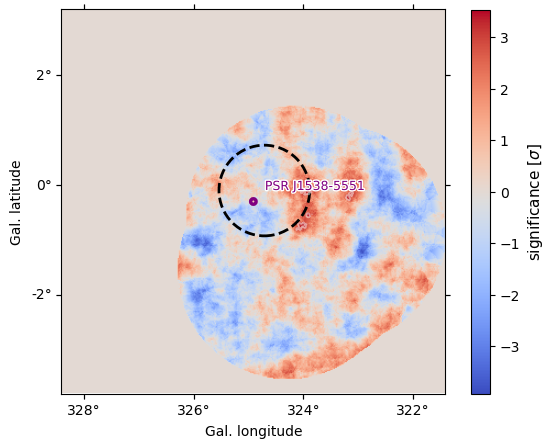

Position <SkyCoord (Galactic): (l, b) in deg
    (324.91159046, -0.29925653)> is outside valid IRF map range, using nearest IRF defined within


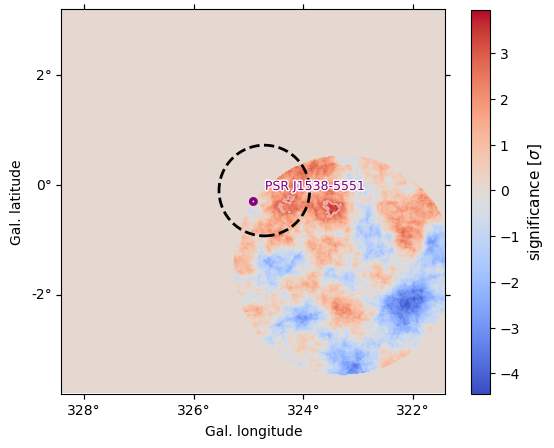

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

W MnPosDef Matrix forced pos-def by adding to diagonal 0.100297
W VariableMetricBuilder Reached machine accuracy limit; Edm 0.00128248 is smaller than machine limit 0.0125861 while 0.0002 was requested


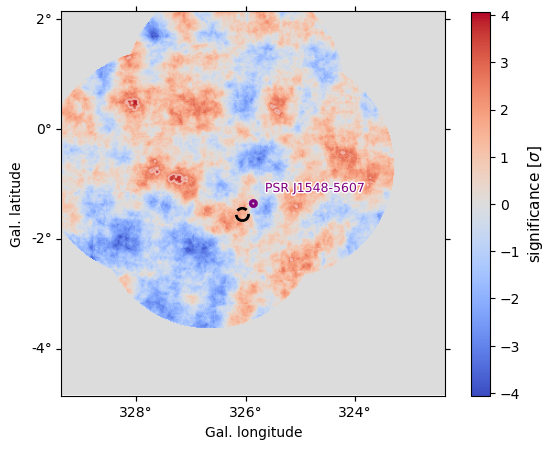

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'


W VariableMetricBuilder Reached machine accuracy limit; Edm 0.000673797 is smaller than machine limit 0.0132297 while 0.0002 was requested


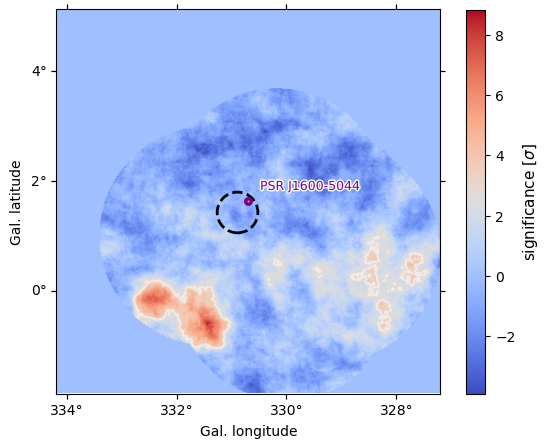

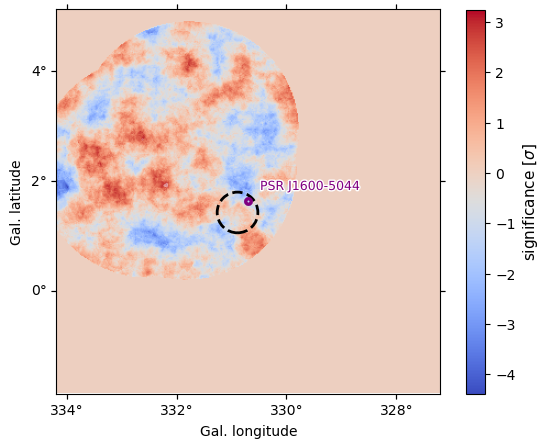

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

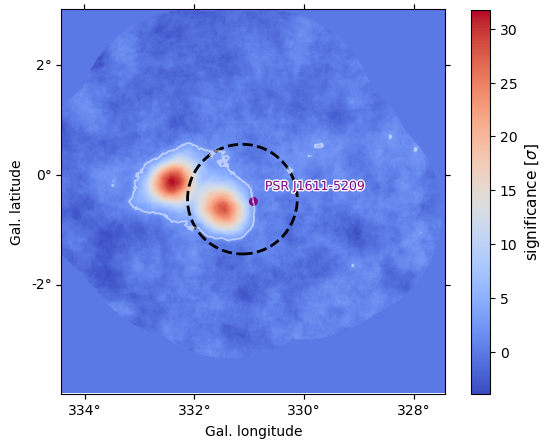

Position <SkyCoord (Galactic): (l, b) in deg
    (330.92255006, -0.48209757)> is outside valid IRF map range, using nearest IRF defined within


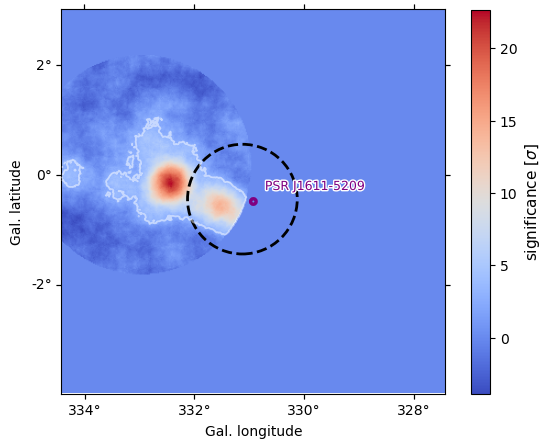

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

W VariableMetricBuilder Reached machine accuracy limit; Edm 0.000493994 is smaller than machine limit 0.0457399 while 0.0002 was requested


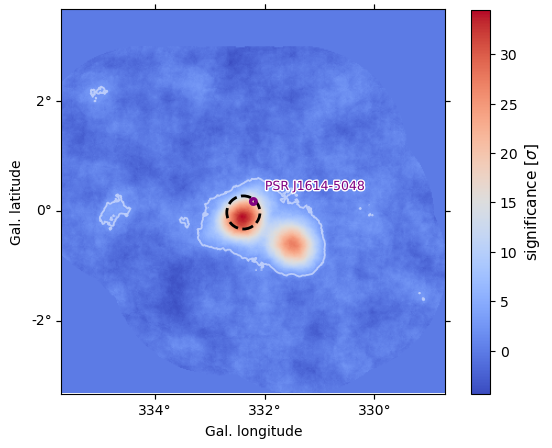

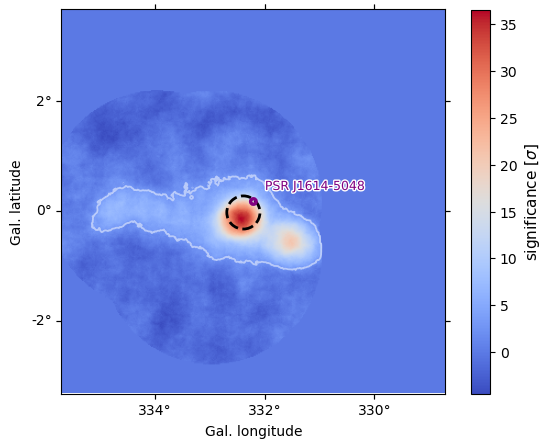

Position <SkyCoord (Galactic): (l, b) in deg
    (332.20645983, 0.17164915)> is outside valid IRF map range, using nearest IRF defined within


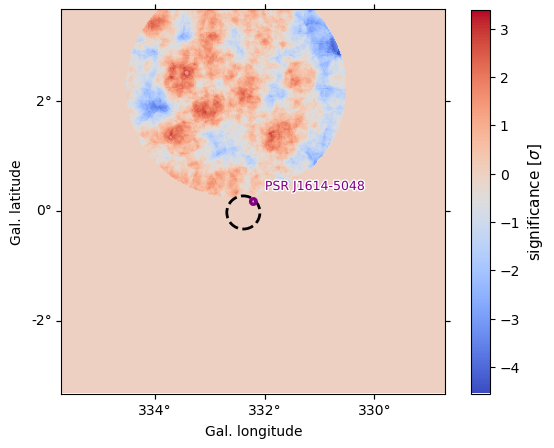

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

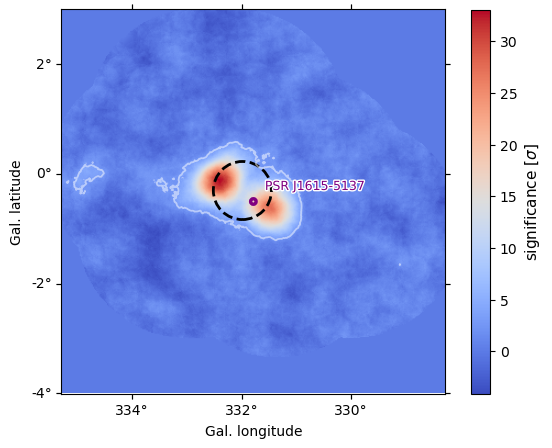

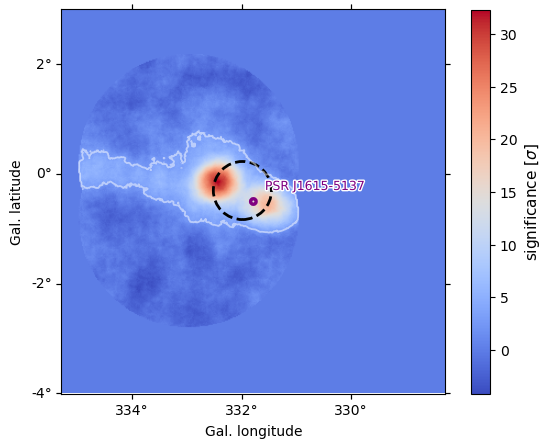

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

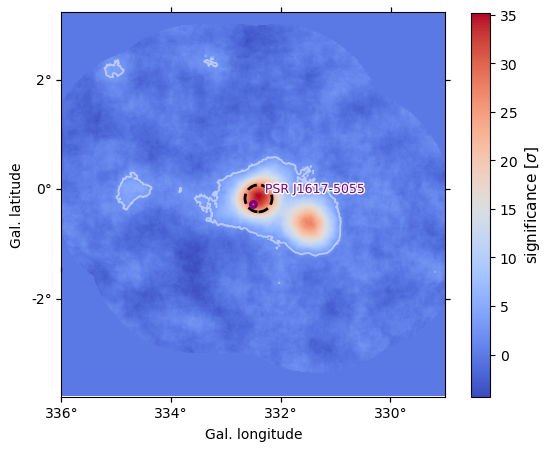

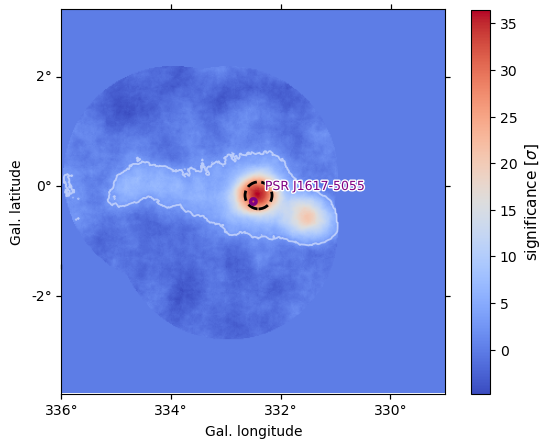

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

W DavidonErrorUpdator delgam < 0 : first derivatives increasing along search line
W VariableMetricBuilder Matrix not pos.def, gdel = 1686.93 > 0
W MnPosDef non-positive diagonal element in covariance matrix[ 3 ] = -0.754406
W MnPosDef Added to diagonal of Error matrix a value 1.25441
W VariableMetricBuilder gdel = -22239.5
W VariableMetricBuilder No improvement in line search
W VariableMetricBuilder Machine accuracy limits further improvement
W VariableMetricBuilder Reached machine accuracy limit; Edm 0.000865262 is smaller than machine limit 0.0523269 while 0.0002 was requested


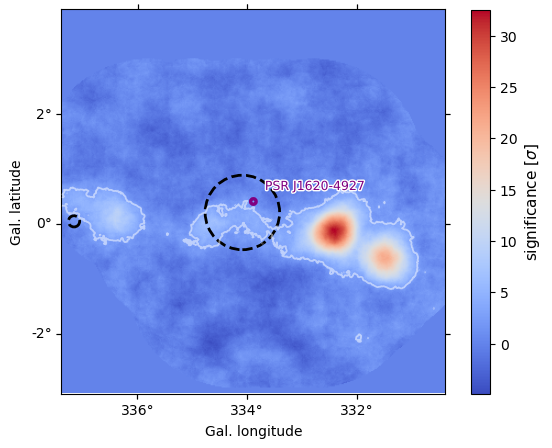

Position <SkyCoord (Galactic): (l, b) in deg
    (337.1576936, 0.04537244)> is outside valid IRF map range, using nearest IRF defined within
Position <SkyCoord (Galactic): (l, b) in deg
    (337.1576936, 0.04537244)> is outside valid IRF map range, using nearest IRF defined within
Model {m.name} is outside the target geom but contributes inside through the psf.This contribution cannot be estimated precisely.Consider extending the dataset geom and/or the masked margin in the mask_fit.


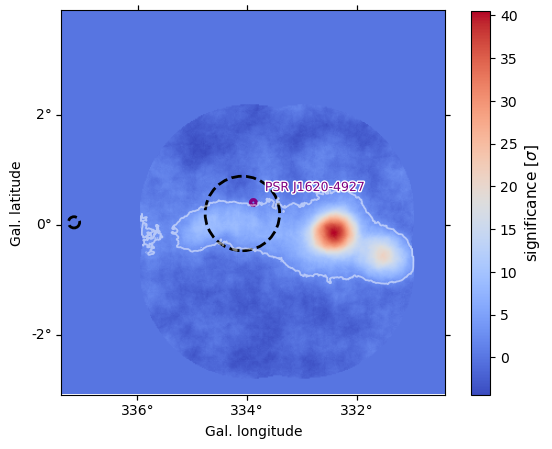

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

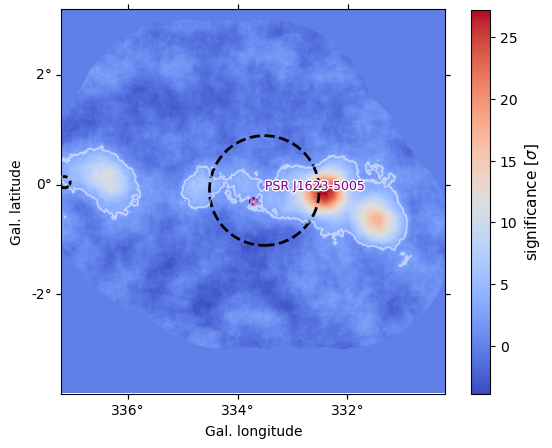

Position <SkyCoord (Galactic): (l, b) in deg
    (337.1576936, 0.04537244)> is outside valid IRF map range, using nearest IRF defined within
Position <SkyCoord (Galactic): (l, b) in deg
    (337.1576936, 0.04537244)> is outside valid IRF map range, using nearest IRF defined within
Model {m.name} is outside the target geom but contributes inside through the psf.This contribution cannot be estimated precisely.Consider extending the dataset geom and/or the masked margin in the mask_fit.


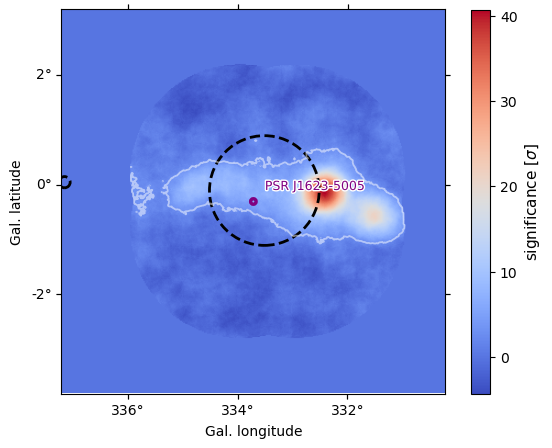

Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 21352
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 21427
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 22155
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 21352
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 21427
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 22155
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword a

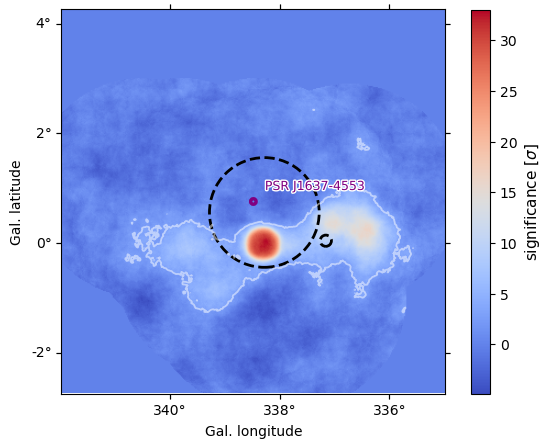

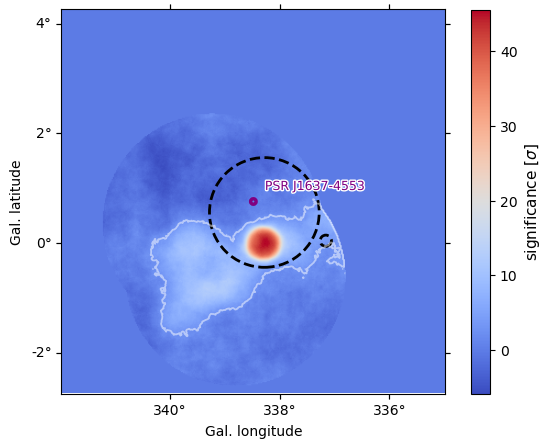

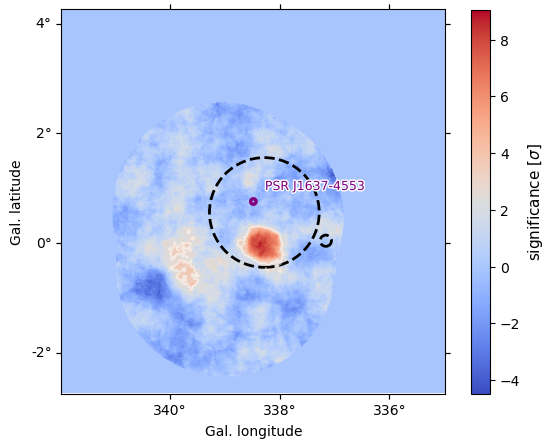

Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 21352
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 21427
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 22155
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 21352
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 21427
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 22155
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword a

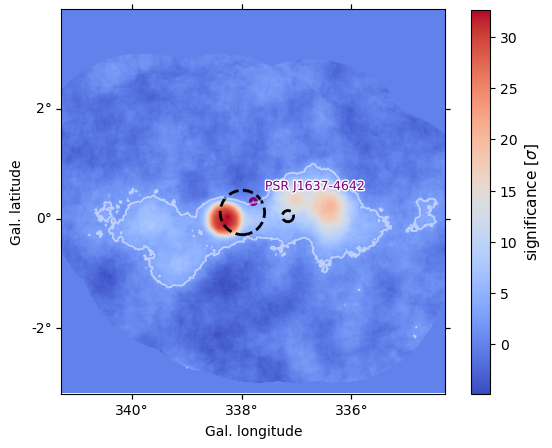

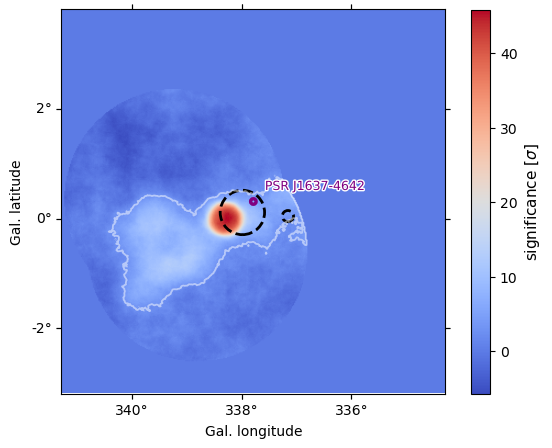

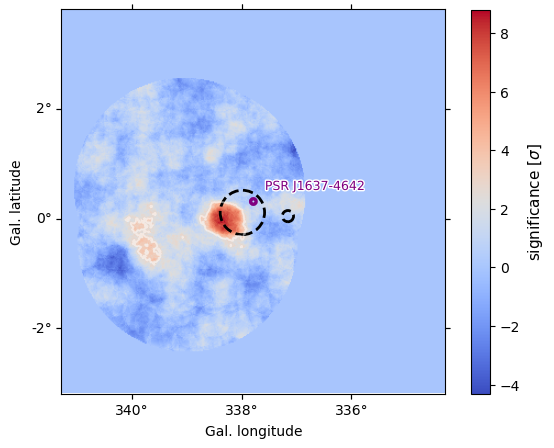

Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 21303
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 21352
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 21398
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 21427
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 21443
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 21454
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 22155
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 21303
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 21352
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 21398
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 21427
Skipping run with missing HDUs; Required HDUs ['bkg'] not found i

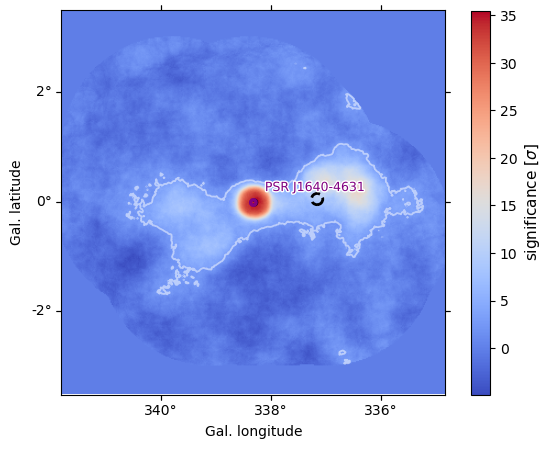

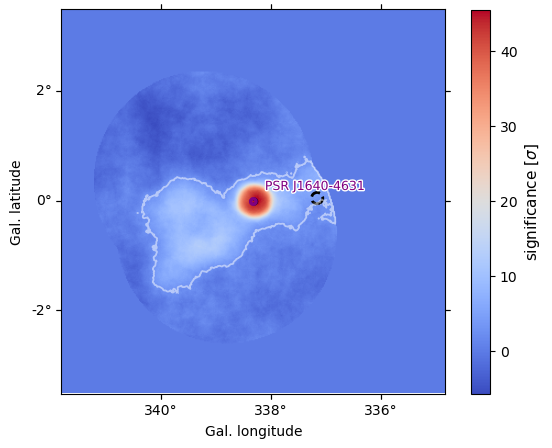

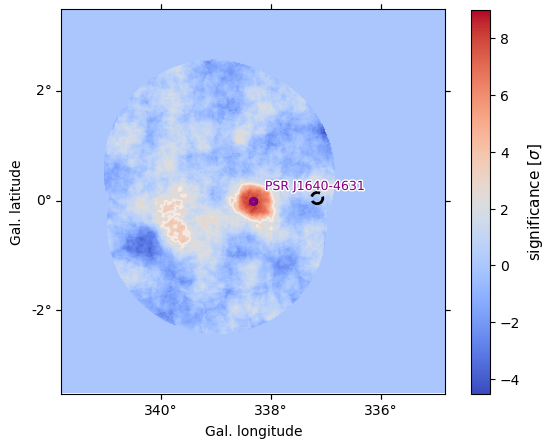

Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 21303
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 21352
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 21398
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 21427
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 21443
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 21454
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 22155
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 21303
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 21352
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 21398
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 21427
Skipping run with missing HDUs; Required HDUs ['bkg'] not found i

W VariableMetricBuilder No improvement in line search
W VariableMetricBuilder Iterations finish without convergence; Edm 224.293 Requested 0.0002
W MnPosDef Matrix forced pos-def by adding to diagonal 0.190851
W VariableMetricBuilder No improvement in line search
W VariableMetricBuilder Iterations finish without convergence; Edm 60118.4 Requested 0.0002
W VariableMetricBuilder FunctionMinimum is invalid after second try
W VariableMetricBuilder No improvement in line search
W VariableMetricBuilder Iterations finish without convergence; Edm 0.190072 Requested 0.0002
W DavidonErrorUpdator delgam < 0 : first derivatives increasing along search line
W VariableMetricBuilder Matrix not pos.def, gdel = 0.00317956 > 0
W MnPosDef non-positive diagonal element in covariance matrix[ 3 ] = -0.00766465
W MnPosDef Added to diagonal of Error matrix a value 0.507666
W VariableMetricBuilder gdel = -0.445977
W VariableMetricBuilder No improvement in line search
W VariableMetricBuilder Iterations finish w

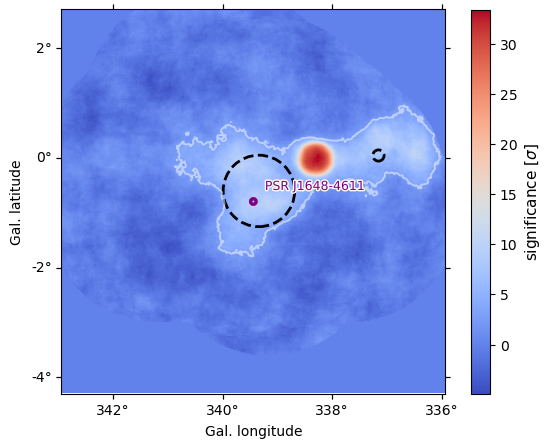

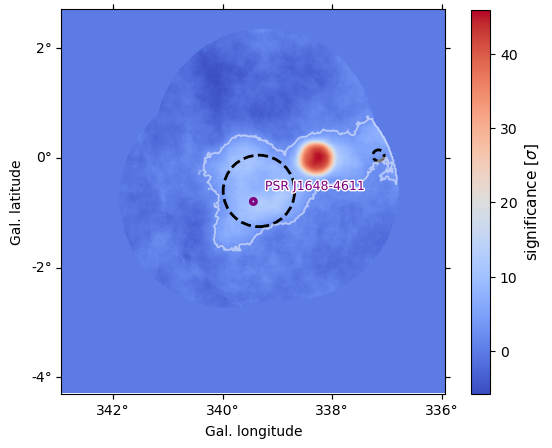

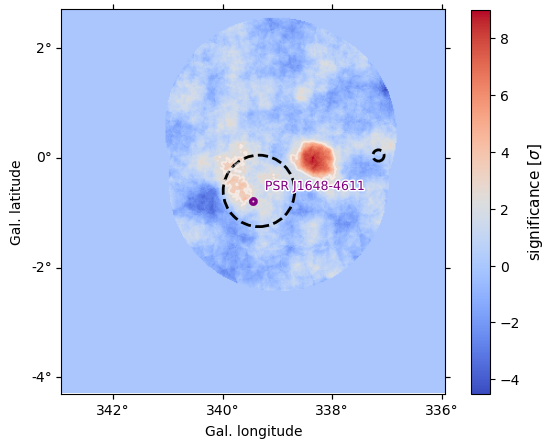

Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 21303
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 21352
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 21398
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 21427
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 21443
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 21454
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 22155
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 21303
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 21352
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 21398
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 21427
Skipping run with missing HDUs; Required HDUs ['bkg'] not found i

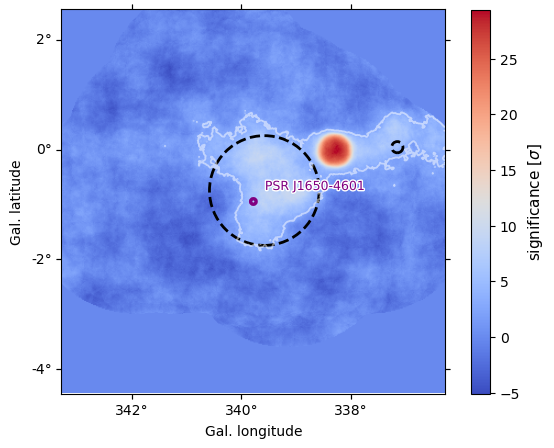

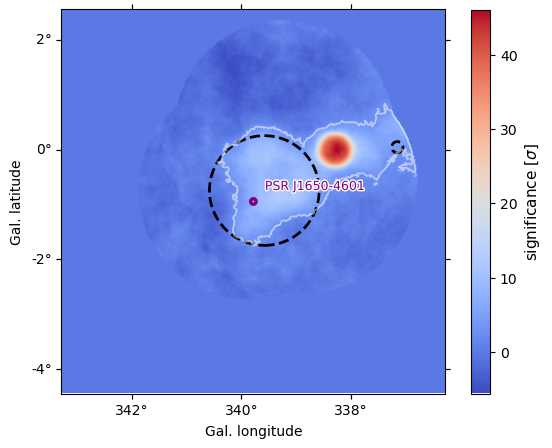

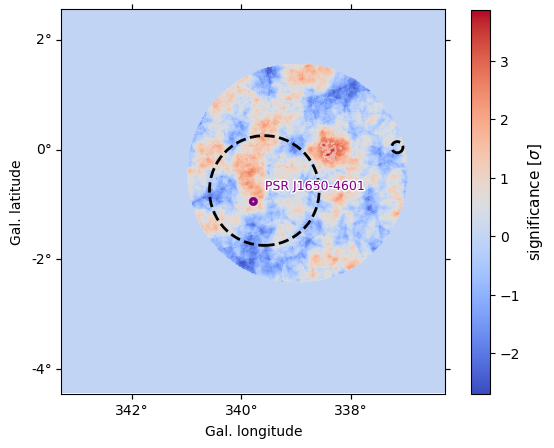

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

W DavidonErrorUpdator delgam < 0 : first derivatives increasing along search line
W VariableMetricBuilder Matrix not pos.def, gdel = 1857.97 > 0
W MnPosDef non-positive diagonal element in covariance matrix[ 0 ] = -0.00147317
W MnPosDef Added to diagonal of Error matrix a value 0.501474
W VariableMetricBuilder gdel = -417173


/home/wecapstor1/caph/mppi103h/software/miniforge3/envs/gammapy-1.20/lib/python3.10/site-packages/astropy/units/quantity.py:671: RuntimeWarning: overflow encountered in power
  result = super().__array_ufunc__(function, method, *arrays, **kwargs)
/home/wecapstor1/caph/mppi103h/software/miniforge3/envs/gammapy-1.20/lib/python3.10/site-packages/astropy/units/quantity.py:671: RuntimeWarning: overflow encountered in power
  result = super().__array_ufunc__(function, method, *arrays, **kwargs)
/home/wecapstor1/caph/mppi103h/software/miniforge3/envs/gammapy-1.20/lib/python3.10/site-packages/astropy/units/quantity.py:671: RuntimeWarning: overflow encountered in power
  result = super().__array_ufunc__(function, method, *arrays, **kwargs)


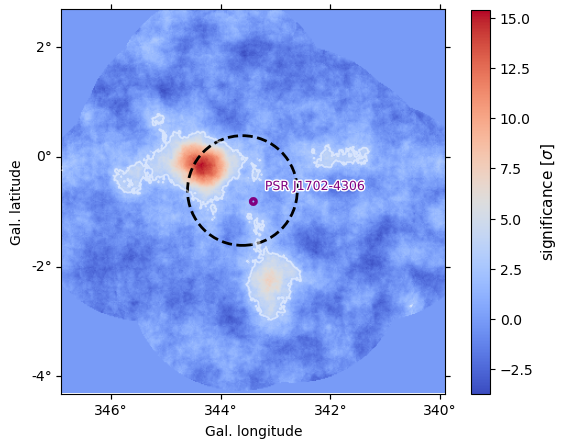

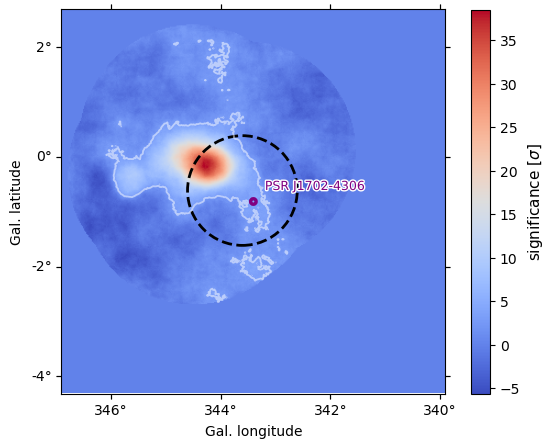

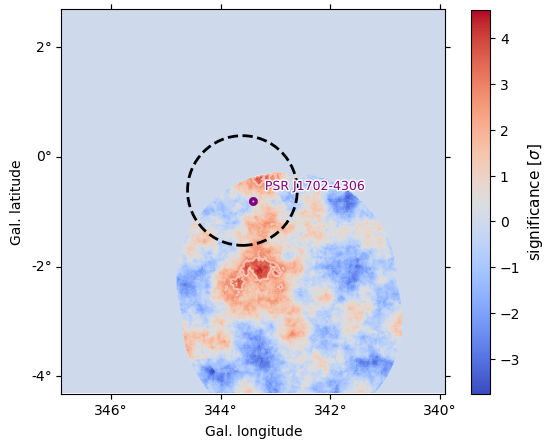

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

W VariableMetricBuilder Reached machine accuracy limit; Edm 0.000204527 is smaller than machine limit 0.02371 while 0.0002 was requested


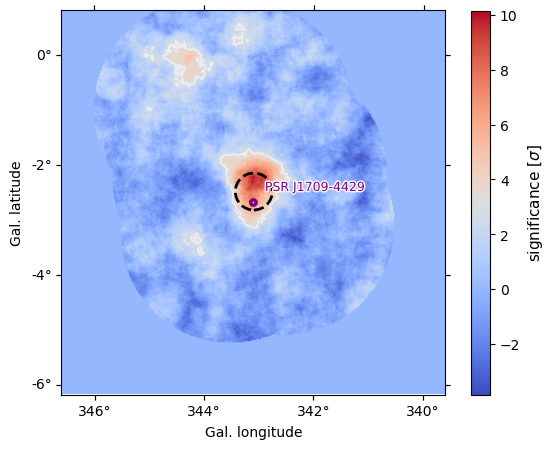

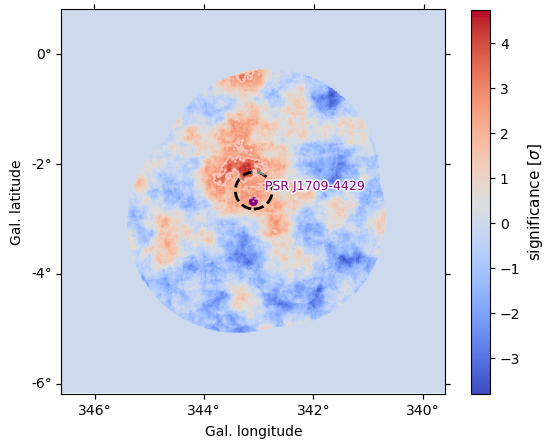

Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 27025
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 27110
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 27161
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 27185
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 27203
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 27917
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 27935
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 27979
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 67099
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 27025
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 27110
Skipping run with missing HDUs; Required HDUs ['bkg'] not found i

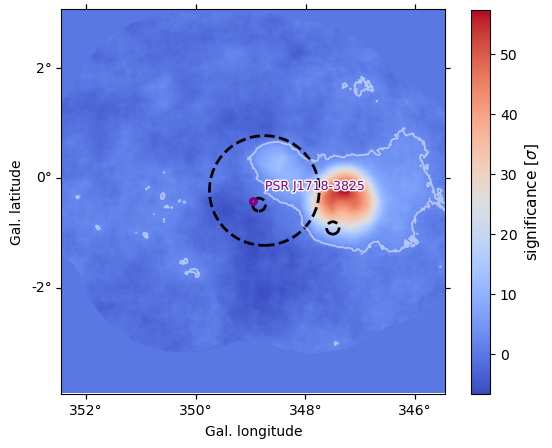

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

W VariableMetricBuilder Reached machine accuracy limit; Edm 0.00794663 is smaller than machine limit 0.0265176 while 0.0002 was requested
W VariableMetricBuilder No convergence; Edm 0.00794663 is above tolerance 0.002
W DavidonErrorUpdator delgam < 0 : first derivatives increasing along search line
W VariableMetricBuilder Matrix not pos.def, gdel = 0.001546 > 0
W MnPosDef non-positive diagonal element in covariance matrix[ 0 ] = -0.0108174
W MnPosDef non-positive diagonal element in covariance matrix[ 1 ] = -0.143267
W MnPosDef non-positive diagonal element in covariance matrix[ 4 ] = -0.0140865
W MnPosDef Added to diagonal of Error matrix a value 0.643268
W VariableMetricBuilder gdel = -0.0262223
W VariableMetricBuilder No improvement in line search
W VariableMetricBuilder Machine accuracy limits further improvement
W VariableMetricBuilder Reached machine accuracy limit; Edm 0.00525092 is smaller than machine limit 0.0265176 while 0.0002 was requested
W VariableMetricBuilder No conver

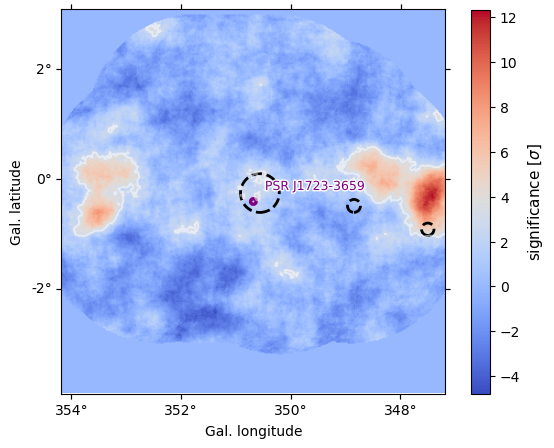

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

W VariableMetricBuilder Reached machine accuracy limit; Edm 0.000901854 is smaller than machine limit 0.0522673 while 0.0002 was requested


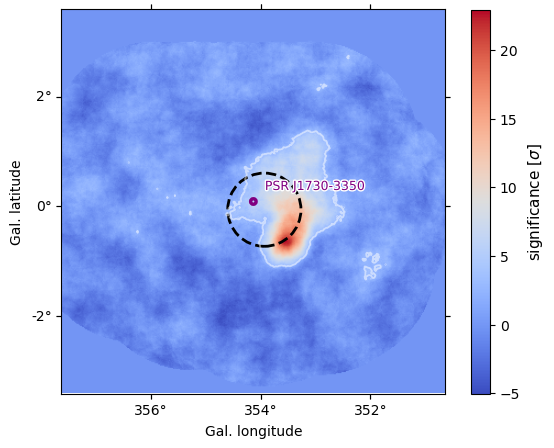

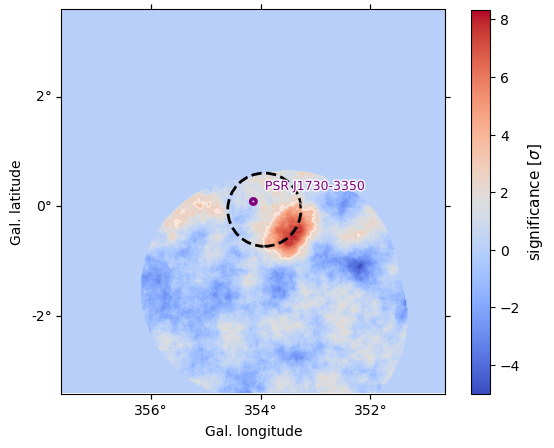

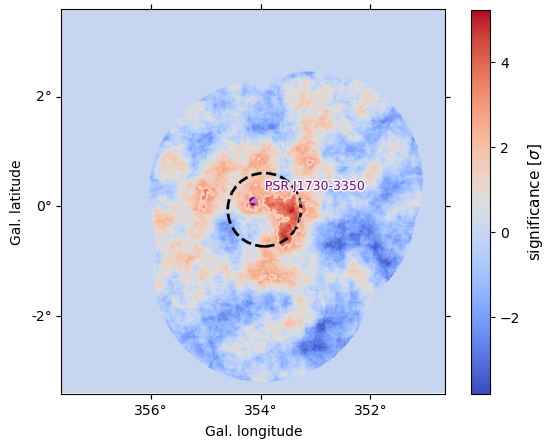

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

W VariableMetricBuilder No improvement in line search
W VariableMetricBuilder Machine accuracy limits further improvement
W VariableMetricBuilder Reached machine accuracy limit; Edm 0.000216629 is smaller than machine limit 0.0350589 while 0.0002 was requested


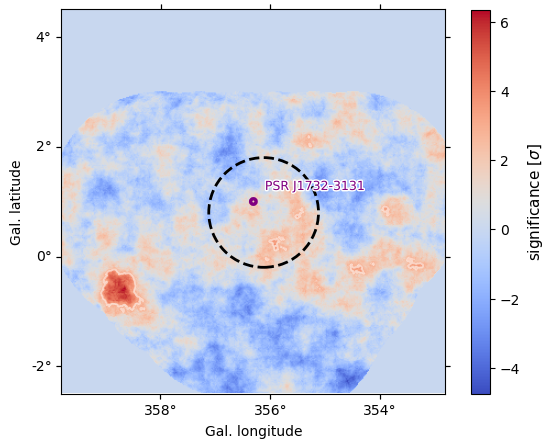

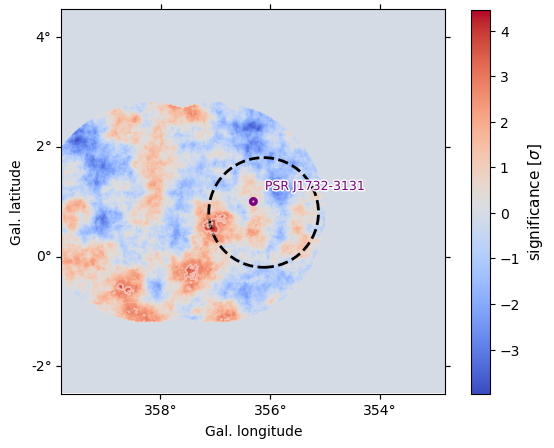

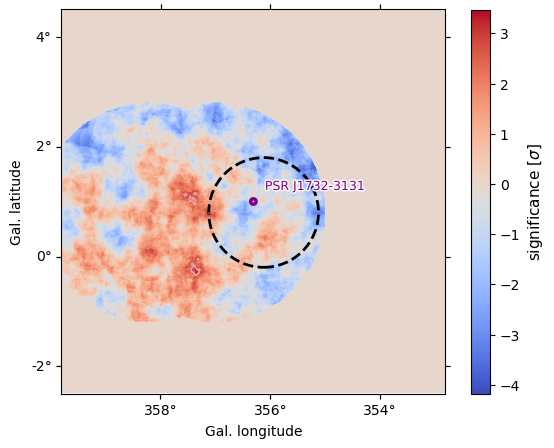

Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 27578
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 27638
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 27578
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 27638
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword ass

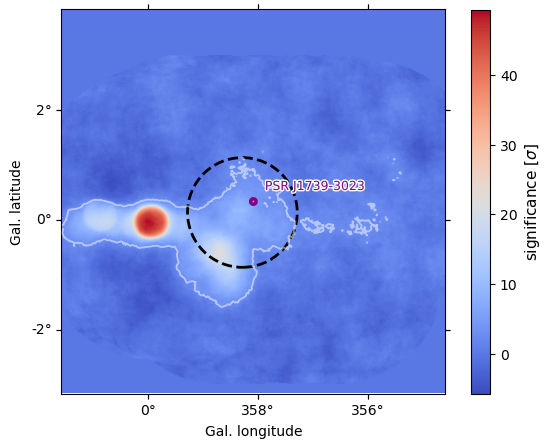

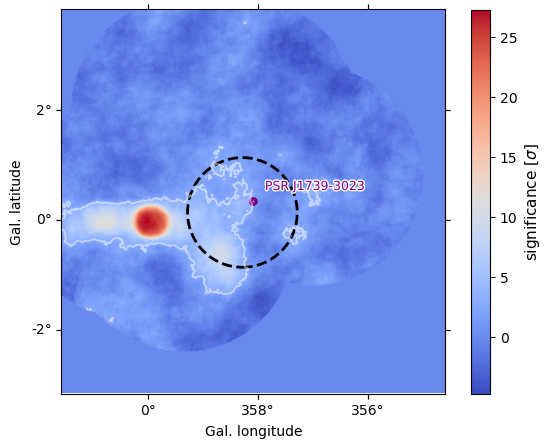

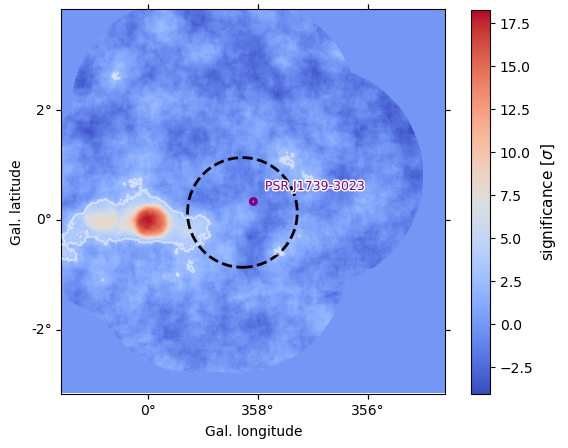

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'


W MnPosDef Matrix forced pos-def by adding to diagonal 11.6053
W VariableMetricBuilder Reached machine accuracy limit; Edm 0.00256466 is smaller than machine limit 0.00825136 while 0.0002 was requested
W VariableMetricBuilder No convergence; Edm 0.00256466 is above tolerance 0.002
W MnPosDef non-positive diagonal element in covariance matrix[ 0 ] = -2.5169e-07
W MnPosDef non-positive diagonal element in covariance matrix[ 2 ] = -4.19095e-09
W MnPosDef Added to diagonal of Error matrix a value 0.500001


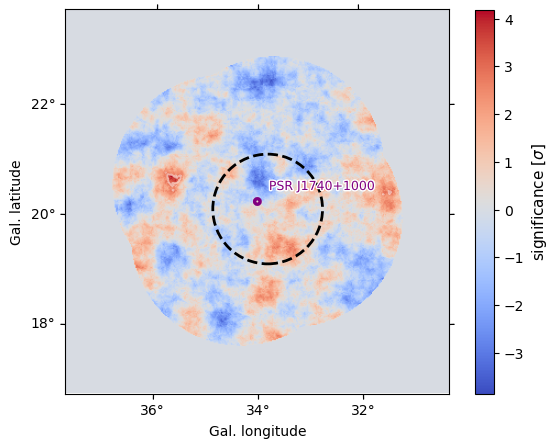

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

W VariableMetricBuilder Reached machine accuracy limit; Edm 0.000260976 is smaller than machine limit 0.0391366 while 0.0002 was requested


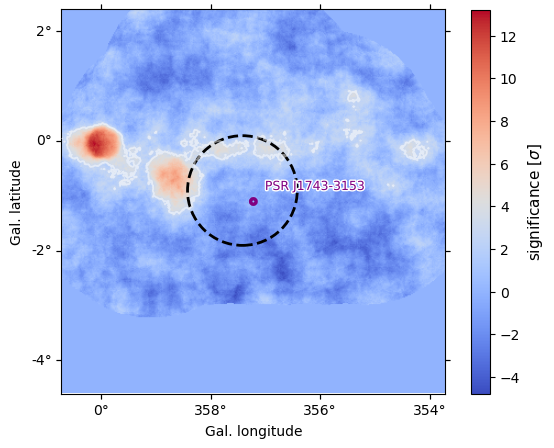

Position <SkyCoord (Galactic): (l, b) in deg
    (357.22058928, -1.10867193)> is outside valid IRF map range, using nearest IRF defined within


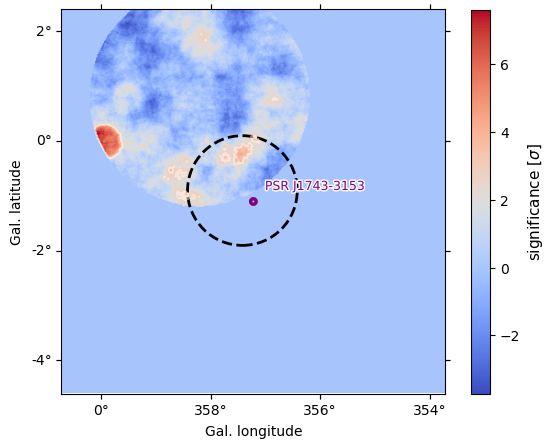

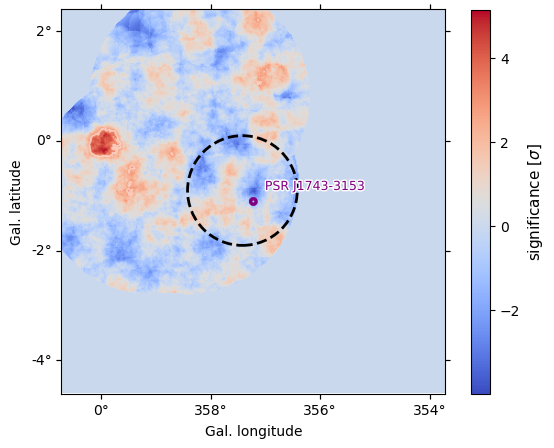

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Position <SkyCoord (Galactic): (l, b) in deg
    (356.96226022, -2.17300001)> is outside valid IRF map range, using ne

W MnPosDef non-positive diagonal element in covariance matrix[ 2 ] = -1.50176e-07
W MnPosDef non-positive diagonal element in covariance matrix[ 4 ] = -2.94391e-06
W MnPosDef Added to diagonal of Error matrix a value 0.500004


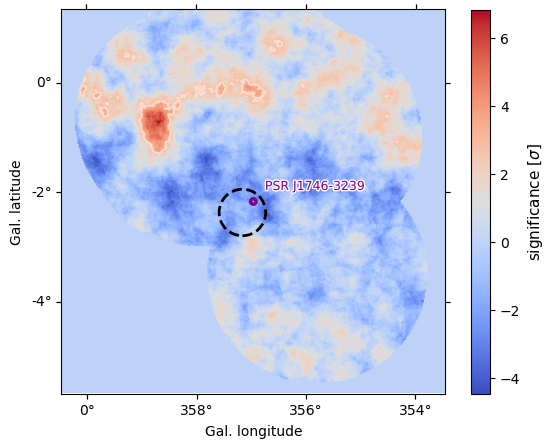

Position <SkyCoord (Galactic): (l, b) in deg
    (356.96226022, -2.17300001)> is outside valid IRF map range, using nearest IRF defined within


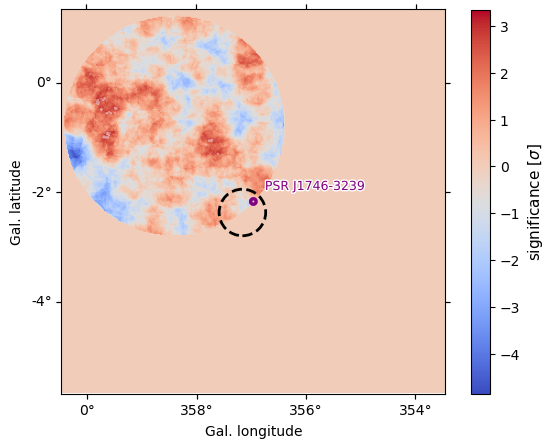

Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 20191
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 27162
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 27204
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 27329
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 27578
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 27607
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 27638
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 20191
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 27162
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 27204
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 27329
Skipping run with missing HDUs; Required HDUs ['bkg'] not found i

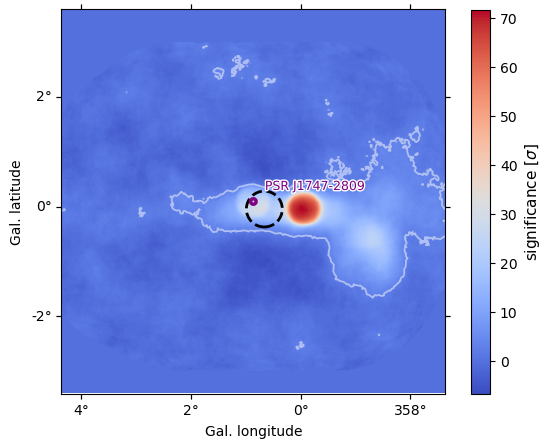

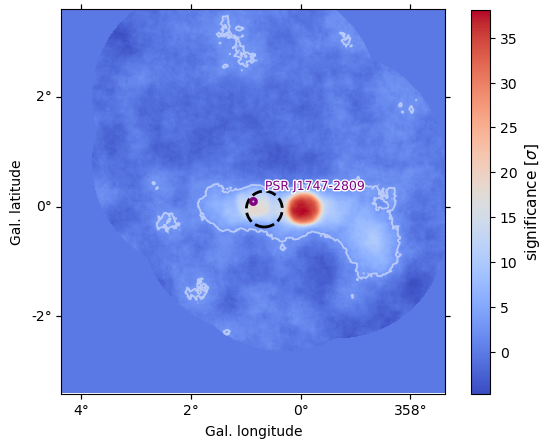

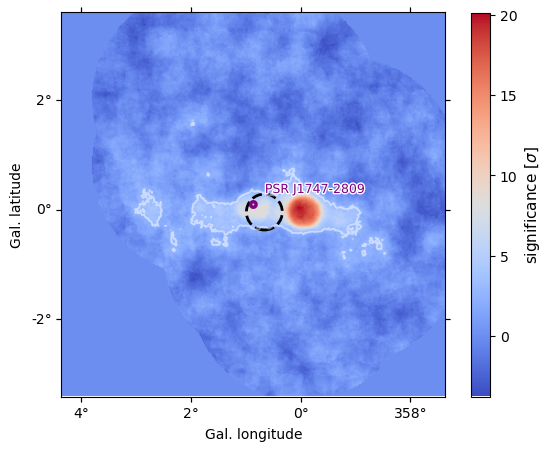

Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 20191
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 27162
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 27204
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 27329
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 27578
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 27607
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 27638
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 20191
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 27162
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 27204
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 27329
Skipping run with missing HDUs; Required HDUs ['bkg'] not found i

W VariableMetricBuilder No improvement in line search
W VariableMetricBuilder Machine accuracy limits further improvement
W VariableMetricBuilder Reached machine accuracy limit; Edm 0.00091538 is smaller than machine limit 0.0852747 while 0.0002 was requested


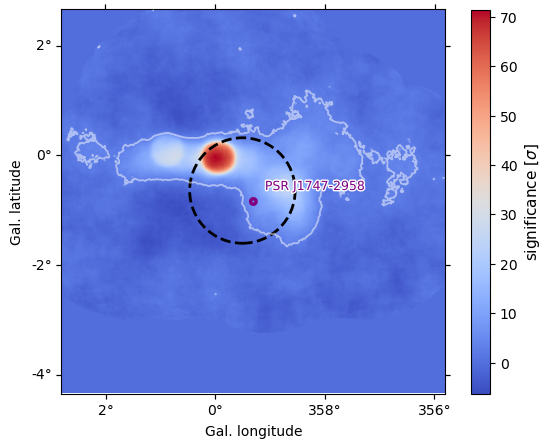

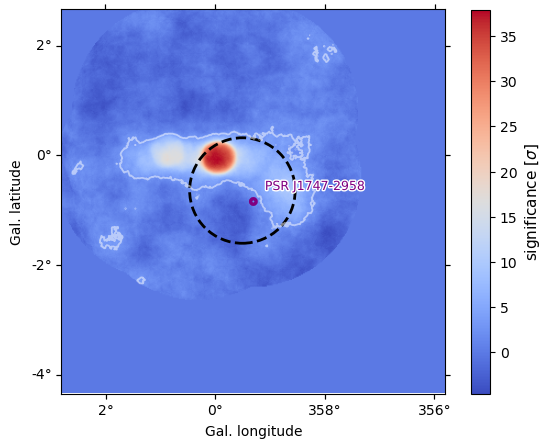

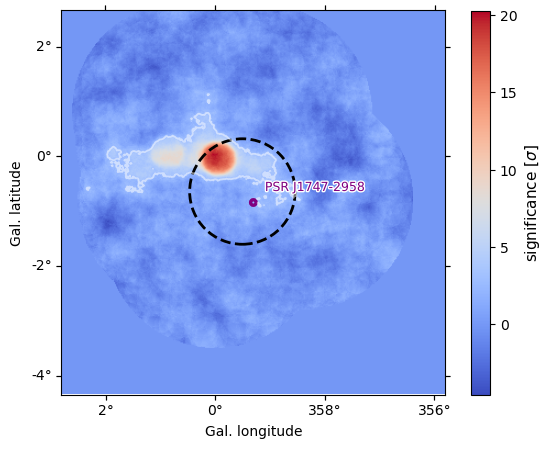

Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 20191
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 27162
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 27204
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 27329
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 27578
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 27607
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 27638
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 20191
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 27162
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 27204
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 27329
Skipping run with missing HDUs; Required HDUs ['bkg'] not found i

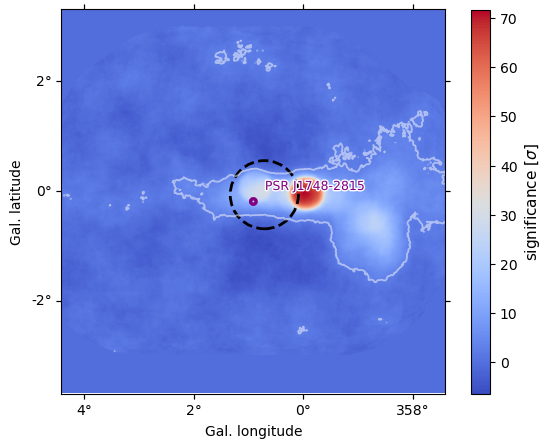

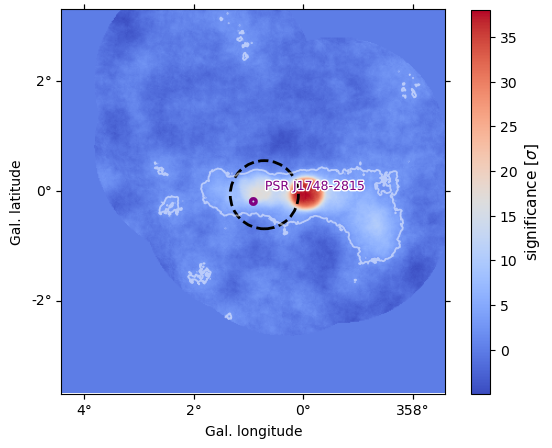

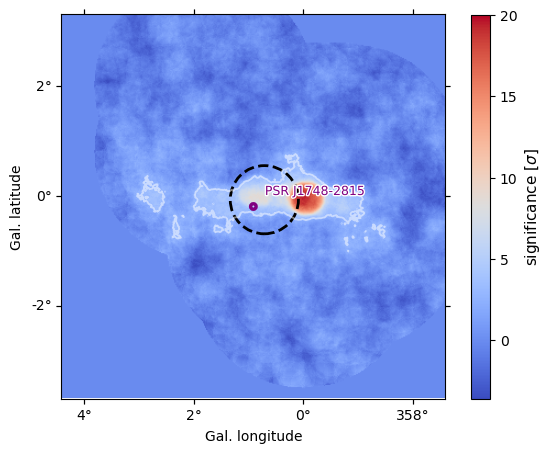

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

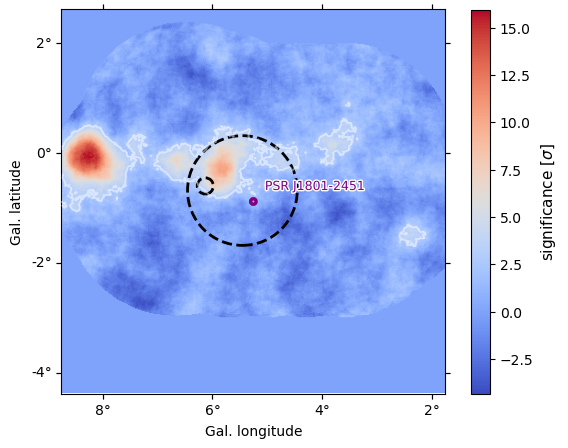

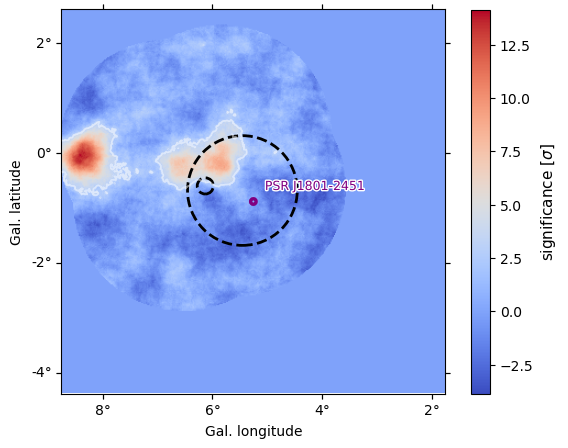

Position <SkyCoord (Galactic): (l, b) in deg
    (5.25433771, -0.88192502)> is outside valid IRF map range, using nearest IRF defined within


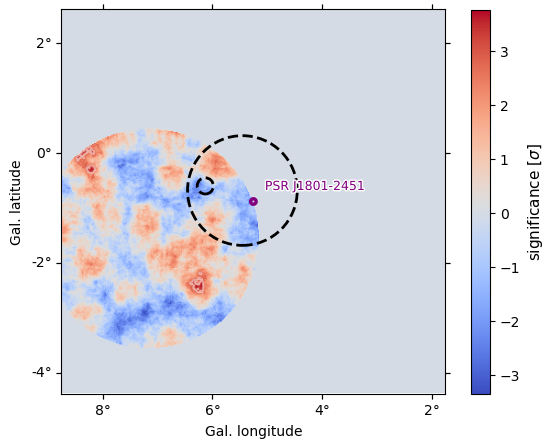

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

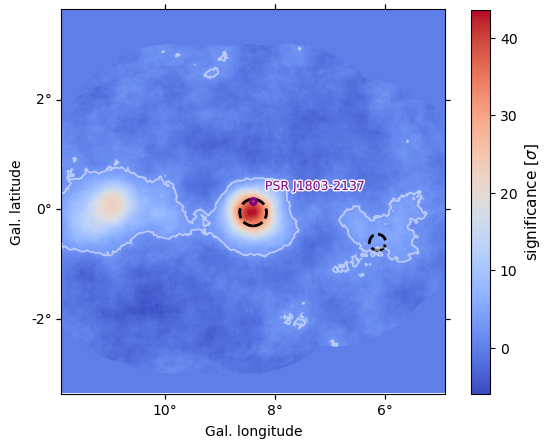

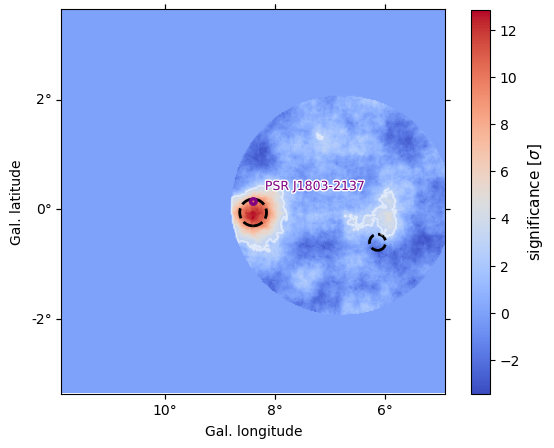

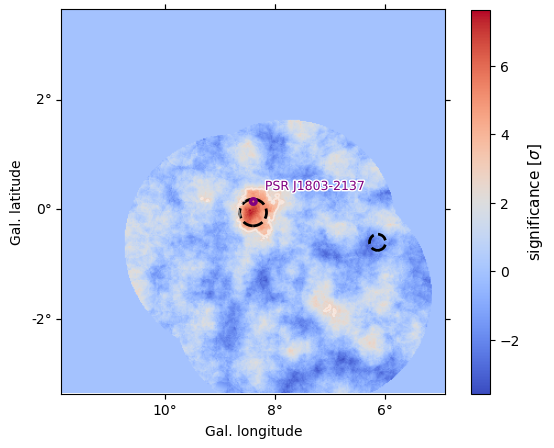

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

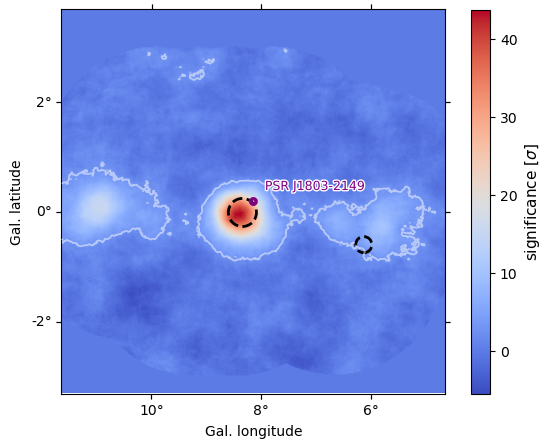

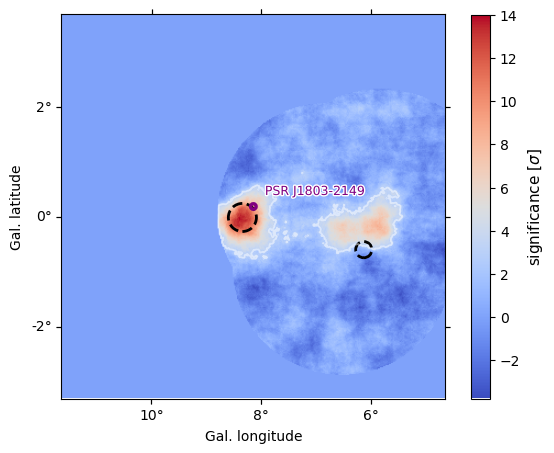

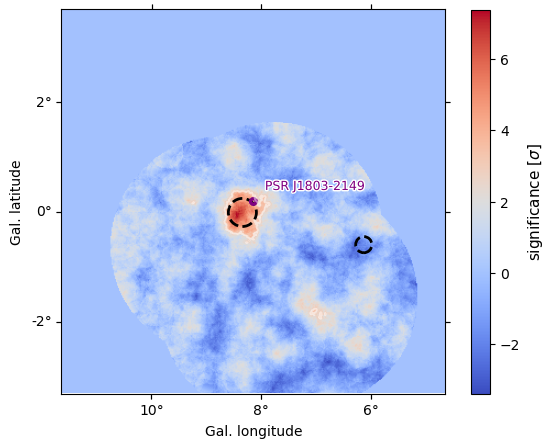

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
FoVBackgroundMaker failed. Non-finite normalisation value for obs-21522. Setting mask to False.
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' key

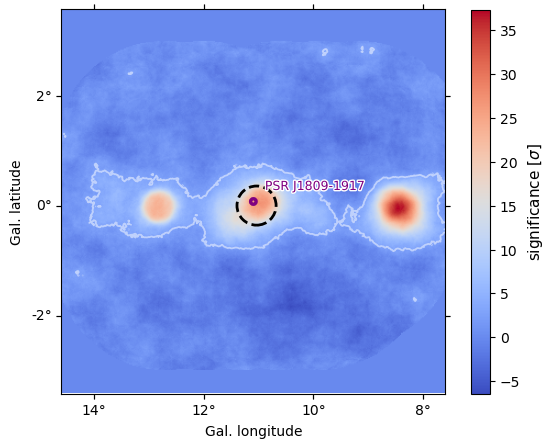

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

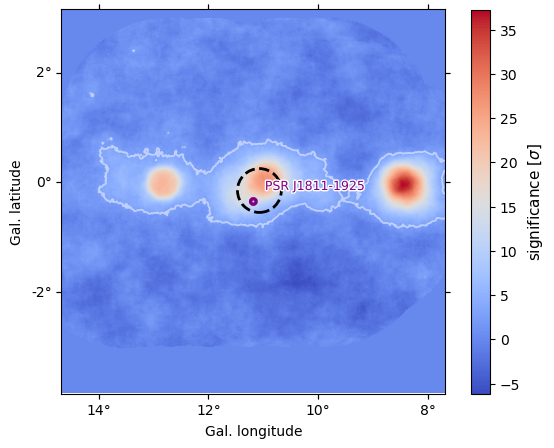

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

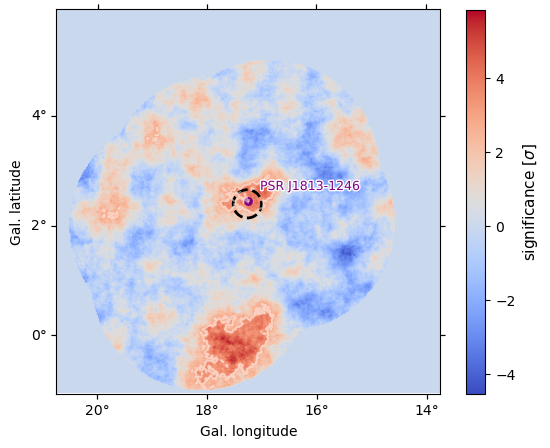

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
FoVBackgroundMaker failed. Non-finite normalisation value for obs-21522. Setting mask to False.
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' key

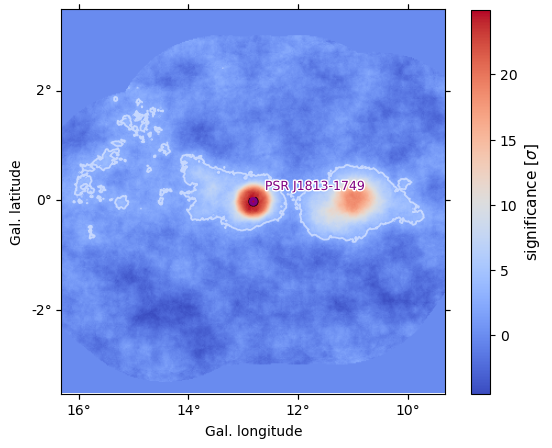

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Position <SkyCoord (Galactic): (l, b) in deg
    (21.86673522, 4.09166904)> is outside valid IRF map range, using nearest IRF defined within
Position <SkyCoord (Galactic): (l, b) in deg
    (21.86673522, 4.09166904)> is outside valid IRF map range, using nearest IRF defined within
Position <SkyCoord (Galactic): (l, b) in deg
    (21.89154869, 4.09166904)> is outside valid IRF map range, using nearest IRF defined within
Position <SkyCoord (Galactic): (l, b) in deg
    (21.89154869, 4.09166904)> is outside valid IRF map range, using nearest IRF defined within
Position <SkyCoord (Galactic): (l, b) in deg
    (21.86673522, 4.09166904)> is outside valid IRF map range, using nearest IRF defined within


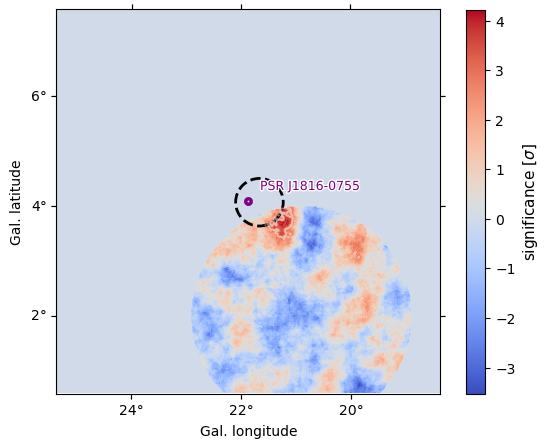

Position <SkyCoord (Galactic): (l, b) in deg
    (21.66673912, 4.07845963)> is outside valid IRF map range, using nearest IRF defined within
Position <SkyCoord (Galactic): (l, b) in deg
    (21.66673912, 4.07845963)> is outside valid IRF map range, using nearest IRF defined within
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
FoVBackgroundMaker failed. Non-finite normalisation value for obs-21522. Setting mask to False.
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

W VariableMetricBuilder Reached machine accuracy limit; Edm 0.000668726 is smaller than machine limit 0.0328211 while 0.0002 was requested


Position <SkyCoord (Galactic): (l, b) in deg
    (16.88162208, -1.28853039)> is outside valid IRF map range, using nearest IRF defined within
Position <SkyCoord (Galactic): (l, b) in deg
    (16.88162208, -1.28853039)> is outside valid IRF map range, using nearest IRF defined within
Model {m.name} is outside the target geom but contributes inside through the psf.This contribution cannot be estimated precisely.Consider extending the dataset geom and/or the masked margin in the mask_fit.


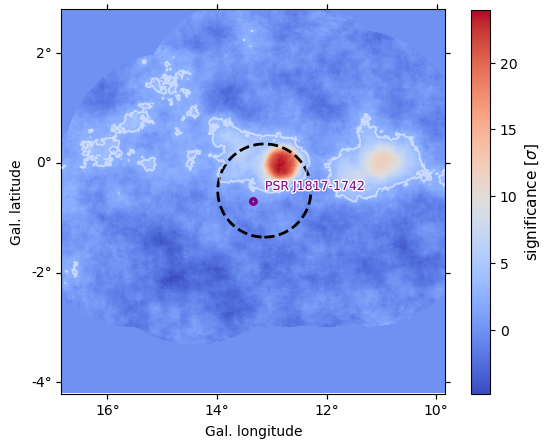

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

W DavidonErrorUpdator delgam < 0 : first derivatives increasing along search line
W VariableMetricBuilder Matrix not pos.def, gdel = 0.00743857 > 0
W MnPosDef non-positive diagonal element in covariance matrix[ 1 ] = -0.0691776
W MnPosDef Added to diagonal of Error matrix a value 0.569179
W VariableMetricBuilder gdel = -67.3171


Position <SkyCoord (Galactic): (l, b) in deg
    (25.15058214, 0.14386592)> is outside valid IRF map range, using nearest IRF defined within
Position <SkyCoord (Galactic): (l, b) in deg
    (25.15058214, 0.14386592)> is outside valid IRF map range, using nearest IRF defined within


W DavidonErrorUpdator delgam < 0 : first derivatives increasing along search line
W VariableMetricBuilder Matrix not pos.def, gdel = 0.000488503 > 0
W MnPosDef non-positive diagonal element in covariance matrix[ 3 ] = -0.00249629
W MnPosDef Added to diagonal of Error matrix a value 0.502497
W VariableMetricBuilder gdel = -0.38885
W DavidonErrorUpdator delgam < 0 : first derivatives increasing along search line
W VariableMetricBuilder Matrix not pos.def, gdel = 0.000592004 > 0
W MnPosDef non-positive diagonal element in covariance matrix[ 1 ] = -0.0236252
W MnPosDef non-positive diagonal element in covariance matrix[ 5 ] = -5.41302e-12
W MnPosDef Added to diagonal of Error matrix a value 0.523626
W VariableMetricBuilder gdel = -10.5724
W DavidonErrorUpdator delgam < 0 : first derivatives increasing along search line


Position <SkyCoord (Galactic): (l, b) in deg
    (25.58105994, 0.15619257)> is outside valid IRF map range, using nearest IRF defined within
Position <SkyCoord (Galactic): (l, b) in deg
    (25.58105994, 0.15619257)> is outside valid IRF map range, using nearest IRF defined within


W VariableMetricBuilder Matrix not pos.def., try to make pos.def.
W MnPosDef non-positive diagonal element in covariance matrix[ 5 ] = -1.64404e-09
W MnPosDef Added to diagonal of Error matrix a value 0.500001


Model {m.name} is outside the target geom but contributes inside through the psf.This contribution cannot be estimated precisely.Consider extending the dataset geom and/or the masked margin in the mask_fit.
Position <SkyCoord (Galactic): (l, b) in deg
    (25.21169653, 0.1721071)> is outside valid IRF map range, using nearest IRF defined within
Position <SkyCoord (Galactic): (l, b) in deg
    (25.21169653, 0.1721071)> is outside valid IRF map range, using nearest IRF defined within


W DavidonErrorUpdator delgam < 0 : first derivatives increasing along search line
W VariableMetricBuilder No improvement in line search
W VariableMetricBuilder Iterations finish without convergence; Edm 0.0202598 Requested 0.0002
W MnPosDef non-positive diagonal element in covariance matrix[ 12 ] = -9.60054e-06
W MnPosDef Added to diagonal of Error matrix a value 0.500011
W VariableMetricBuilder Reached machine accuracy limit; Edm 0.000394741 is smaller than machine limit 0.0163042 while 0.0002 was requested


Position <SkyCoord (Galactic): (l, b) in deg
    (25.19499987, 0.17218088)> is outside valid IRF map range, using nearest IRF defined within
Position <SkyCoord (Galactic): (l, b) in deg
    (25.19499987, 0.17218088)> is outside valid IRF map range, using nearest IRF defined within


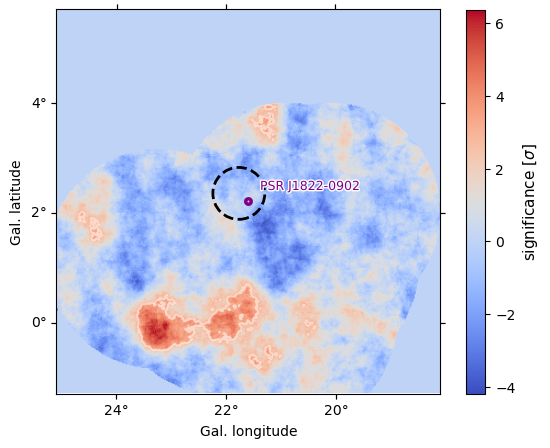

Position <SkyCoord (Galactic): (l, b) in deg
    (25.19499987, 0.17218088)> is outside valid IRF map range, using nearest IRF defined within
Position <SkyCoord (Galactic): (l, b) in deg
    (25.19499987, 0.17218088)> is outside valid IRF map range, using nearest IRF defined within
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Position <SkyCoord (Galactic): (l, b) in deg
    (12.27894567, -3.10619326)> is outside valid IRF map range, using nearest IRF defined within
Position <SkyCoord (Galactic): (l, b) in deg
    (12.27894567, -3.10619326)> is outside valid IRF map range, using nearest IRF defined within
Position <SkyCoord (Galactic): (l, b) in deg
    (12.30872755, -3.10619326)> is outside valid IRF map range, using nearest IRF defined within
Position <SkyCoord (Galactic): (l, b) in deg
    (12.30872755, -3.10619326)> is outside valid IRF map range, using nearest IRF defined within
Position <SkyCoord (Galactic): (l, b) in deg
    (12.27894567, -3.

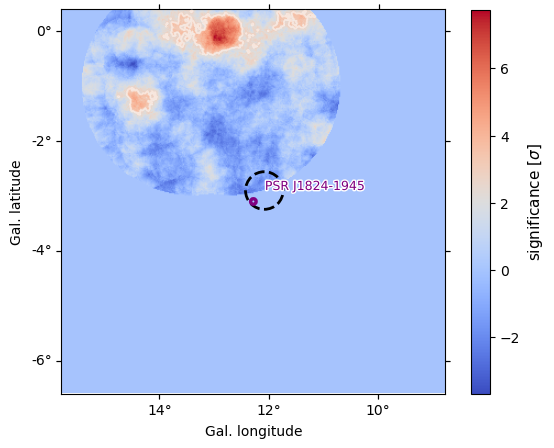

Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 23072
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 29363
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 29372
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 23072
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 29363
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 29372
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword a

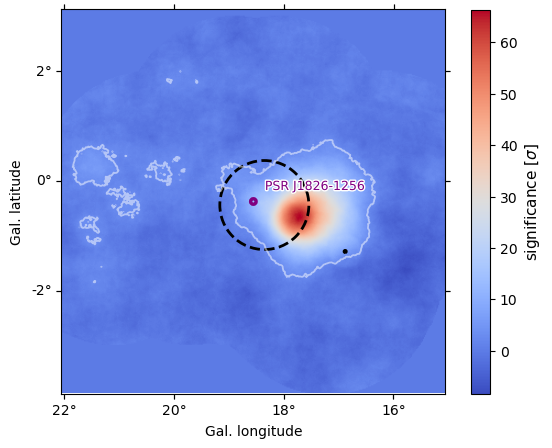

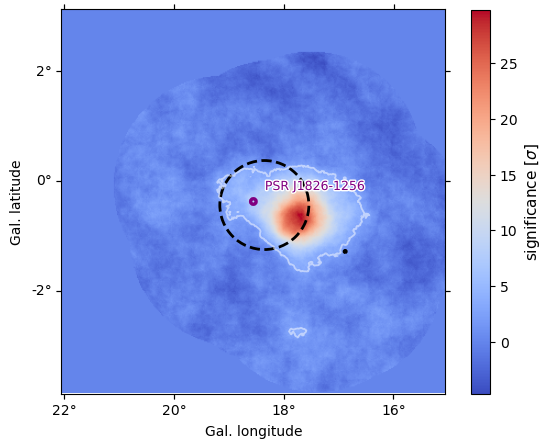

Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 23072
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 29363
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 29372
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 29385
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 23072
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 29363
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 29372
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 29385
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword

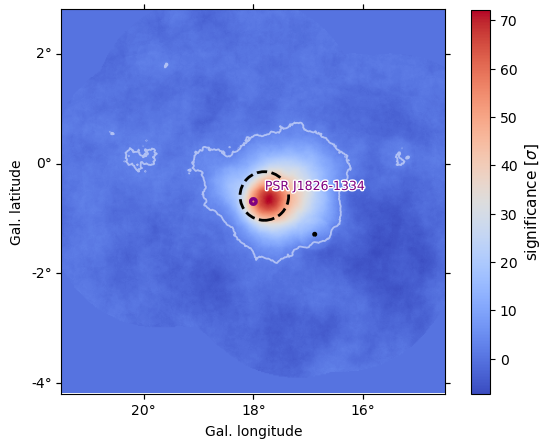

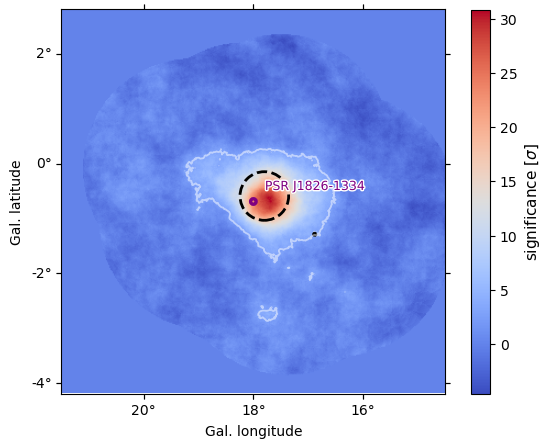

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

W VariableMetricBuilder No improvement in line search
W VariableMetricBuilder Machine accuracy limits further improvement
W MnPosDef Matrix forced pos-def by adding to diagonal 0.0485795
W VariableMetricBuilder Reached machine accuracy limit; Edm 0.00658592 is smaller than machine limit 0.0520774 while 0.0002 was requested
W VariableMetricBuilder No convergence; Edm 0.00658592 is above tolerance 0.002
W VariableMetricBuilder No improvement in line search
W VariableMetricBuilder Iterations finish without convergence; Edm 1.4864 Requested 0.0002
W VariableMetricBuilder No convergence; Edm 1.4864 is above tolerance 0.002
W VariableMetricBuilder No improvement in line search
W VariableMetricBuilder Iterations finish without convergence; Edm 1.71131 Requested 0.0002
W VariableMetricBuilder No convergence; Edm 1.71131 is above tolerance 0.002
W VariableMetricBuilder No improvement in line search
W VariableMetricBuilder Iterations finish without convergence; Edm 1269.49 Requested 0.0002
W MnP

Position <SkyCoord (Galactic): (l, b) in deg
    (16.88162208, -1.28853039)> is outside valid IRF map range, using nearest IRF defined within
Position <SkyCoord (Galactic): (l, b) in deg
    (16.88162208, -1.28853039)> is outside valid IRF map range, using nearest IRF defined within
Model {m.name} is outside the target geom but contributes inside through the psf.This contribution cannot be estimated precisely.Consider extending the dataset geom and/or the masked margin in the mask_fit.


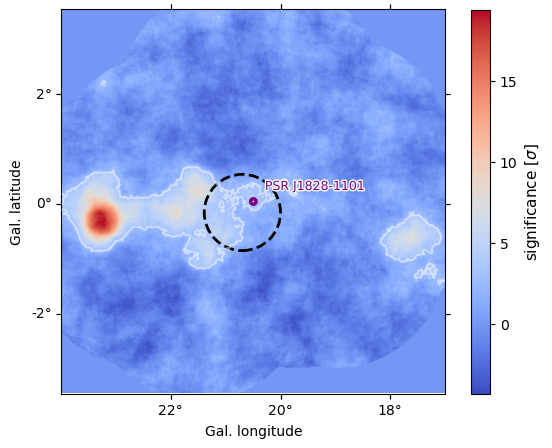

Position <SkyCoord (Galactic): (l, b) in deg
    (16.88162208, -1.28853039)> is outside valid IRF map range, using nearest IRF defined within
Position <SkyCoord (Galactic): (l, b) in deg
    (16.88162208, -1.28853039)> is outside valid IRF map range, using nearest IRF defined within
Model {m.name} is outside the target geom but contributes inside through the psf.This contribution cannot be estimated precisely.Consider extending the dataset geom and/or the masked margin in the mask_fit.


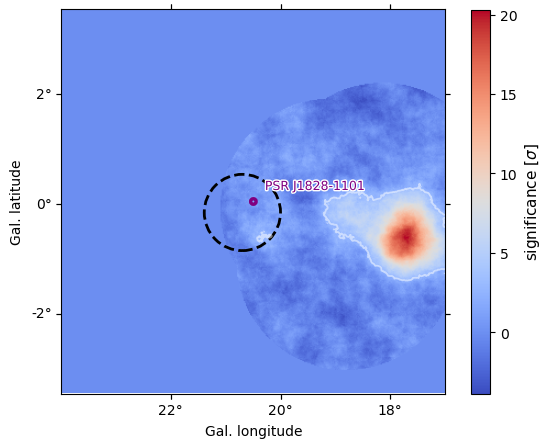

Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assumin

W VariableMetricBuilder No improvement in line search
W VariableMetricBuilder Iterations finish without convergence; Edm 413.184 Requested 0.0002
W MnPosDef non-positive diagonal element in covariance matrix[ 0 ] = -258560
W MnPosDef non-positive diagonal element in covariance matrix[ 1 ] = -2.69143e+06
W MnPosDef Added to diagonal of Error matrix a value 2.69143e+06
W MnPosDef Matrix forced pos-def by adding to diagonal 135.516


Position <SkyCoord (Galactic): (l, b) in deg
    (25.57052028, -0.44409705)> is outside valid IRF map range, using nearest IRF defined within
Position <SkyCoord (Galactic): (l, b) in deg
    (25.57052028, -0.44409705)> is outside valid IRF map range, using nearest IRF defined within
Model {m.name} is outside the target geom but contributes inside through the psf.This contribution cannot be estimated precisely.Consider extending the dataset geom and/or the masked margin in the mask_fit.
Position <SkyCoord (Galactic): (l, b) in deg
    (25.58685083, -0.0302055)> is outside valid IRF map range, using nearest IRF defined within
Position <SkyCoord (Galactic): (l, b) in deg
    (25.58685083, -0.0302055)> is outside valid IRF map range, using nearest IRF defined within
Model {m.name} is outside the target geom but contributes inside through the psf.This contribution cannot be estimated precisely.Consider extending the dataset geom and/or the masked margin in the mask_fit.


W DavidonErrorUpdator delgam < 0 : first derivatives increasing along search line
W VariableMetricBuilder Matrix not pos.def, gdel = 101329 > 0
W MnPosDef non-positive diagonal element in covariance matrix[ 1 ] = -34.0991
W MnPosDef non-positive diagonal element in covariance matrix[ 2 ] = -1.67089e-06
W MnPosDef non-positive diagonal element in covariance matrix[ 3 ] = -1.16808e-06
W MnPosDef non-positive diagonal element in covariance matrix[ 4 ] = -1.28478e-08
W MnPosDef Added to diagonal of Error matrix a value 34.5991
W VariableMetricBuilder gdel = -3.06753e+07


/home/wecapstor1/caph/mppi103h/software/miniforge3/envs/gammapy-1.20/lib/python3.10/site-packages/astropy/units/quantity.py:671: RuntimeWarning: overflow encountered in power
  result = super().__array_ufunc__(function, method, *arrays, **kwargs)
/home/wecapstor1/caph/mppi103h/software/miniforge3/envs/gammapy-1.20/lib/python3.10/site-packages/astropy/units/quantity.py:671: RuntimeWarning: overflow encountered in power
  result = super().__array_ufunc__(function, method, *arrays, **kwargs)
/home/wecapstor1/caph/mppi103h/software/miniforge3/envs/gammapy-1.20/lib/python3.10/site-packages/astropy/units/quantity.py:671: RuntimeWarning: overflow encountered in power
  result = super().__array_ufunc__(function, method, *arrays, **kwargs)
/home/wecapstor1/caph/mppi103h/software/miniforge3/envs/gammapy-1.20/lib/python3.10/site-packages/astropy/units/quantity.py:671: RuntimeWarning: overflow encountered in power
  result = super().__array_ufunc__(function, method, *arrays, **kwargs)
/home/wecaps

W VariableMetricBuilder No improvement in line search
W VariableMetricBuilder Iterations finish without convergence; Edm 62495.4 Requested 0.0002
W VariableMetricBuilder FunctionMinimum is invalid after second try
W VariableMetricBuilder Reached machine accuracy limit; Edm 0.00192869 is smaller than machine limit 0.0464415 while 0.0002 was requested


Position <SkyCoord (Galactic): (l, b) in deg
    (25.42827714, -0.20658779)> is outside valid IRF map range, using nearest IRF defined within
Position <SkyCoord (Galactic): (l, b) in deg
    (25.42827714, -0.20658779)> is outside valid IRF map range, using nearest IRF defined within


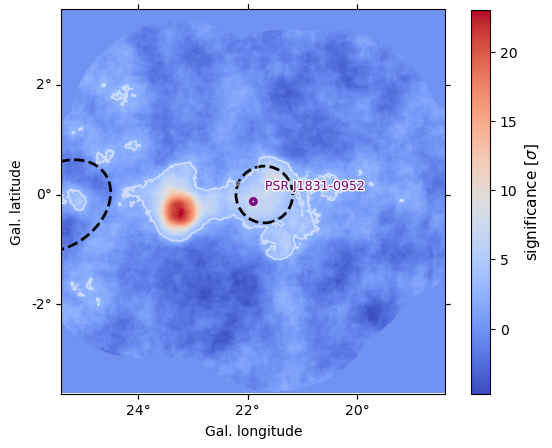

Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 23052
Skipping run with missing HDUs; Required HDUs ['bkg'] not found in observation 23052
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



In [203]:
for i in targets:
    
    # query runs from the database
    name = pd.DataFrame([pulsar_tree['JNAME'].iloc[i]], columns=['JNAME'])

    model_coord = SkyCoord(pulsar_tree['lon'].iloc[i]*u.degree, pulsar_tree['lat'].iloc[i]*u.degree, frame='galactic').icrs
    runlist = util.query_runs(TargetRA=model_coord.ra.value, TargetDec=model_coord.dec.value, Radius=2, TelPattern='fits')
    quality_selection_hess1 = util.quality_selection(runlist=runlist, HessEra='HESS1', Config='stereo', FitsEra='HESS1', AnalysisType='detection')
    runlist_filtered_hess1 = quality_selection_hess1.quality_cuts(requireCT5=False, logBadRuns=False, off_run_sel=True)
    quality_selection_hess2 = util.quality_selection(runlist=runlist, HessEra='HESS2', Config='stereo', FitsEra='HESS2', AnalysisType='detection')
    runlist_filtered_hess2 = quality_selection_hess2.quality_cuts(requireCT5=False, logBadRuns=False, off_run_sel=True)
    quality_selection_hess1u = util.quality_selection(runlist=runlist, HessEra='HESS2', Config='stereo', FitsEra='HESS1u', AnalysisType='detection')
    runlist_filtered_hess1u = quality_selection_hess1u.quality_cuts(requireCT5=False, logBadRuns=False, off_run_sel=True)

    # create datasets for each Telescope phase
    if runlist_filtered_hess1 != []:
        basedir = '/home/wecapstor1/caph/shared/hess/fits/fits_data/prod05/hess1/std_ImPACT_fullEnclosure_updated'
        ds = DataStore.from_dir(basedir, 'hdu-index.fits.gz', 'obs-index.fits.gz')
        runlist_filtered_hess1 = remove_prob_runs(runlist_filtered_hess1, ds)
        obs_list = ds.get_observations(runlist_filtered_hess1) 
        hess1 = standard_dataset(obs_list, pulsar_tree['lon'].iloc[i], pulsar_tree['lat'].iloc[i], 2*u.deg)
    
    if runlist_filtered_hess2 != []:
        basedir = '/home/wecapstor1/caph/shared/hess/fits/fits_data/prod05/hess2/std_ImPACT_fullEnclosure_updated'
        ds = DataStore.from_dir(basedir, 'hdu-index.fits.gz', 'obs-index.fits.gz')
        runlist_filtered_hess2 = remove_prob_runs(runlist_filtered_hess2, ds)
        obs_list = ds.get_observations(runlist_filtered_hess2) 
        hess2 = standard_dataset(obs_list, pulsar_tree['lon'].iloc[i], pulsar_tree['lat'].iloc[i], 2*u.deg)
    
    if runlist_filtered_hess1u != []:
        basedir = '/home/wecapstor1/caph/shared/hess/fits/fits_data/prod05/hess1u/std_ImPACT_fullEnclosure_updated'
        ds1u = DataStore.from_dir(basedir, 'hdu-index.fits.gz', 'obs-index.fits.gz')
        runlist_filtered_hess1u = remove_prob_runs(runlist_filtered_hess1u, ds1u)
        obs_list = ds1u.get_observations(runlist_filtered_hess1u) 
        hess1u = standard_dataset(obs_list, pulsar_tree['lon'].iloc[i], pulsar_tree['lat'].iloc[i], 2*u.deg)

    #Join the datasets and add the source model:
    datasets = Datasets()

    spatial_model_01 = GaussianSpatialModel(
    lon_0=pulsar_tree['lon'].iloc[i]*u.deg,
    lat_0=pulsar_tree['lat'].iloc[i]*u.deg,
    sigma = 0.3*u.deg,
    frame="galactic")

    spectral_model_01 = PowerLawSpectralModel(
        index=2.3,
        amplitude=2e-12 * u.Unit("1 / (cm2 s TeV)"),
        reference= 1.0 * u.TeV,)
    
    
    sky_model_01 = SkyModel(spatial_model=spatial_model_01, 
                                   spectral_model=spectral_model_01, name='gauss')
    
    sky_model_01.parameters['amplitude'].min = 0
    sky_model_01.parameters['index'].min = 0
    sky_model_01.parameters['amplitude'].frozen = False
    # sky_model_01.parameters['lat_0'].frozen = True
    sky_model_01.parameters['lon_0'].min = pulsar_tree['lon'].iloc[i]-0.2
    sky_model_01.parameters['lon_0'].max = pulsar_tree['lon'].iloc[i]+0.2
    sky_model_01.parameters['lat_0'].min = pulsar_tree['lat'].iloc[i]-0.2
    sky_model_01.parameters['lat_0'].max = pulsar_tree['lat'].iloc[i]+0.2
    sky_model_01.parameters['sigma'].max = 1

    HGPS_models = find_HGPS(i)
    bkg_model = FoVBackgroundModel(dataset_name='HESS')
    bkg_model.parameters['tilt'].frozen = False

    if runlist_filtered_hess1 != []:
        models_hess1 = HGPS_models.copy()
        hess1.models = models_hess1
        hess1_model = hess1.copy()
        modelsfit1 = models_hess1
        modelsfit1.append(bkg_model)
        modelsfit1.append(sky_model_01)
        hess1_model.models = modelsfit1
        datasets.append(hess1_model)
        
    if runlist_filtered_hess2 != []:
        models_hess2 = HGPS_models.copy()
        hess2.models = models_hess2
        hess2_model = hess2.copy()
        modelsfit2 = models_hess2
        modelsfit2.append(bkg_model)
        modelsfit2.append(sky_model_01)
        hess2_model.models = modelsfit2
        datasets.append(hess2_model)
        
    if runlist_filtered_hess1u != []:
        models_hess1u = HGPS_models.copy()
        hess1u.models = models_hess1u
        hess1u_model = hess1u.copy()
        modelsfit1u = models_hess1u
        modelsfit1u.append(bkg_model)
        modelsfit1u.append(sky_model_01)
        hess1u_model.models = modelsfit1u
        datasets.append(hess1u_model)

    # Fit the source model to the joint dataset
    if datasets.names != []:
        fit_01 = Fit(backend='minuit', optimize_opts={"print_level": 1})
        results_01 =fit_01.run(datasets)
        suc = pd.DataFrame([results_01.success], columns=['fit_sucess'])
        extension = pd.DataFrame([sky_model_01.parameters['sigma'].value], columns=['sigma_g'])
        extension_err = pd.DataFrame([sky_model_01.parameters['sigma'].error], columns=['sigma_g_err'])
    
        if runlist_filtered_hess1 != []:
            plot_results(hess1, hess1_model, i, pulsar_tree['JNAME'].iloc[i], 'hess1')
        if runlist_filtered_hess1u != []:
            plot_results(hess1u, hess1u_model, i, pulsar_tree['JNAME'].iloc[i], 'hess1u')
        if runlist_filtered_hess2 != []:
            plot_results(hess2, hess2_model, i, pulsar_tree['JNAME'].iloc[i], 'hess2')
            

        # Calculate the distance between the pulsar and the optimized gamma source position
        if not np.isnan(pulsar_tree['DIST [kpc]'].iloc[i]):
            d = pulsar_tree['DIST [kpc]'].iloc[i]
        else:
            d = 1

        dist, dist_err = source_dist(d, pulsar_tree['lon'].iloc[i], pulsar_tree['lat'].iloc[i],
                sky_model_01.parameters['lon_0'].value, sky_model_01.parameters['lat_0'].value,
                sky_model_01.parameters['lon_0'].error, sky_model_01.parameters['lat_0'].error)
    
        #calculate the signifiance of the source
        distance = pd.DataFrame([dist], columns=['model_pulsar_distance [pc]'])
        distance_err = pd.DataFrame([dist_err], columns=['model_pulsar_distance_err'])
        TS_before = []
        TS_after = []
        if runlist_filtered_hess1 != []:
            TS_hess1 = hess1.stat_sum()
            TS_hess1_model = hess1_model.stat_sum()
            TS_before.append(TS_hess1)
            TS_after.append(TS_hess1_model)
        if runlist_filtered_hess2 != []:
            TS_hess2 = hess2.stat_sum()
            TS_hess2_model = hess2_model.stat_sum()
            TS_before.append(TS_hess2)
            TS_after.append(TS_hess2_model)
        if runlist_filtered_hess1u != []:
            TS_hess1u = hess1u.stat_sum()
            TS_hess1u_model = hess1u_model.stat_sum()
            TS_before.append(TS_hess1u)
            TS_after.append(TS_hess1u_model)
    
    
        S0 = np.sum(TS_before)
        S1 = np.sum(TS_after)
        ts = S0 - S1
        p_value = chi2.sf(ts, df=5)
        if p_value == 0 or p_value < np.finfo(float).eps:  # Smallest representable float
            sigma = pd.DataFrame([np.sqrt(ts)], columns=['significance'])
        else:
            sigma = pd.DataFrame([norm.isf(0.5 * p_value)], columns=['significance'])

        # caluclate flux, luminosity and surface brightness
        flux = pd.DataFrame([sky_model_01.parameters['amplitude'].value], columns=['flux [1/TeV s cm2]'])
        index = pd.DataFrame([sky_model_01.parameters['index'].value], columns=['index'])
        flux_err = pd.DataFrame([sky_model_01.parameters['amplitude'].error], columns=['flux_err'])
        index_err = pd.DataFrame([sky_model_01.parameters['index'].error], columns=['index_err'])
        if norm.isf(0.5 * p_value) >= 3:
            int_flux = pd.DataFrame([spectral_model_01.integral(1*u.TeV, 100*u.TeV).value], columns=['integrated_flux [1/s cm2]'])
            upper_lim = pd.DataFrame([False], columns=['ul'])
    
        if norm.isf(0.5 * p_value) < 3:
            energy_edges = MapAxis.from_edges([1,100], unit='TeV', name='energy', interp='log').edges
            fpe_002 = FluxPointsEstimator(energy_edges=energy_edges, source='gauss', selection_optional = 'all', n_sigma_ul=0.1)
            if runlist_filtered_hess1 != []:
                flux_points_002 = fpe_002.run(datasets=[hess1_model])
            elif runlist_filtered_hess1u != []:
                flux_points_002 = fpe_002.run(datasets=[hess1u_model])
            else:
                flux_points_002 = fpe_002.run(datasets=[hess2_model])
                
            integrated = flux_points_002.flux_ref + flux_points_002.flux_ul.data*flux_points_002.flux_ref
            int_flux = pd.DataFrame([integrated.value[0][0][0]], columns=['integrated_flux [1/s cm2]'])
            upper_lim = pd.DataFrame([True], columns=['ul'])

        ind = sky_model_01.parameters['index'].value
        ind_err_lum = sky_model_01.parameters['index'].error
        int_flux_lum = spectral_model_01.integral_error(1*u.TeV, 100*u.TeV)
        lum = 1.92*10**(44)* int_flux_lum[0].value *((ind - 1)/(ind - 2))*(1 - 10**(2 - ind))*(d)**2
        lum_err = np.sqrt((int_flux_lum[1].value)**2 + ((1/((ind - 1)*(ind - 2)) + np.log(10)/(1-10**(ind - 2)))*ind_err_lum)**2)
        luminosity = pd.DataFrame([lum], columns=['luminosity [erg/s]'])
        luminosity_err = pd.DataFrame([lum_err], columns=['luminosity_err'])

        R_pwn = d *1e3 * np.deg2rad(sky_model_01.parameters['sigma'].value)
        R_pwn_err = d *1e3 * np.deg2rad(sky_model_01.parameters['sigma'].error)
        surface_brightness = lum/(4*np.pi*R_pwn**2)
        surface_brightness_error = np.sqrt((lum_err/(4*np.pi*R_pwn**2))**2 + (R_pwn_err/(2*np.pi*R_pwn**3))**2)
        surface = pd.DataFrame([surface_brightness], columns=['surface_bringhtness [erg/s/pc2]'])
        surface_err = pd.DataFrame([surface_brightness_error], columns=['surface_brightness_err'])
        

    else:
        extension = pd.DataFrame([0], columns=['sigma_g'])
        sigma = pd.DataFrame([0], columns=['significance'])
        distance = pd.DataFrame([0], columns=['model_pulsar_distance [pc]'])
        index = pd.DataFrame([0], columns=['index'])
        flux = pd.DataFrame([0], columns=['flux [1/TeV s cm2]'])
        int_flux = pd.DataFrame([0], columns=['integrated_flux [1/s cm2]'])
        upper_lim = pd.DataFrame([0], columns=['ul'])
        luminosity = pd.DataFrame([0], columns=['luminosity [erg/s]'])
        surface = pd.DataFrame([0], columns=['surface_bringhtness [erg/s/pc2]'])
        

    new_df = pd.merge(name, suc, left_index=True, right_index=True)
    new_df = pd.merge(new_df, extension, left_index=True, right_index=True)
    new_df = pd.merge(new_df, sigma, left_index=True, right_index=True)
    new_df = pd.merge(new_df, distance, left_index=True, right_index=True)
    new_df = pd.merge(new_df, index, left_index=True, right_index=True)
    new_df = pd.merge(new_df, flux, left_index=True, right_index=True)
    new_df = pd.merge(new_df, int_flux, left_index=True, right_index=True)
    new_df = pd.merge(new_df, upper_lim, left_index=True, right_index=True)
    new_df = pd.merge(new_df, luminosity, left_index=True, right_index=True)
    new_df = pd.merge(new_df, surface, left_index=True, right_index=True)
    new_df = pd.merge(new_df, extension_err, left_index=True, right_index=True)
    new_df = pd.merge(new_df, distance_err, left_index=True, right_index=True)
    new_df = pd.merge(new_df, index_err, left_index=True, right_index=True)
    new_df = pd.merge(new_df, flux_err, left_index=True, right_index=True)
    new_df = pd.merge(new_df, luminosity_err, left_index=True, right_index=True)
    new_df = pd.merge(new_df, surface_err, left_index=True, right_index=True)


    df = pd.concat([df, new_df], ignore_index=True)

In [205]:
df.to_csv('detection_significance_fitted_all_galactic_HGPS.csv', sep='\t')

In [206]:
full_tree = pd.read_csv('data_pulsartree_TeVPWNe_Branch_obstime_gal.csv', sep='\t')

In [207]:
df_out = pd.merge(full_tree, df, how='left', left_on='JNAME', right_on='JNAME')

In [208]:
df_out.to_csv('data_pulsartree_TeVPWNe_Branch_obstime_detection_fitted_all_gal_HGPS.csv', sep='\t', header=True)

[]

In [191]:
from gammapy.modeling.models import Models
model_list = Models.read('/home/wecapstor1/caph/mppi103h/pulsar_tree/pulsar_legacy_proposal/seedlist_fitted_step3.yaml')
models_asso = Table.read('/home/wecapstor1/caph/mppi103h/pulsar_tree/pulsar_legacy_proposal/2hgps_prelinimary_v0.fits', format='fits')

def find_HGPS(i):
    models_FOV = []
    for j in range(len(model_list)):
        model_name = model_list[j].name
        
        # Determine the association for the model
        association = None
        for k in range(len(models_asso)):
            if models_asso[k]['Name'] == model_name:
                association = models_asso[k]['Asso_class']
        
        # Convert longitude if necessary
        if model_list[j].spatial_model.parameters['lon_0'].value < 0:
            lon = 360 + model_list[j].spatial_model.parameters['lon_0'].value
        else:
            lon = model_list[j].spatial_model.parameters['lon_0'].value
        
        lat = model_list[j].spatial_model.parameters['lat_0'].value

        # Check if model is within the field of view
        if (pulsar_tree['lon'].iloc[i] - 4 < lon < pulsar_tree['lon'].iloc[i] + 4 and
            pulsar_tree['lat'].iloc[i] - 4 < lat < pulsar_tree['lat'].iloc[i] + 4):
            
            # Check if model belongs to a valid association class
            if association in ['bin', 'snr', 'BIN', 'sfr', 'snr,mc', 'unid,snr,mc', 'unid,gc', 'isnr', 'hbl']:
                
                # Check for NaN parameters in the model
                if not any(np.isnan(param.value) for param in model_list[j].parameters):
                    models_FOV.append(model_list[j])
                else:
                    print(f"Model '{model_list[j].name}' skipped due to NaN in parameters.")
    
    return models_FOV

            JNAME
0  PSR J1803-2149


Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'
Missing 'HDUCLAS2' keyword assuming 'BKG'


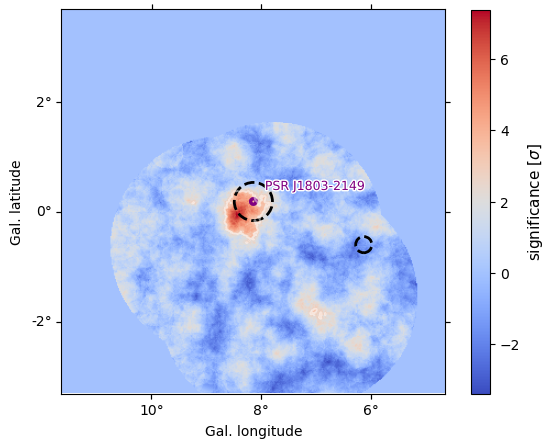

8.429186351508259


In [214]:
for i in targets[90:91]:
    # query runs
    name = pd.DataFrame([pulsar_tree['JNAME'].iloc[i]], columns=['JNAME'])
    print(name)
    model_coord = SkyCoord(pulsar_tree['lon'].iloc[i]*u.degree, pulsar_tree['lat'].iloc[i]*u.degree, frame='galactic').icrs
    runlist = util.query_runs(TargetRA=model_coord.ra.value, TargetDec=model_coord.dec.value, Radius=2, TelPattern='fits')
    quality_selection_hess1 = util.quality_selection(runlist=runlist, HessEra='HESS1', Config='stereo', FitsEra='HESS1', AnalysisType='detection')
    runlist_filtered_hess1 = quality_selection_hess1.quality_cuts(requireCT5=False, logBadRuns=False, off_run_sel=True)
    quality_selection_hess2 = util.quality_selection(runlist=runlist, HessEra='HESS2', Config='stereo', FitsEra='HESS2', AnalysisType='detection')
    runlist_filtered_hess2 = quality_selection_hess2.quality_cuts(requireCT5=False, logBadRuns=False, off_run_sel=True)
    quality_selection_hess1u = util.quality_selection(runlist=runlist, HessEra='HESS2', Config='stereo', FitsEra='HESS1u', AnalysisType='detection')
    runlist_filtered_hess1u = quality_selection_hess1u.quality_cuts(requireCT5=False, logBadRuns=False, off_run_sel=True)


    if runlist_filtered_hess2 != []:
        basedir = '/home/wecapstor1/caph/shared/hess/fits/fits_data/prod05/hess2/std_ImPACT_fullEnclosure_updated'
        ds = DataStore.from_dir(basedir, 'hdu-index.fits.gz', 'obs-index.fits.gz')
        runlist_filtered_hess2 = remove_prob_runs(runlist_filtered_hess2, ds)
        obs_list = ds.get_observations(runlist_filtered_hess2) 
        hess1 = standard_dataset(obs_list, pulsar_tree['lon'].iloc[i], pulsar_tree['lat'].iloc[i], 2*u.deg)

    hess1 = standard_dataset(obs_list, pulsar_tree['lon'].iloc[i], pulsar_tree['lat'].iloc[i], 2*u.deg)

    #Dataset creation:
    datasets = Datasets()

    spatial_model_01 = GaussianSpatialModel(
    lon_0=pulsar_tree['lon'].iloc[i]*u.deg,
    lat_0=pulsar_tree['lat'].iloc[i]*u.deg,
    sigma = 0.3*u.deg,
    frame="galactic")

    spectral_model_01 = PowerLawSpectralModel(
        index=2.3,
        amplitude=2e-12 * u.Unit("1 / (cm2 s TeV)"),
        reference= 1.0 * u.TeV,)
    
    
    sky_model_01 = SkyModel(spatial_model=spatial_model_01, 
                                   spectral_model=spectral_model_01, name='gauss')
    
    sky_model_01.parameters['amplitude'].min = 0
    sky_model_01.parameters['index'].min = 0
    sky_model_01.parameters['amplitude'].frozen = False
    sky_model_01.parameters['lat_0'].frozen = True
    sky_model_01.parameters['lon_0'].frozen = True
    # sky_model_01.parameters['lon_0'].min = pulsar_tree['lon'].iloc[i]-0.3
    # sky_model_01.parameters['lon_0'].max = pulsar_tree['lon'].iloc[i]+0.3
    # sky_model_01.parameters['lat_0'].min = pulsar_tree['lat'].iloc[i]-0.3
    # sky_model_01.parameters['lat_0'].max = pulsar_tree['lat'].iloc[i]+0.3
    sky_model_01.parameters['sigma'].max = 1

    HGPS_models = find_HGPS(i)
    bkg_model = FoVBackgroundModel(dataset_name='HESS')
    bkg_model.parameters['tilt'].frozen = False

    if runlist_filtered_hess1 != []:
        models_hess1 = HGPS_models.copy()
        hess1.models = models_hess1
        for a in range(0,len(models_hess1)):
            models_hess1[a].parameters['amplitude'].frozen = False
        hess1_model = hess1.copy()
        modelsfit1 = models_hess1
        modelsfit1.append(bkg_model)
        modelsfit1.append(sky_model_01)
        hess1_model.models = modelsfit1
        datasets.append(hess1_model)
        


    if datasets.names != []:
        fit_01 = Fit(backend='minuit', optimize_opts={"print_level": 1})
        results_01 =fit_01.run(datasets)
        suc = pd.DataFrame([results_01.success], columns=['fit_sucess'])
        extension = pd.DataFrame([sky_model_01.parameters['sigma'].value], columns=['sigma_g'])
        extension_err = pd.DataFrame([sky_model_01.parameters['sigma'].error], columns=['sigma_g_err'])
    
        if runlist_filtered_hess1 != []:
            plot_results(hess1, hess1_model, i, pulsar_tree['JNAME'].iloc[i], 'hess1')
            

        TS_hess1 = hess1.stat_sum()
        TS_hess1_model = hess1_model.stat_sum()
        TS_before.append(TS_hess1)
        TS_after.append(TS_hess1_model)

    
    
        S0 = np.sum(TS_before)
        S1 = np.sum(TS_after)
        ts = S0 - S1
        p_value = chi2.sf(ts, df=5)
        print(norm.isf(0.5 * p_value))

In [215]:
results_01.parameters.to_table().show_in_notebook()

idx,type,name,value,unit,error,min,max,frozen,is_norm,link,prior
0,,amplitude,2.4304e-16,TeV-1 s-1 cm-2,1.538e-16,2.430e-16,2.430e-10,False,True,,
1,,reference,1.0000e+00,TeV,0.000e+00,nan,nan,True,False,,
2,,alpha,3.0478e+00,,0.000e+00,0.000e+00,5.000e+00,True,False,,
3,,beta,0.0000e+00,,0.000e+00,0.000e+00,1.000e+00,True,False,,
4,,lon_0,6.1304e+00,deg,0.000e+00,5.965e+00,6.265e+00,True,False,,
5,,lat_0,-5.9803e-01,deg,0.000e+00,-7.200e-01,-4.200e-01,True,False,,
6,,r_0,1.4725e-01,deg,0.000e+00,3.000e-02,5.625e-01,True,False,,
7,,eta,1.0000e-01,,0.000e+00,1.000e-01,1.000e+00,True,False,,
8,,e,0.0000e+00,,0.000e+00,0.000e+00,9.500e-01,True,False,,
9,,phi,0.0000e+00,deg,0.000e+00,nan,nan,True,False,,


In [225]:
hess1.write('test_dataset', overwrite=True)

In [226]:
hess1 = MapDataset.read('test_dataset', name='B1055-onoff')

In [227]:
estimator_02_before_fit = ExcessMapEstimator(
    correlation_radius="0.3 deg",
    # energy_edges = [5, 100]*u.TeV,
    selection_optional=[],)

lima_maps_02 = estimator_02_before_fit.run(hess1)

<WCSAxes: >

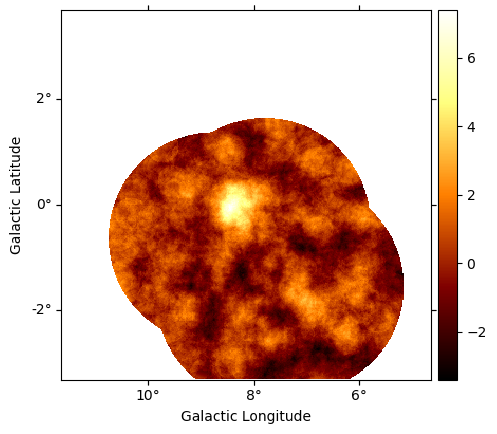

In [228]:
lima_maps_02["sqrt_ts"].plot(add_cbar=True)

In [229]:
spatial_model_01 = GaussianSpatialModel(
lon_0=pulsar_tree['lon'].iloc[i]*u.deg,
lat_0=pulsar_tree['lat'].iloc[i]*u.deg,
sigma = 0.3*u.deg,
frame="galactic")

spectral_model_01 = PowerLawSpectralModel(
    index=2.3,
    amplitude=2e-12 * u.Unit("1 / (cm2 s TeV)"),
    reference= 1.0 * u.TeV,)


sky_model_01 = SkyModel(spatial_model=spatial_model_01, 
                               spectral_model=spectral_model_01, name='gauss')

sky_model_01.parameters['amplitude'].min = 0
sky_model_01.parameters['index'].min = 0
sky_model_01.parameters['amplitude'].frozen = False
# sky_model_01.parameters['lat_0'].frozen = True
# sky_model_01.parameters['lon_0'].frozen = True
sky_model_01.parameters['lon_0'].min = pulsar_tree['lon'].iloc[i]-1
sky_model_01.parameters['lon_0'].max = pulsar_tree['lon'].iloc[i]+1
sky_model_01.parameters['lat_0'].min = pulsar_tree['lat'].iloc[i]-1
sky_model_01.parameters['lat_0'].max = pulsar_tree['lat'].iloc[i]+1
sky_model_01.parameters['sigma'].max = 1

HGPS_models = find_HGPS(i)
bkg_model = FoVBackgroundModel(dataset_name='HESS')
bkg_model.parameters['tilt'].frozen = False

if runlist_filtered_hess1 != []:
    models_hess1 = HGPS_models.copy()
    hess1.models = models_hess1
    hess1_model = hess1.copy()
    modelsfit1 = models_hess1
    modelsfit1.append(bkg_model)
    modelsfit1.append(sky_model_01)
    hess1_model.models = modelsfit1
    datasets.append(hess1_model)

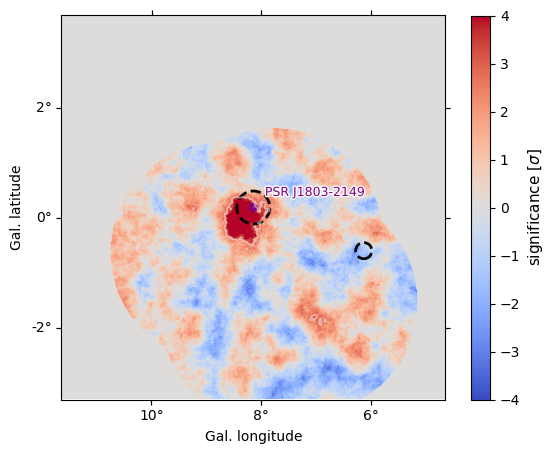

In [230]:
sigmap_010 = lima_maps_02["sqrt_ts"]
significance_map_off_010 = np.squeeze(sigmap_010.sum_over_axes().data, axis=(0,))
fig = plt.figure(dpi=100)
ax = fig.add_axes([0.1, 0.1, 0.8, 0.8], projection=sigmap_010.geom.wcs)
plt.rcParams.update({'font.size': 10})
plt.rcParams["font.weight"] = "normal"
plt.rcParams["axes.labelweight"] = "normal"

geom= sigmap_010.geom
plot = ax.imshow(significance_map_off_010, cmap='coolwarm',origin='lower',vmin=-4, vmax=4)

cbar = fig.colorbar(plot, ax=ax)
cbar.ax.set_ylabel(r'significance [$\sigma$]', rotation=90, fontsize=11)
cbar.ax.tick_params(labelsize=10)

levels = [3]
CS = ax.contour(np.squeeze(lima_maps_02["sqrt_ts"].sum_over_axes().data, axis=(0,)), levels, colors='white', alpha=0.5, linewidths=1.3)


for model in hess1_model.models:
    plot_model(model.spatial_model, lima_maps_02["sqrt_ts"].geom).plot( ax= ax, 
                linewidth=2, linestyle='--', edgecolor='black', facecolor='None')

reg = CircleSkyRegion(center=SkyCoord(pulsar_tree['lon'].iloc[i]*u.deg , 
                                     pulsar_tree['lat'].iloc[i]*u.deg, frame='galactic'), radius=0.03* u.deg).to_pixel(geom.to_image().wcs)
reg.plot(linewidth=4, edgecolor='purple')
txt = ax.text(185, 185, str(pulsar_tree['JNAME'].iloc[i]), color="purple", fontsize=9)
txt.set_path_effects([PathEffects.withStroke(linewidth=2, foreground='w')])

ax.set_ylabel('Gal. latitude')
ax.set_xlabel('Gal. longitude')

In [231]:
fit_01 = Fit(backend='minuit', optimize_opts={"print_level": 1})
results_01 =fit_01.run(hess1_model)

In [232]:
results_01.parameters.to_table().show_in_notebook()

idx,type,name,value,unit,error,min,max,frozen,is_norm,link,prior
0,,amplitude,2.4301e-16,TeV-1 s-1 cm-2,5.314e-18,2.430e-16,2.430e-10,False,True,,
1,,reference,1.0000e+00,TeV,0.000e+00,nan,nan,True,False,,
2,,alpha,3.0478e+00,,0.000e+00,0.000e+00,5.000e+00,True,False,,
3,,beta,0.0000e+00,,0.000e+00,0.000e+00,1.000e+00,True,False,,
4,,lon_0,6.1304e+00,deg,0.000e+00,5.965e+00,6.265e+00,True,False,,
5,,lat_0,-5.9803e-01,deg,0.000e+00,-7.200e-01,-4.200e-01,True,False,,
6,,r_0,1.4725e-01,deg,0.000e+00,3.000e-02,5.625e-01,True,False,,
7,,eta,1.0000e-01,,0.000e+00,1.000e-01,1.000e+00,True,False,,
8,,e,0.0000e+00,,0.000e+00,0.000e+00,9.500e-01,True,False,,
9,,phi,0.0000e+00,deg,0.000e+00,nan,nan,True,False,,


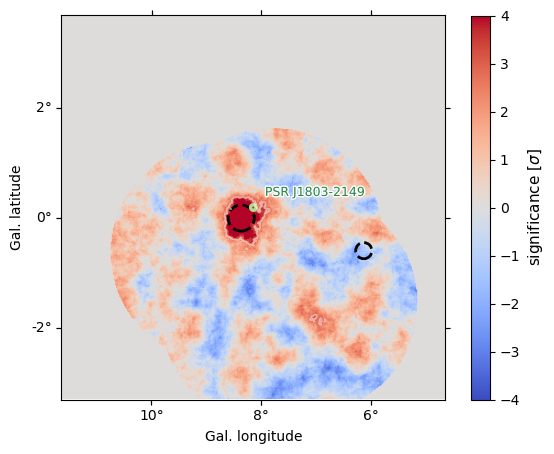

In [256]:
sigmap_010 = lima_maps_02["sqrt_ts"]
significance_map_off_010 = np.squeeze(sigmap_010.sum_over_axes().data, axis=(0,))
fig = plt.figure(dpi=100)
ax = fig.add_axes([0.1, 0.1, 0.8, 0.8], projection=sigmap_010.geom.wcs)
plt.rcParams.update({'font.size': 10})
plt.rcParams["font.weight"] = "normal"
plt.rcParams["axes.labelweight"] = "normal"

geom= sigmap_010.geom
plot = ax.imshow(significance_map_off_010, cmap='coolwarm',origin='lower',vmin=-4, vmax=4)

cbar = fig.colorbar(plot, ax=ax)
cbar.ax.set_ylabel(r'significance [$\sigma$]', rotation=90, fontsize=11)
cbar.ax.tick_params(labelsize=10)

levels = [3]
CS = ax.contour(np.squeeze(lima_maps_02["sqrt_ts"].sum_over_axes().data, axis=(0,)), levels, colors='white', alpha=0.5, linewidths=1.3)



plot_model(hess1_model.models[0].spatial_model, lima_maps_02["sqrt_ts"].geom).plot( ax= ax, 
                linewidth=2, linestyle='--', edgecolor='black', facecolor='None')
plot_model(hess1_model.models[1].spatial_model, lima_maps_02["sqrt_ts"].geom).plot( ax= ax, 
                linewidth=2, linestyle='--', edgecolor='black', facecolor='None')

reg = CircleSkyRegion(center=SkyCoord(pulsar_tree['lon'].iloc[i]*u.deg , 
                                     pulsar_tree['lat'].iloc[i]*u.deg, frame='galactic'), radius=0.03* u.deg).to_pixel(geom.to_image().wcs)
reg.plot(linewidth=4, edgecolor='#addd8e')
txt = ax.text(185, 185, str(pulsar_tree['JNAME'].iloc[i]), color="#238443", fontsize=9)
txt.set_path_effects([PathEffects.withStroke(linewidth=2, foreground='w')])

ax.set_ylabel('Gal. latitude')
ax.set_xlabel('Gal. longitude')
fig = plt.gcf()
save(fig, 'example')